
# Preprocessing


In [ ]:
# Basic Library Imports
import pandas as pd
import numpy as np
from pandas import read_csv
from matplotlib import pyplot
import matplotlib.pyplot as plt
from pandas import DataFrame

## JHU Data

In [ ]:
raw_us_deaths = read_csv('https://raw.githubusercontent.com/CSSEGISandData/COVID-19/master/csse_covid_19_data/csse_covid_19_time_series/time_series_covid19_deaths_US.csv')
raw_us_confirmed = read_csv('https://raw.githubusercontent.com/CSSEGISandData/COVID-19/master/csse_covid_19_data/csse_covid_19_time_series/time_series_covid19_confirmed_US.csv')

# Set up states dataframe
index = np.unique(raw_us_confirmed['Province_State'].values)
indices = [11 + i for i in range(len(raw_us_confirmed.columns) - 11)]
columns = list(raw_us_confirmed.columns[indices])
states_confirmed, states_deaths = DataFrame(index = index, columns = columns), DataFrame(index = index, columns = columns)

# Fill in values
for i in states_confirmed.columns:
    for j in states_confirmed.index:
        # Confirmed data
        state = raw_us_confirmed[raw_us_confirmed['Province_State'] == j]
        states_confirmed.loc[j, i] = state.loc[:, i].sum()
        # Deaths data
        state = raw_us_deaths[raw_us_deaths['Province_State'] == j]
        states_deaths.loc[j, i] = state.loc[:, i].sum()

# US State Population
state_population = dict({x: None for x in states_confirmed.index})
for i in state_population.keys():
    state = raw_us_deaths[raw_us_deaths['Province_State'] == i]
    state_population[i] = state.loc[:, 'Population'].sum()

## US Hospital Data
Data Source: COVID Tracking Project
*   Cases & Deaths
*   Testing
*   Hospitalizations





In [ ]:
raw_us_hospital_data = read_csv('https://api.covidtracking.com/v1/us/daily.csv')
raw_state_hospital_data = read_csv('https://api.covidtracking.com/v1/states/daily.csv')

# Reorder data
# us_hospital = us_hospital_data.sort_index(ascending = False)

### US Data

In [ ]:
# Categorizing columns
all_columns = raw_us_hospital_data.columns
testing_columns = ['positive', 'negative', 'pending',
       'total', 'totalTestResults', 'posNeg',
       'negativeIncrease', 'positiveIncrease',
       'totalTestResultsIncrease']
hospital_columns = ['hospitalized', 'hospitalizedCurrently', 
                    'hospitalizedCumulative', 'inIcuCurrently',
                    'inIcuCumulative', 'onVentilatorCurrently', 
                    'onVentilatorCumulative', 'hospitalizedIncrease']
cases_columns = ['positive', 'recovered', 'death', 'deathIncrease']

In [ ]:
us_hospital_data = DataFrame(index = raw_us_hospital_data.columns, columns = columns)
for i in raw_us_hospital_data.index:
    x = raw_us_hospital_data.loc[i, :]
    y = str(x.date)
    if '0' == y[-2]:
        date = y[-3] + '/' + y[-1] + '/' + y[:2]
        
    else:
        date = y[-3] + '/' + y[-2:] + '/' + y[:2]

    for j in x.index:
        us_hospital_data.loc[j, date] = x[j]

### State Hospital Data

In [ ]:
state_abbrev_only = {
    'Alabama': 'AL',
    'Alaska': 'AK',
    # 'American Samoa': 'AS',
    'Arizona': 'AZ',
    'Arkansas': 'AR',
    'California': 'CA',
    'Colorado': 'CO',
    'Connecticut': 'CT',
    'Delaware': 'DE',
    # 'District of Columbia': 'DC',
    'Florida': 'FL',
    'Georgia': 'GA',
    # 'Guam': 'GU',
    'Hawaii': 'HI',
    'Idaho': 'ID',
    'Illinois': 'IL',
    'Indiana': 'IN',
    'Iowa': 'IA',
    'Kansas': 'KS',
    'Kentucky': 'KY',
    'Louisiana': 'LA',
    'Maine': 'ME',
    'Maryland': 'MD',
    'Massachusetts': 'MA',
    'Michigan': 'MI',
    'Minnesota': 'MN',
    'Mississippi': 'MS',
    'Missouri': 'MO',
    'Montana': 'MT',
    'Nebraska': 'NE',
    'Nevada': 'NV',
    'New Hampshire': 'NH',
    'New Jersey': 'NJ',
    'New Mexico': 'NM',
    'New York': 'NY',
    'North Carolina': 'NC',
    'North Dakota': 'ND',
    # 'Northern Mariana Islands':'MP',
    'Ohio': 'OH',
    'Oklahoma': 'OK',
    'Oregon': 'OR',
    'Pennsylvania': 'PA',
    # 'Puerto Rico': 'PR',
    'Rhode Island': 'RI',
    'South Carolina': 'SC',
    'South Dakota': 'SD',
    'Tennessee': 'TN',
    'Texas': 'TX',
    'Utah': 'UT',
    'Vermont': 'VT',
    # 'Virgin Islands': 'VI',
    'Virginia': 'VA',
    'Washington': 'WA',
    'West Virginia': 'WV',
    'Wisconsin': 'WI',
    'Wyoming': 'WY'
}

us_state_abbrev = {
    'Alabama': 'AL',
    'Alaska': 'AK',
    # 'American Samoa': 'AS',
    'Arizona': 'AZ',
    'Arkansas': 'AR',
    'California': 'CA',
    'Colorado': 'CO',
    'Connecticut': 'CT',
    'Delaware': 'DE',
    'District of Columbia': 'DC',
    'Florida': 'FL',
    'Georgia': 'GA',
    # 'Guam': 'GU',
    'Hawaii': 'HI',
    'Idaho': 'ID',
    'Illinois': 'IL',
    'Indiana': 'IN',
    'Iowa': 'IA',
    'Kansas': 'KS',
    'Kentucky': 'KY',
    'Louisiana': 'LA',
    'Maine': 'ME',
    'Maryland': 'MD',
    'Massachusetts': 'MA',
    'Michigan': 'MI',
    'Minnesota': 'MN',
    'Mississippi': 'MS',
    'Missouri': 'MO',
    'Montana': 'MT',
    'Nebraska': 'NE',
    'Nevada': 'NV',
    'New Hampshire': 'NH',
    'New Jersey': 'NJ',
    'New Mexico': 'NM',
    'New York': 'NY',
    'North Carolina': 'NC',
    'North Dakota': 'ND',
    # 'Northern Mariana Islands':'MP',
    'Ohio': 'OH',
    'Oklahoma': 'OK',
    'Oregon': 'OR',
    'Pennsylvania': 'PA',
    'Puerto Rico': 'PR',
    'Rhode Island': 'RI',
    'South Carolina': 'SC',
    'South Dakota': 'SD',
    'Tennessee': 'TN',
    'Texas': 'TX',
    'Utah': 'UT',
    'Vermont': 'VT',
    # 'Virgin Islands': 'VI',
    'Virginia': 'VA',
    'Washington': 'WA',
    'West Virginia': 'WV',
    'Wisconsin': 'WI',
    'Wyoming': 'WY'
}

In [ ]:
# Create dictionary for each hospital data column & corresponding dataframe
hospital_data = dict({x: None for x in raw_state_hospital_data.columns[2:]})
for i in raw_state_hospital_data.columns[2:]:
    # Create DataFrame for each column
    df = DataFrame(index = us_state_abbrev.keys(), columns = columns)
    
    for state in us_state_abbrev.keys():

        abbr = us_state_abbrev[state]
    # Create dataframe w/ all entries from state
        x = raw_state_hospital_data[raw_state_hospital_data['state'] == abbr]

        # Copy all values from original dataframe to state dataframe
        for j in x.index:
            y = str(x['date'][j])
            if '0' == y[-2]:
                date = y[-3] + '/' + y[-1] + '/' + y[:2]
                
            else:
                date = y[-3] + '/' + y[-2:] + '/' + y[:2]
        
            df.loc[state, date] = x.loc[j, i]

    # Assign dataframe as value for state in dictionary
    hospital_data[i] = df

# Create variable for index & column length
hospital_index = hospital_data['positive'].index
hospital_columns = hospital_data['positive'].columns

#### Fix States

In [ ]:
# Impute zeros in posIncr

def cutoff_code(df, dates, state):
    for i in dates:
        if df.loc[state, i] > 0:
            return i
    return dates[0]

states = hospital_data['positiveIncrease'].index
posIncr = hospital_data['positiveIncrease']
cutoff = [cutoff_code(posIncr, posIncr.columns, state) for state in states]
state_cutoff = {states[i]: cutoff[i] for i in range(len(cutoff))}

dates = posIncr.columns
# Create averaging code
def average_posIncr(posIncr, state, date_index, zero_len):
    if dates[date_index] == posIncr.columns[-1]:
        return posIncr
    elif posIncr.loc[state, dates[date_index]] == 0:
        return average_posIncr(posIncr, state, date_index + 1, zero_len + 1)
    else:
        if zero_len == 0:
            return average_posIncr(posIncr, state, date_index + 1, 0)
        else:
            print(dates[date_index], 'STOP')
            print('Value:', posIncr.loc[state, dates[date_index]])
            average = posIncr.loc[state, dates[date_index]] / (zero_len + 1)
            average = int(round(average, 0))
            for i in range(zero_len + 1):
                posIncr.loc[state, dates[date_index -  i]] = average
                print(dates[date_index - i], 'date')
            # print(posIncr.loc[state, dates[date_index - zero_len]: dates[date_index]])
            return average_posIncr(posIncr, state, date_index + 1, 0)     

for state in states:
    posIncr = average_posIncr(posIncr, state, 0, 0)

for state in states:
    print(state, 'diff:', abs(posIncr.loc[state, :].sum() - hospital_data['positiveIncrease'].loc[state, :].sum()))

3/13/20 STOP
Value: 1
3/13/20 date
3/12/20 date
3/11/20 date
3/10/20 date
3/9/20 date
3/8/20 date
3/7/20 date
3/13/20 STOP
Value: 1
3/13/20 date
3/12/20 date
3/11/20 date
3/10/20 date
3/9/20 date
3/8/20 date
3/7/20 date
3/6/20 date
3/17/20 STOP
Value: 2
3/17/20 date
3/16/20 date
3/15/20 date
3/14/20 date
3/20/20 STOP
Value: 6
3/20/20 date
3/19/20 date
3/24/20 STOP
Value: 14
3/24/20 date
3/23/20 date
4/26/20 STOP
Value: 2
4/26/20 date
4/25/20 date
5/1/20 STOP
Value: 9
5/1/20 date
4/30/20 date
5/14/20 STOP
Value: 4
5/14/20 date
5/13/20 date
5/20/20 STOP
Value: 3
5/20/20 date
5/19/20 date
5/22/20 STOP
Value: 2
5/22/20 date
5/21/20 date
5/25/20 STOP
Value: 1
5/25/20 date
5/24/20 date
6/1/20 STOP
Value: 33
6/1/20 date
5/31/20 date
7/7/20 STOP
Value: 46
7/7/20 date
7/6/20 date
9/25/20 STOP
Value: 261
9/25/20 date
9/24/20 date
3/6/20 STOP
Value: 1
3/6/20 date
3/5/20 date
3/4/20 date
3/10/20 STOP
Value: 1
3/10/20 date
3/9/20 date
3/8/20 date
3/14/20 STOP
Value: 3
3/14/20 date
3/13/20 date
3/12

# General Data Analysis

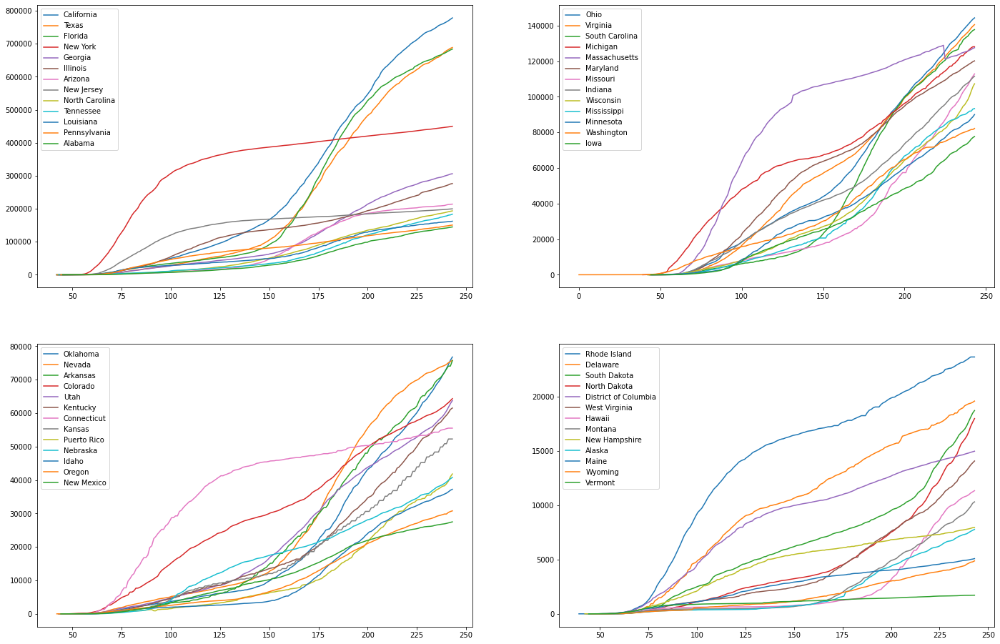

In [ ]:
data_type = 'positive'

states = hospital_data[data_type][hospital_data[data_type].columns[-1]].sort_values(ascending = False).index

t = np.linspace(0, len(hospital_data[data_type].columns), len(hospital_data[data_type].columns))

fig, axes = plt.subplots(2, 2, figsize = (24, 16))

counter = 0
for i in range(2):
    for k in range(2):
        for j in range(13):
            axes[i][k].plot(t, hospital_data[data_type].loc[states[j + counter], :], label = states[j + counter])
        counter += 13
        axes[i][k].legend()

['Arkansas',
 'Connecticut',
 'Kansas',
 'Louisiana',
 'Michigan',
 'Mississippi',
 'Oregon',
 'Rhode Island',
 'Vermont',
 'Washington']

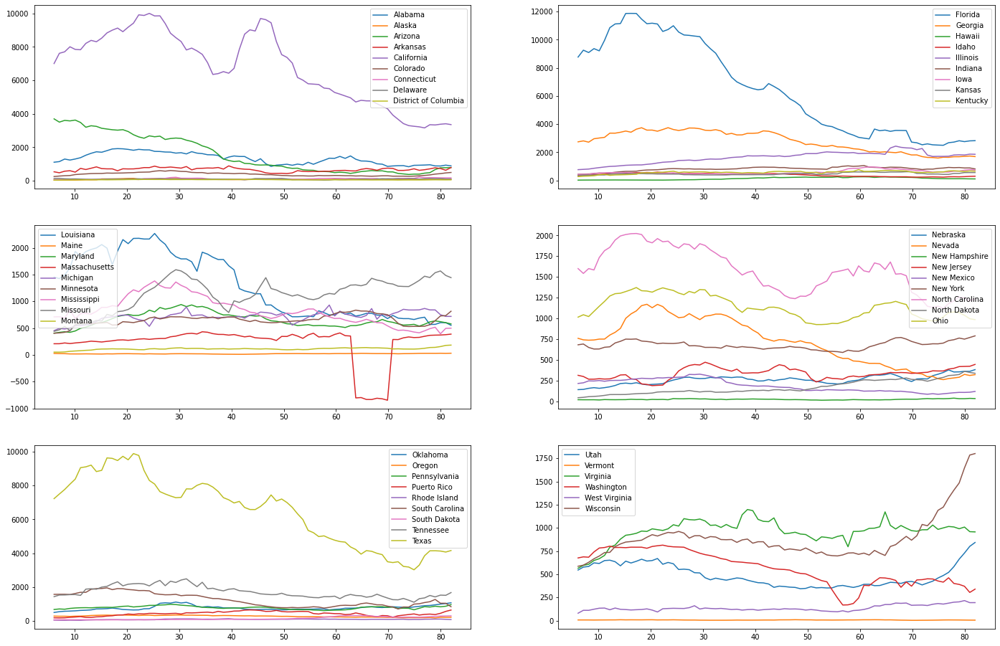

In [ ]:
data_type = 'positiveIncrease'

states = (hospital_data[data_type][hospital_data[data_type].columns[-14:]].rolling(window = 7, axis = 1).sum() / 7).sort_values(by = [hospital_data[data_type].columns[-1]], ascending = False).index
# states = states.drop('Puerto Rico')

t = np.linspace(0, len(hospital_data[data_type].columns[161:]), len(hospital_data[data_type].columns[161:]))

fig, axes = plt.subplots(3, 2, figsize = (24, 16))

counter = 0
for i in range(3):
    for k in range(2):
        for j in range(np.min([9, 51 - counter])):
            # print(j)
            axes[i][k].plot(t, hospital_data[data_type].loc[states[j + counter], '7/1/20':].rolling(window = 7).sum() / 7, label = states[j + counter])
        counter += 9
        axes[i][k].legend()

# Print States that have 0's in last week of posIncr
zeroes = hospital_data[data_type][hospital_data[data_type].columns[-7:]]

def find_zeroes(zeroes, index, states):
    if 0 in zeroes.iloc[index, :].values:
        states.append(zeroes.iloc[index, :].name)
    while index < 51:
        return find_zeroes(zeroes, index + 1, states)
    return states

states_zero = find_zeroes(zeroes, 0, [])
states_zero

## Cases & Pos. Rate Trends 

In [ ]:
# General
dates = [-126, -120, -119, -113, -112, -106, -105, -99, -98, 
         -92, -91, -85, -84, -78, -77, -71, -70, -64, -63, -57, -56, -50, 
         -49, -43, -42, -36, -35, -29, -28, -22, -21, -15, -14, -8, -7, -1]
dates = [hospital_data['positive'].columns[x] for x in dates]

states_list = [x for x in state_abbrev_only.keys()]

# Positive Cases 
state_df = DataFrame(columns = ["state", "value", "date", "hover_name"])
# state_df.state = [x for x in state_abbrev_only.values()]

counter = 0
for date_index in range(len(dates[2:]) // 2):
    for state in state_abbrev_only.keys():
        # JHU
        # current_wk = (states_confirmed.loc[state, '8/22/20'] - states_confirmed.loc[state,'8/15/20']) 
        # previous_wk = (states_confirmed.loc[state, '8/14/20'] - states_confirmed.loc[state, '8/7/20']) 

        # COVID Tracker Data
        current_wk = hospital_data['positiveIncrease'].loc[state, dates[date_index * 2 + 2]:dates[date_index * 2 + 3]].sum() / 7
        previous_wk = hospital_data['positiveIncrease'].loc[state, dates[date_index * 2]:dates[date_index * 2 + 1]].sum() / 7
        # print(state + ' PosIncr', current_wk, previous_wk)
        difference = (current_wk - previous_wk) / previous_wk * 100
        state_df.loc[counter, 'date'] = dates[date_index * 2 + 3]
        state_df.loc[counter, 'value'] = difference
        state_df.loc[counter, 'state'] = state_abbrev_only[state]
        state_df.loc[counter, 'hover_name'] = state
        counter += 1
  
state_df.sort_index(ascending = True)
# %Pos.
pos_df = DataFrame(columns = ["state", "value", "date", "hover_name"])
counter = 0
for date_index in range(len(dates[2:]) // 2):
    for state in state_abbrev_only.keys():
        # JHU
        # current_wk = (states_confirmed.loc[state, '8/22/20'] - states_confirmed.loc[state,'8/15/20']) 
        # previous_wk = (states_confirmed.loc[state, '8/14/20'] - states_confirmed.loc[state, '8/7/20']) 

        # COVID Tracker Data
        current_wk = (hospital_data['positiveIncrease'].loc[state, dates[date_index * 2 + 2]:dates[date_index * 2 + 3]].sum() / 7) / (hospital_data['totalTestResultsIncrease'].loc[state, dates[date_index * 2 + 2]:dates[date_index * 2 + 3]].sum() / 7)
        previous_wk = (hospital_data['positiveIncrease'].loc[state, dates[date_index * 2]:dates[date_index * 2 + 1]].sum() / 7) / (hospital_data['totalTestResultsIncrease'].loc[state, dates[date_index * 2]:dates[date_index * 2 + 1]].sum() / 7)
        # print(state + ' PosIncr', current_wk, previous_wk)
        difference = (current_wk - previous_wk) / previous_wk * 100
        pos_df.loc[counter, 'date'] = dates[date_index * 2 + 3]
        pos_df.loc[counter, 'value'] = difference
        pos_df.loc[counter, 'state'] = state_abbrev_only[state]
        pos_df.loc[counter, 'hover_name'] = state
        counter += 1

""" 

Useful Link
https://plotly.com/python/choropleth-maps/
"""

' \n\nUseful Link\nhttps://plotly.com/python/choropleth-maps/\n'

In [ ]:
# Create Dictionaries of State Trends
dates = [(1 + 7 * i) * -1 for i in range(10)]
dates = [hospital_data['positive'].columns[x] for x in dates]

reverse_dates = dates

# Daily Cases
case_trends = dict({x + -10: [] for x in range(20)})

def find_trend(state, counter, check): 
    df = state_df[state_df['hover_name'] == state]
    val = df[df['date'] == reverse_dates[counter]].value.values[0]
    if val > 0:
        return counter if check == -1 else find_trend(state, counter + 1, 1) 

    else:
        return counter * -1 if check == 1 else find_trend(state, counter + 1, -1)            
        
for state in states_list:
    case_trends[find_trend(state, 0, 0)].append(state)

# Pos. Rate
pos_rate_trends = dict({x + -10: [] for x in range(20)})

def find_pos_trend(state, counter, check): 
    df = pos_df[pos_df['hover_name'] == state]
    # print(counter)
    val = df[df['date'] == reverse_dates[counter]].value.values[0]
    if val > 0:
        return counter if check == -1 or counter >= 9 else find_pos_trend(state, counter + 1, 1) 

    else:
        return counter * -1 if check == 1 or counter >= 9 else find_pos_trend(state, counter + 1, -1)            
        
for state in states_list:
    pos_rate_trends[find_pos_trend(state, 0, 0)].append(state)

for num in list(case_trends.keys()):
    if case_trends[num] == []: del case_trends[num] 
    if pos_rate_trends[num] == []: del pos_rate_trends[num] 
        


### Graphs & Analysis

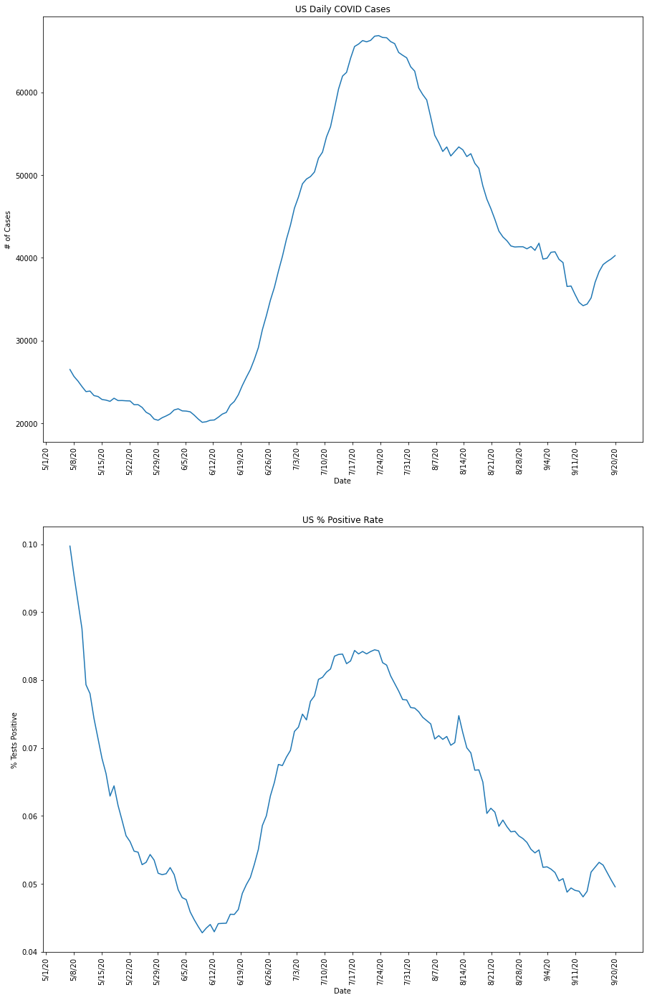

In [ ]:
# US Trends
fig = plt.figure(figsize = (15, 24))
dates = us_hospital_data.columns[100:]

ax = fig.add_subplot(211)
data = us_hospital_data.loc['positiveIncrease', '5/1/20':].rolling(window = 7).sum() / 7
t = np.linspace(0, len(data), len(data))
ax.plot(t, data)

tick_loc = [i * 7 for i in range(len(data) // 7)]
tick_loc.append(len(data))
labels = [dates[7 * i] for i in range(len(data) // 7)]
labels.append(dates[-1])

# Set xticks
ax.set_xticks(tick_loc)
ax.set_xticklabels(labels = labels, rotation = 90)

# Set title
ax.set_title('US Daily COVID Cases')
ax.set_ylabel('# of Cases')
ax.set_xlabel('Date')

# US Pos. Rate
ax = fig.add_subplot(212)
data = (us_hospital_data.loc['positiveIncrease', '5/1/20':].rolling(window = 7).sum() / 7) / (us_hospital_data.loc['totalTestResultsIncrease', '5/1/20':].rolling(window = 7).sum() / 7)
t = np.linspace(0, len(data), len(data))
ax.plot(t, data)

# Set xticks
ax.set_xticks(tick_loc)
ax.set_xticklabels(labels = labels, rotation = 90)

# Set title
ax.set_title('US % Positive Rate')
ax.set_ylabel('% Tests Positive')
ax.set_xlabel('Date')
fig.show()

In [ ]:
# State Heat Map
import plotly.express as px  # Be sure to import express
# Find max & min values 
max = 50
min = -50

fig = px.choropleth(state_df,  # Input Pandas DataFrame
                    locations="state",  # DataFrame column with locations
                    color="value",  # DataFrame column with color values
                    range_color = [min, max],
                    color_continuous_scale= 'bluered',
                    animation_frame = 'date',
                    labels = {'value': '% Change'},
                    color_continuous_midpoint = 0,
                    hover_name = "hover_name", # DataFrame column hover info
                    locationmode = 'USA-states') # Set to plot as US States
fig.update_layout(
    title_text = 'COVID Case Trends: This Week vs Last Week', # Create a Title
    geo_scope='usa',  # Plot only the USA instead of globe
)

# Controls animation speed
fig.layout.updatemenus[0].buttons[0].args[1]["frame"]["duration"] = 1000

fig.show()

max = 50
min = -50

fig2 = px.choropleth(pos_df,  # Input Pandas DataFrame
                    locations="state",  # DataFrame column with locations
                    color="value",  # DataFrame column with color values
                    range_color = [min, max],
                    color_continuous_scale= 'bluered' ,
                     animation_frame = 'date',
                    labels = {'value': '% Change'},
                    color_continuous_midpoint = 0,
                    hover_name = "hover_name", # DataFrame column hover info
                    locationmode = 'USA-states') # Set to plot as US States
fig2.update_layout(
    title_text = 'COVID Pos. Rate Trends: This Week vs Last Week', # Create a Title
    geo_scope='usa',  # Plot only the USA instead of globe
)

# Controls animation speed
fig2.layout.updatemenus[0].buttons[0].args[1]["frame"]["duration"] = 1000

fig2.show()  # Output the plot to the screen

In [ ]:
# Display Case & Pos. Rate Trends
import pprint
print("Case Trends")
print(pprint.pformat(case_trends) + "\n")
print("Pos. Rate Trends")
print(pprint.pformat(pos_rate_trends))



Case Trends
{-7: ['North Dakota'],
 -5: ['Arkansas', 'Oklahoma'],
 -4: ['Nebraska', 'New Hampshire', 'New Jersey', 'Utah', 'Wisconsin'],
 -2: ['Connecticut', 'Maine', 'Wyoming'],
 -1: ['Alaska',
      'Arizona',
      'California',
      'Colorado',
      'Florida',
      'Georgia',
      'Idaho',
      'Illinois',
      'Iowa',
      'Kansas',
      'Kentucky',
      'Maryland',
      'Massachusetts',
      'Minnesota',
      'Mississippi',
      'Missouri',
      'Montana',
      'Nevada',
      'New Mexico',
      'New York',
      'North Carolina',
      'Ohio',
      'Oregon',
      'Pennsylvania',
      'South Dakota',
      'Tennessee',
      'Texas',
      'West Virginia'],
 1: ['Delaware', 'Michigan', 'South Carolina', 'Vermont', 'Washington'],
 2: ['Virginia'],
 3: ['Alabama', 'Hawaii', 'Indiana', 'Louisiana'],
 4: ['Rhode Island']}

Pos. Rate Trends
{-6: ['Wisconsin'],
 -3: ['New Jersey', 'Pennsylvania'],
 -2: ['Connecticut', 'Oregon', 'Texas', 'Utah', 'Vermont'],
 -1: ['Col

# US State Trends

## State Policy

### State Model Code

In [ ]:
# Moving Average Graph

# Graph code
def state_graph(state, window, date_type, graph_type, data, cutoff_type, lag):
    """
    Arguments: state, window, date_type, graph_type, cutoff_type
    
    state: the state you want to plot (str)
    window: # of days used to moving average (int)
    date_type: set the dates on x-axis 
      - all: all dates from '1/22/20' to present
      - all_events: dates of major events in the state & US
      - us_events: dates of major events in the US
      - state_events: all dates of major events in the state
    graph_type: type of plot
      - linear: standard graph of data
      - diff: graph of first derivative of data
      - log: log graph of data
      - percent: data graphed as percent of population
    cutoff_type: controls dates shown on graph
      - (integer): shows data after a certain # of cases occur
      - (list): shows data between two dates

    """
    # Figsize code
    if data[0] == 1:
        size = (15, 12)
    elif data[0] == 2:
        size = (30, 12)
    elif data[0] <= 4:
        size = (30, 24)
    else:
        size = (40, 30)

    # Create graph
    fig = plt.figure(figsize = (size))
    # fig.tight_layout(pad = 10.0)

    # Data cutoff
    cutoff = cutoff_code(cutoff_type, state)

    # Dates (do once)
    dates, tick_loc, tick_labels = make_dates(date_type, window, state, cutoff)
    # print(tick_loc)
    # print(tick_labels)
    t = np.linspace(0, len(dates), len(dates))
    for i in range(data[0]):
        
        # Graph details
        ax = graph_details(fig, state, i, data[0], data[1][i], data[2][i], graph_type, tick_loc, tick_labels)
        plot, scale = graph_func(data[1][i], data[2][i], state, graph_type, window, cutoff)
        for j in range(len(plot)):
            ax.plot(t, plot[j], label = data[1][i][j])
            ax.set_yscale(scale)

        if type(lag) == int:
            # Plot lag grid
            ax.plot(t[:-lag], plot[j][lag:], label = str(lag) + ' Day Lag Data')
        elif lag == 'no':
            pass
        else:
            raise ValueError('Invalid lag input')
        ax.grid(which = 'major')
        ax.legend()

    plt.show()   


In [ ]:
# Other Functions
def cutoff_code(cutoff_type, state):
    if type(cutoff_type) == int:
        for i in states_confirmed.columns:
            if states_confirmed.loc[state, i] >= cutoff_type:
                return [list(states_confirmed.columns).index(i), None]
        return [0, None]
    elif type(cutoff_type) == list:
        the_dates = states_confirmed.columns.tolist()
        return [the_dates.index(cutoff_type[0]), the_dates.index(cutoff_type[1])]
    else:
        raise ValueError("Invalid cutoff_type: ")

def make_dates(date_type, window, state, cutoff):
    dates = states_confirmed.columns[window - 1 + cutoff[0]:cutoff[1]]
    # print("Date len:", dates)
    if date_type == 'all':
        remainder = len(dates) % 7
        if remainder != 0:
            remainder = 1
        else:
            remainder = 0
        tick_loc = [i * 7 for i in range(len(dates) // 7 + remainder)]
        tick_loc.append(len(dates))
        labels = [dates[7 * i] for i in range(len(dates) // 7 + remainder)]
        labels.append(dates[-1])
    elif date_type == 'all_events':
        all_dates, event_dates = [], {}
        state_event_dates, us_event_dates = state_dates[state], state_dates['US']
        all_dates = list(state_event_dates.keys()) + list(us_event_dates.keys())
       
        for i in states_confirmed.columns:
            if i in all_dates:
                if i in state_event_dates.keys():
                    # print(i)
                    event_dates[i] = state_event_dates[i]
                else:
                    # print(i)
                    event_dates[i] = us_event_dates[i]

        tick_loc = [i for i in range(len(dates)) if dates[i] in event_dates.keys()]
        labels = [dates[i] + ': ' + event_dates[dates[i]] for i in tick_loc if dates[i] in event_dates.keys()]
    elif date_type == 'us_events':
        event_dates = state_dates['US']
        tick_loc = [i for i in range(len(dates)) if dates[i] in event_dates.keys()]
        labels = [dates[i] + ': ' + event_dates[dates[i]] for i in tick_loc if dates[i] in event_dates.keys()]
    elif date_type == 'state_events':
        event_dates = state_dates[state]
        tick_loc = [i for i in range(len(dates)) if dates[i] in event_dates.keys()]
        labels = [dates[i] + ': ' + event_dates[dates[i]] for i in tick_loc if dates[i] in event_dates.keys()]
    else:
        raise ValueError("Invalid date_type: ")

    return dates, tick_loc, labels

def graph_details(fig, state, graph_num, graph_max, graph_name, percent, graph_type, tick_loc, tick_labels):
    # print(graph_type)
    name = ' '
    for i in range(len(graph_name) - 1):
        name = name + graph_name[i] + ', '
    name = name + graph_name[-1] 

    if percent == 'yes':
        percent = ' % Graph: '
    else:
        percent = ' Graph: '
        # print('yes')
    
    # Names graph based on plot type
    if graph_type == 'linear':
        graph_name = 'COVID' + name + percent + state
        yname = '# of' + name
    elif graph_type == 'diff':
        graph_name = 'Daily COVID' + name + percent + state
        yname = 'Daily # of' + name

    elif graph_type == 'log':
        graph_name = 'COVID' + name + ' Log' + percent + state 
        yname = '# of' + name
    else:
        raise ValueError("Invalid graph_type: ")
    
    # Graph features
    
    # Set up # of subplot graphs
    if graph_max < 2:
        graph_struc = 111
    elif graph_max == 2:
        graph_struc = 121
    elif graph_max < 4:
        graph_struc = 221
    else: 
        graph_struc = 321
    
    ax = fig.add_subplot(graph_struc + graph_num)
    ax.set_title(graph_name)
    ax.set_ylabel(yname)
    ax.set_xlabel('Dates')
    
    # Set xticks
    ax.set_xticks(tick_loc)
    # print(tick_loc)
    ax.set_xticklabels(labels = tick_labels, rotation = 90)

    return ax

def graph_func(data_names, percent, state, graph_type, window, cut):
    indice = window - 1
    plot = []
    if graph_type == 'linear':
        scale = 'linear'
    elif graph_type == 'diff':
        scale = 'linear'
    elif graph_type == 'log':
        scale = 'log'
    elif graph_type == 'percent':
        scale = 'linear'

    # Convert data names to dataframe
    df = []
    for i in range(len(data_names)):

        if 'Confirmed' == data_names[i]:
            df.append(states_confirmed)
        if 'Deaths' == data_names[i]:
            df.append(states_deaths)
        if 'Positive' == data_names[i]:
            df.append(hospital_data['positive'])
        if 'Negative' == data_names[i]:
            df.append(hospital_data['negative'])
        if 'Total' == data_names[i]:
            df.append(hospital_data['total'])
        if 'Total2' == data_names[i]:
            df.append(hospital_data['totalTestResults'])
        if 'CurrentH.' == data_names[i]:
            df.append(hospital_data['hospitalizedCurrently'])
        if 'totalH.' == data_names[i]:
            df.append(hospital_data['hospitalizedCumulative'])
        if 'PositiveIncr.' == data_names[i]:
            df.append(hospital_data['positiveIncrease'])
        if 'NegativeIncr.' == data_names[i]:
            df.append(hospital_data['negativeIncrease'])        
        if 'totalIncr.' == data_names[i]:
            df.append(hospital_data['totalTestResultsIncrease'])
        
    # Percent pop OR one df over another
    if percent == 'yes':
        if len(data_names) == 1:
            f = []
            x = df[0].loc[state, :].rolling(window = window).sum() / window
            population = state_population[state]
            for l in range(len(x)):
                f.append(x[l] * 100 / population)
            plot.append(f)

            if graph_type == 'diff': 
                plot[0] = np.diff(plot[0])
                plot[0] = np.append(plot[0], None)
                        
        else:
            x = df[0].loc[state, :].rolling(window = window).sum() / window
            y = df[1].loc[state, :].rolling(window = window).sum() / window
            
            if graph_type == 'diff': 
                x = x.diff()
                y = y.diff()
            
            z = [x[i] / y[i] for i in range(len(x))]
            z = np.asarray(z)
            plot.append(z)

        plot[0] = plot[0][indice + cut[0]:cut[1]]
        # print("Plot 0: ", len(plot[0]))

    elif percent == 'no':
        for k in range(len(df)):
            plot.append(df[k].loc[state, :].rolling(window = window).sum() / window)
            # print("test: ", len(plot[k]))
            plot[k] = plot[k][indice + cut[0]:cut[1]]

        if graph_type == 'diff': 
            for l in range(len(plot)):
                plot[l] = np.diff(plot[l])
                # print("Plot f: ", len(plot[l]))
                plot[l] = np.append(plot[l], None)
                # print("Plot k: ", len(plot[l]))
         
    else:
        raise ValueError('Invalid input for percent')

    return plot, scale



### Events

In [ ]:
import math

events = read_csv('https://raw.githubusercontent.com/ZzRanger/Machine-Learning-Files/master/final_us_events.csv')
# events = events.drop(axis = 1, labels = 'Unnamed: 0')

store_dates = []

state_dates = dict((x, None) for x in events['Code'].values)
# state_dates = dict({'Kansas': None})
for i in state_dates.keys():
    dates = dict()
    # Find unique values
    x = events[events['Code'] == i].values[0]
    x = np.unique(x.tolist())

    # Create dataframe w/ 1 state
    state_df = events[events['Code'] == i]

    for k in events.columns[1:]:
        y = state_df.loc[:, k].values.tolist()[0]
        if not type(y) == float:
           dates[k[:-2]] = y
           store_dates.append(k[:-2])
    state_dates[i] = dates

print(state_dates)

""" 
    1. Write code to determine length of stay at home orders (start & end date for each state)
    2. Figure out how to do 7 day running average
    3. Do same for current events (probably for all states)
      - i.e. July 4th, maybe Trump rally??, 
    4. Put all dates in list and use labels format for xticks
    5. Graph 
""" 

""" Key
SAH: Stay at home
SIP: Shelter in place
Exp: Expired
BLM: Black lives matter
"""


{'Alabama': {'3/17/20': 'Initial restrictions (restaurants closed)', '3/18/20': 'Schools closed; businesses closed', '3/19/20': 'Statewide health order (gatherings 25+ ppl, beaches closed, etc.)', '3/27/20': 'Gatherings 10+ppl prohibited', '4/4/20': 'SAH', '4/30/20': 'Safer at Home', '5/11/20': 'Amended Safer at Home Order (non-work-related gatherings, retailers, athletic facilities)', '5/21/20': 'Amended Safer at Home Order (athletic activities, theaters, childcare, summer camps)', '6/15/20': 'Mask mandate'}, 'Alaska': {'3/13/20': 'Initial restrictions', '3/16/20': 'Schools closed (gradual)', '3/17/20': 'Restaurants closed', '3/28/20': 'SAH', '4/24/20': 'Phase 1', '5/8/20': 'Phase 2', '5/22/20': 'Phase 3 (businesses open at full capacity)'}, 'Arizona': {'3/31/20': 'SAH', '5/4/20': 'Retail stores open curbside style delivery', '5/8/20': 'Businesses open', '5/11/20': 'Restaurants open', '5/13/20': 'Gyms & pools open', '5/15/20': 'SAH Exp', '6/29/20': 'Rev'}, 'Arkansas': {'3/12/20': 'Ini

' Key\nSAH: Stay at home\nSIP: Shelter in place\nExp: Expired\nBLM: Black lives matter\n'

### Reversing States

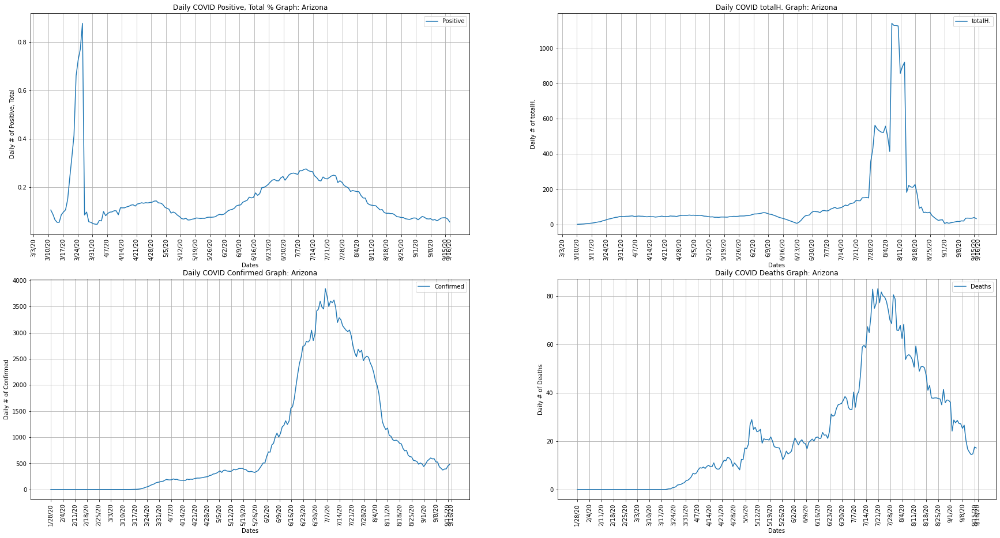

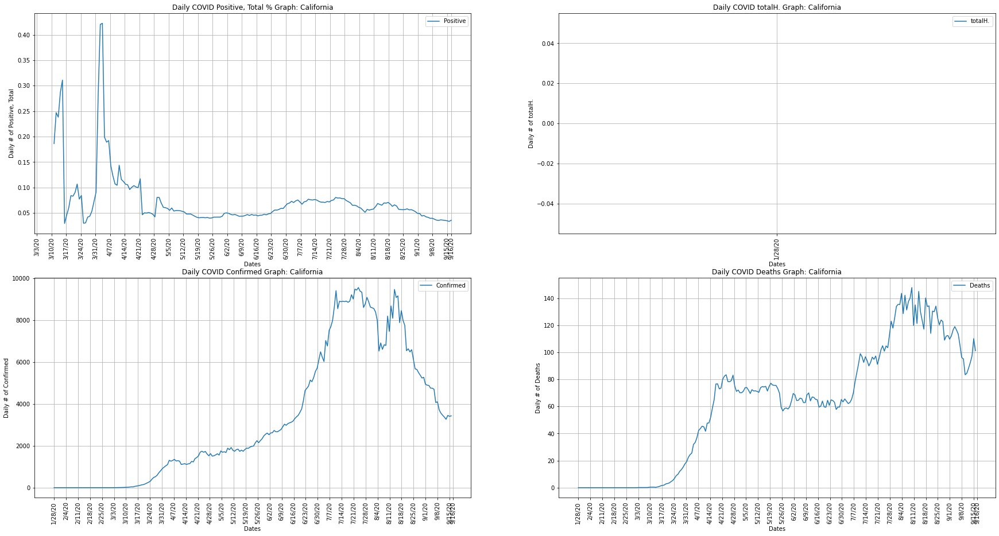

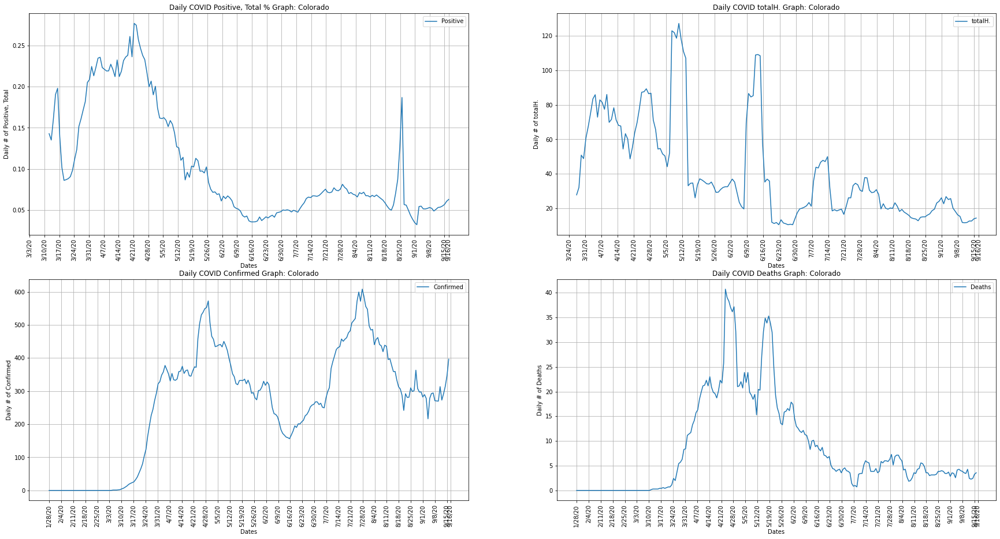

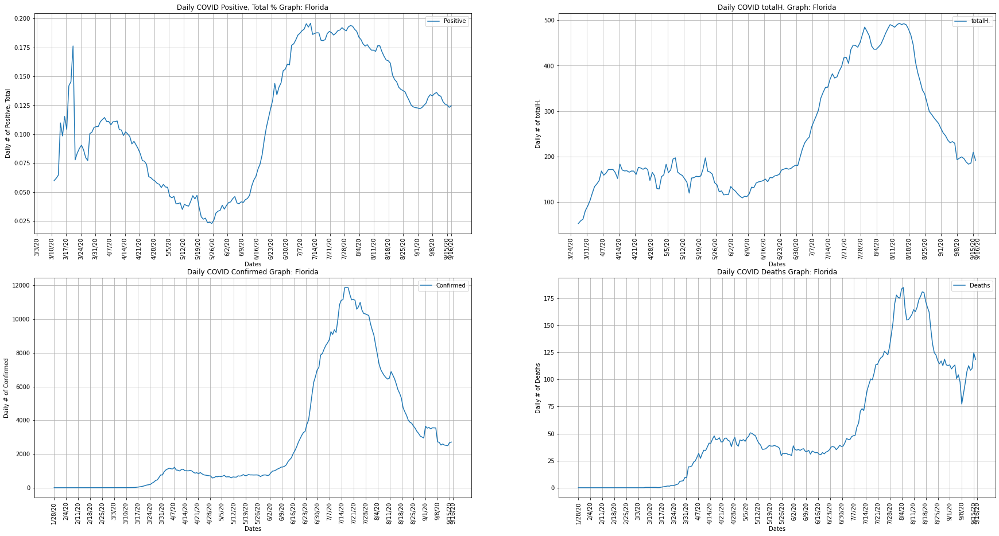

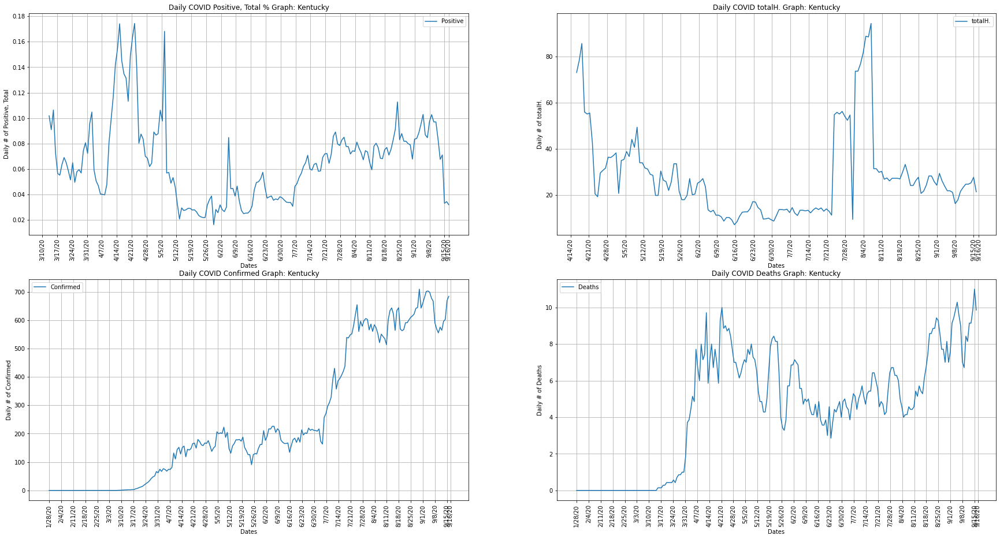

...

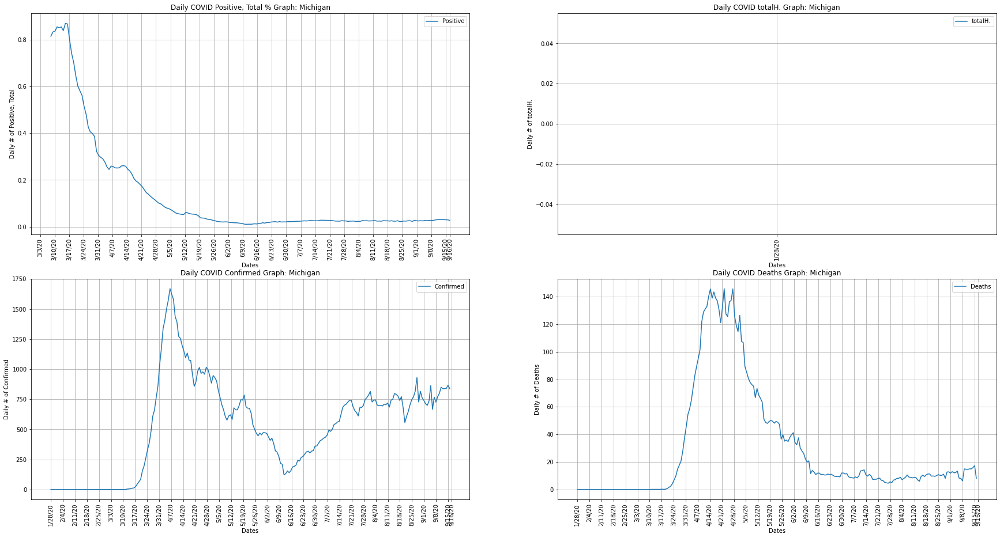

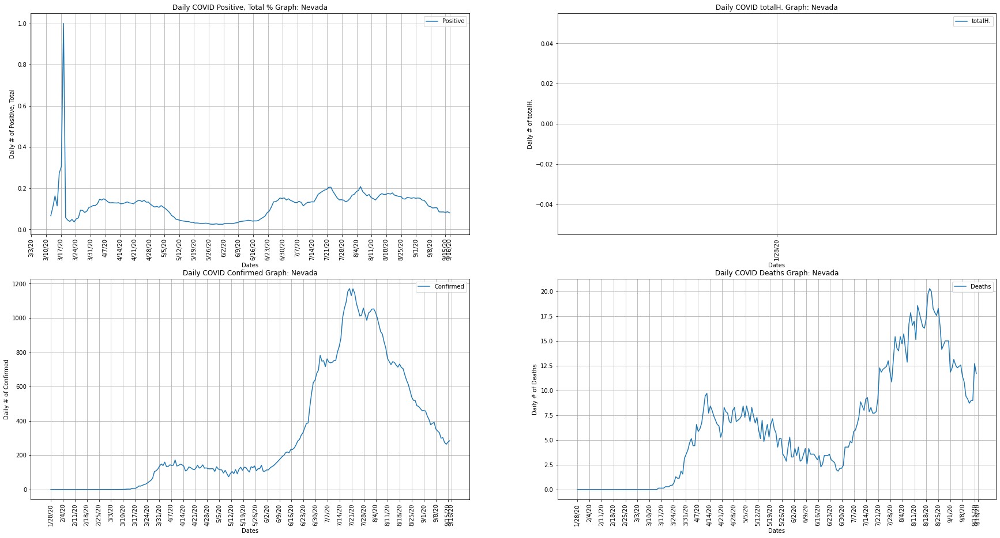

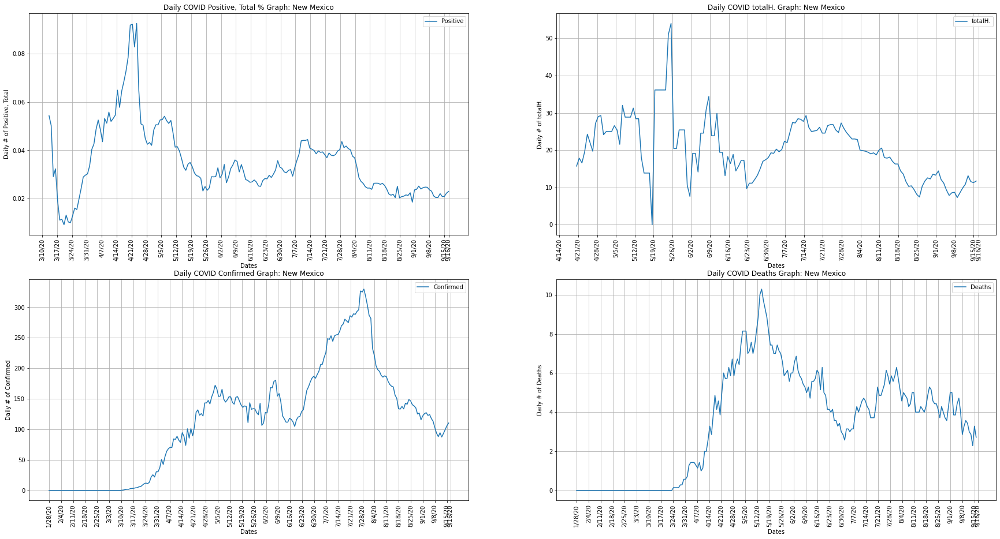

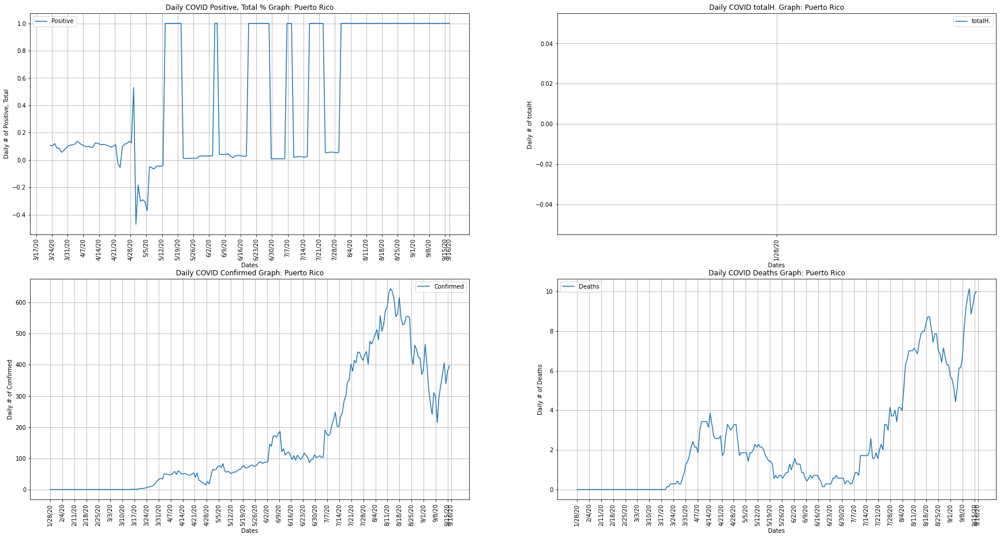

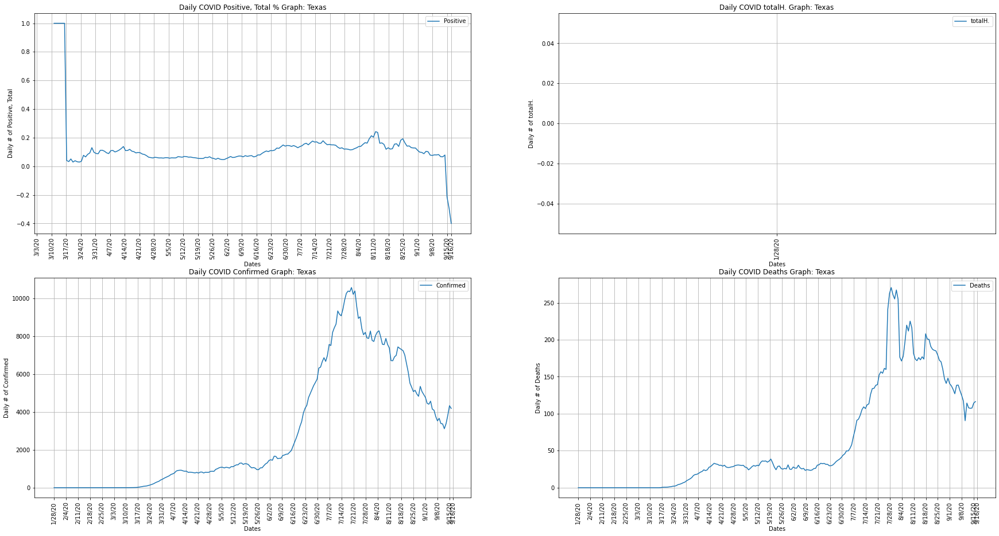

In [ ]:
# States Adding Significant Restrictions after Reopening
states = ['Arizona', 'California', 'Colorado', 'Florida', 'Kentucky', 
          'Louisiana', 'Michigan', 'Nevada', 'New Mexico', 'Puerto Rico', 
          'Texas']

# Graph Code
for state in states:
    graph = 4
    graph_types = [['Positive', 'Total'], ['totalH.'], ['Confirmed'], ['Deaths']]
    percent = ['yes', 'no', 'no', 'no']
    data = [graph, graph_types, percent]
    state_graph(state, 7, 'all', 'diff', data, 0, 'no')


#### Confirmed Decr.

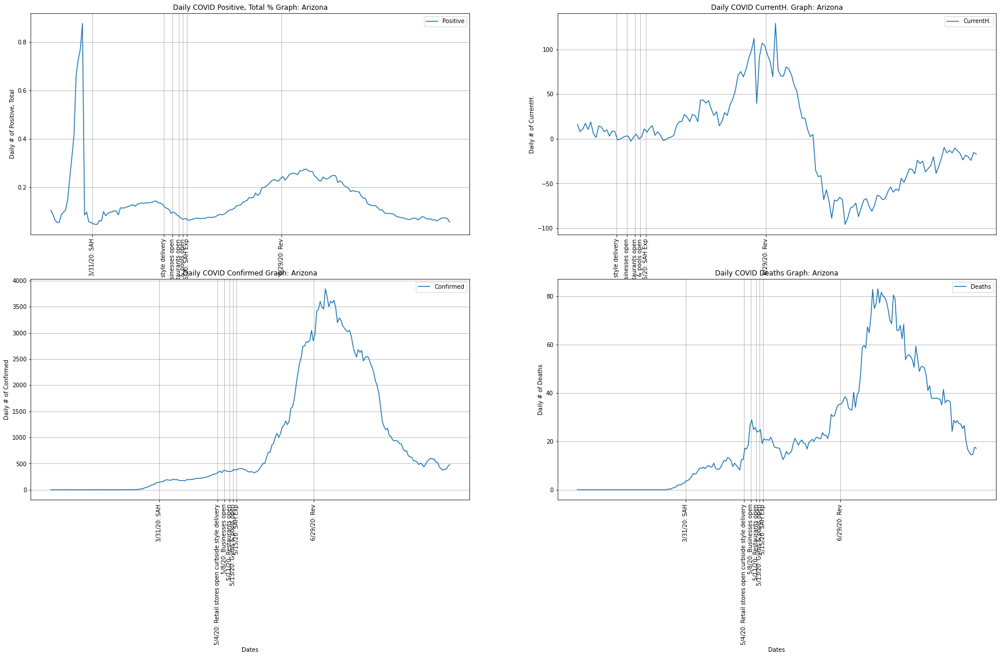

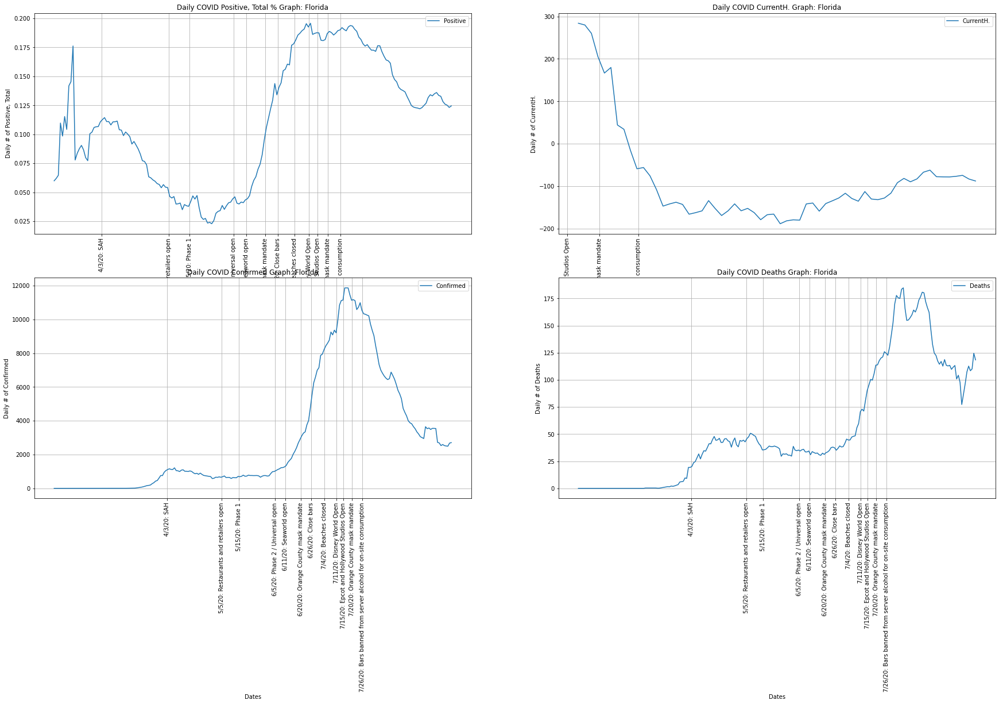

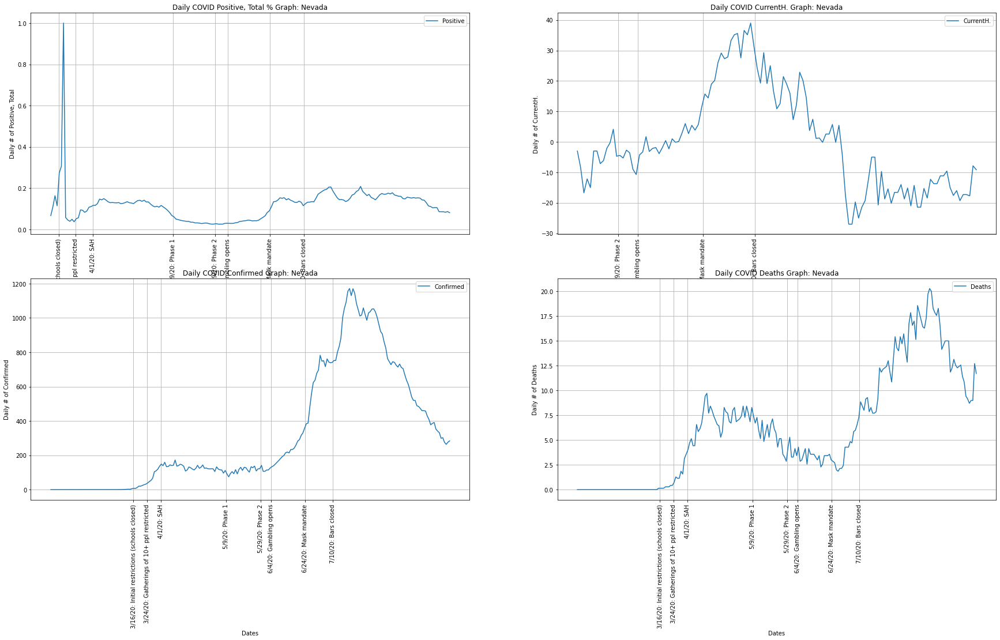

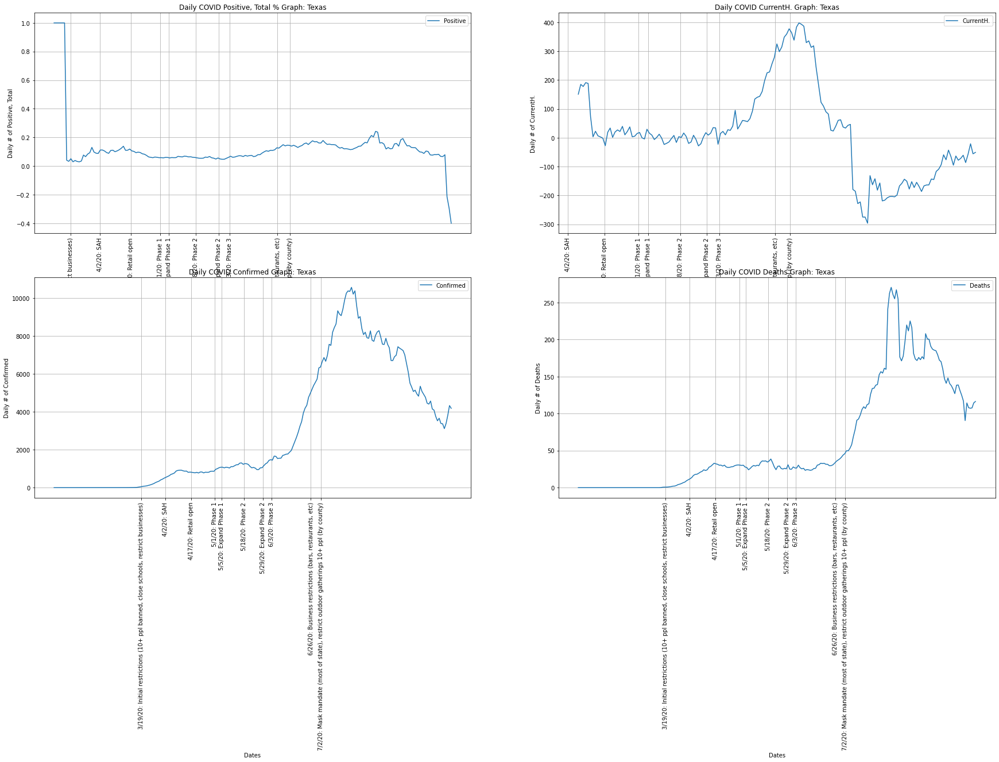

In [ ]:
# States Adding Significant Restrictions after Reopening
states = ['Arizona', 'Florida', 'Nevada', 'Texas']

# Graph Code
for state in states:
    graph = 4
    graph_types = [['Positive', 'Total'], ['CurrentH.'], ['Confirmed'], ['Deaths']]
    percent = ['yes', 'no', 'no', 'no']
    data = [graph, graph_types, percent]
    state_graph(state, 7, 'state_events', 'diff', data, 0, 'no')


### Pausing States

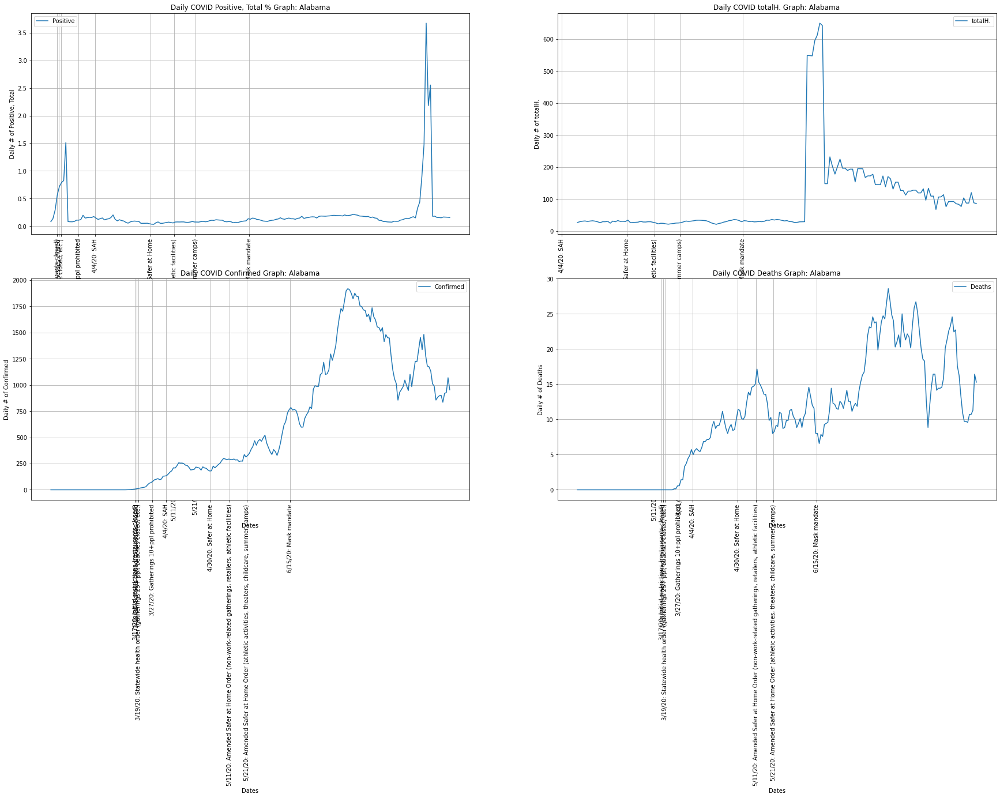

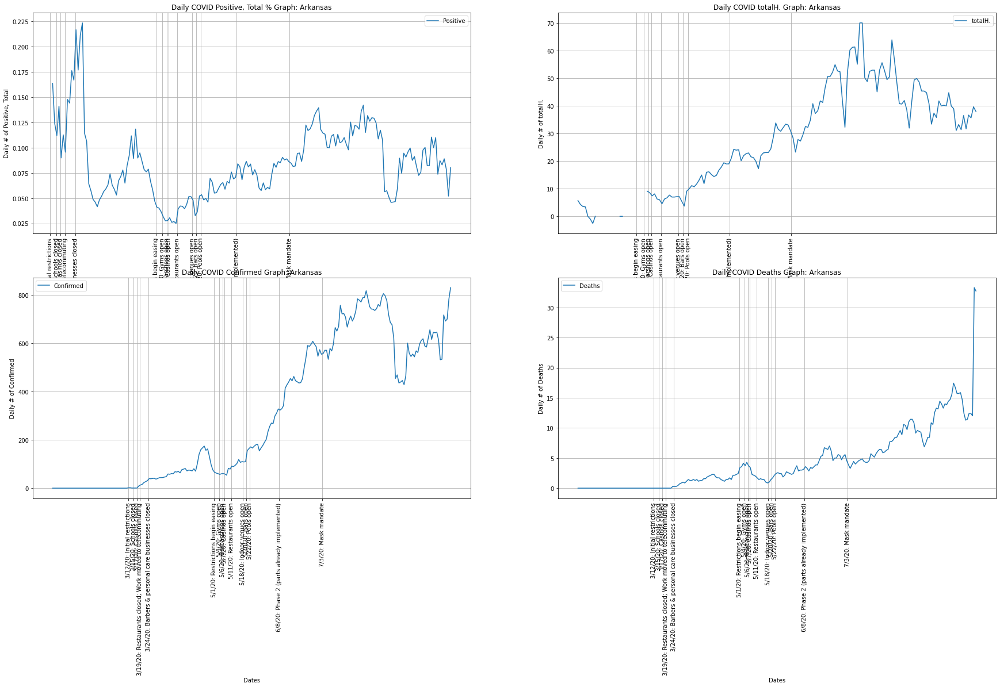

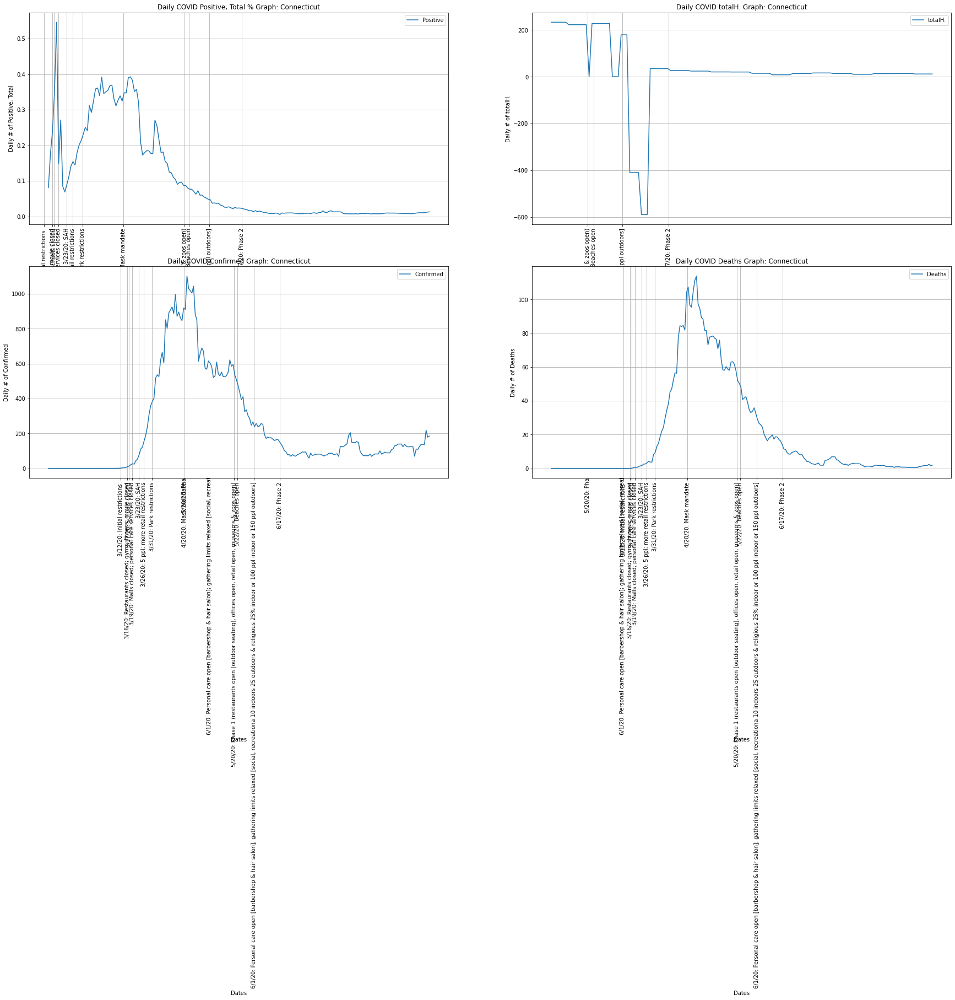

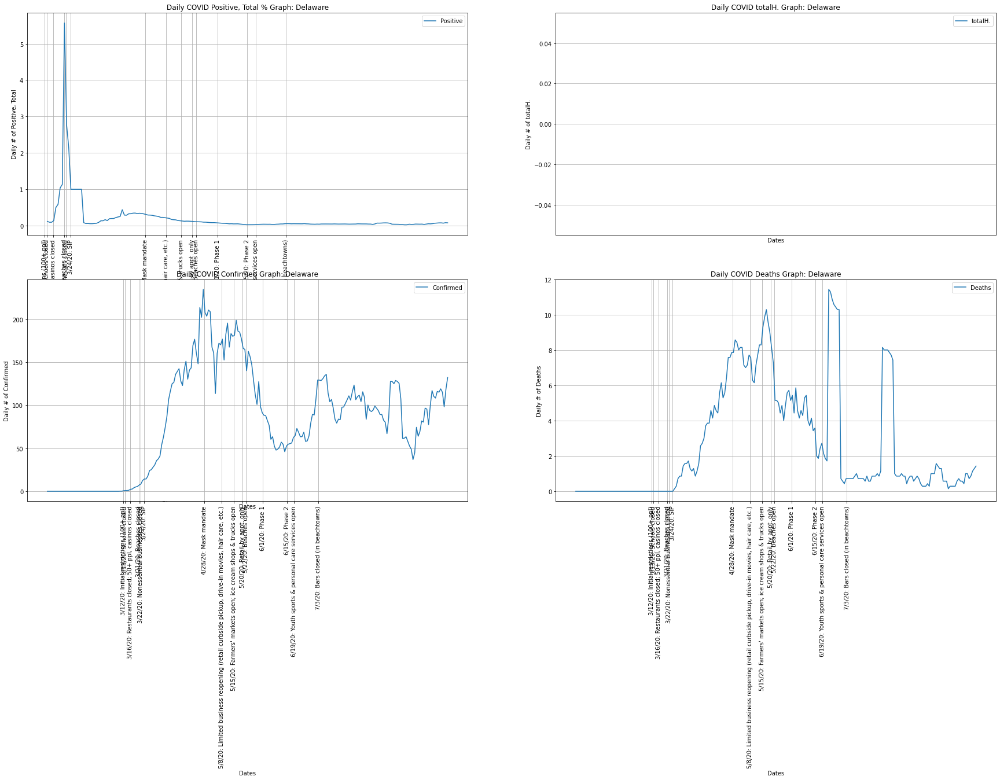

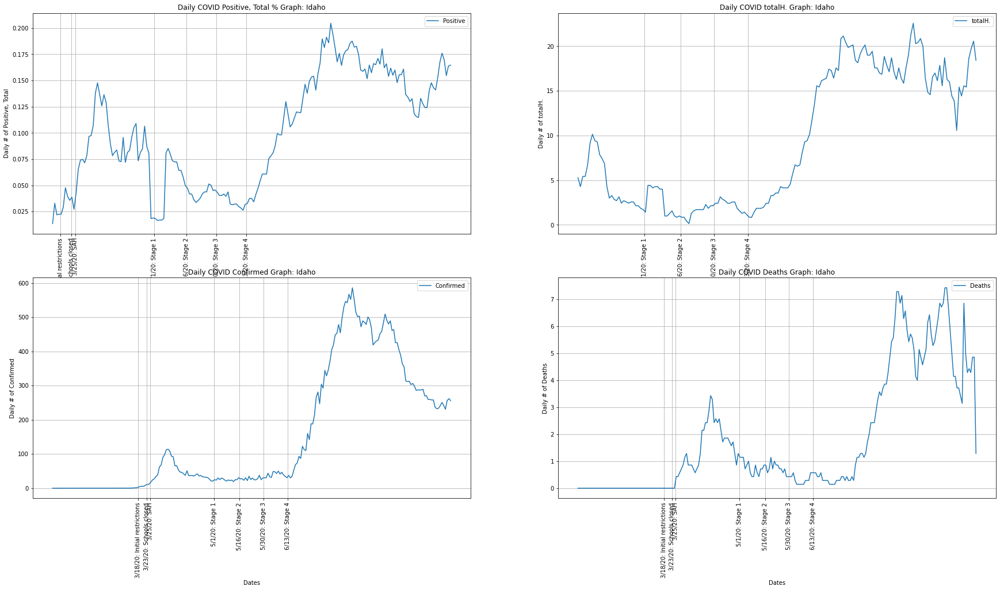

...

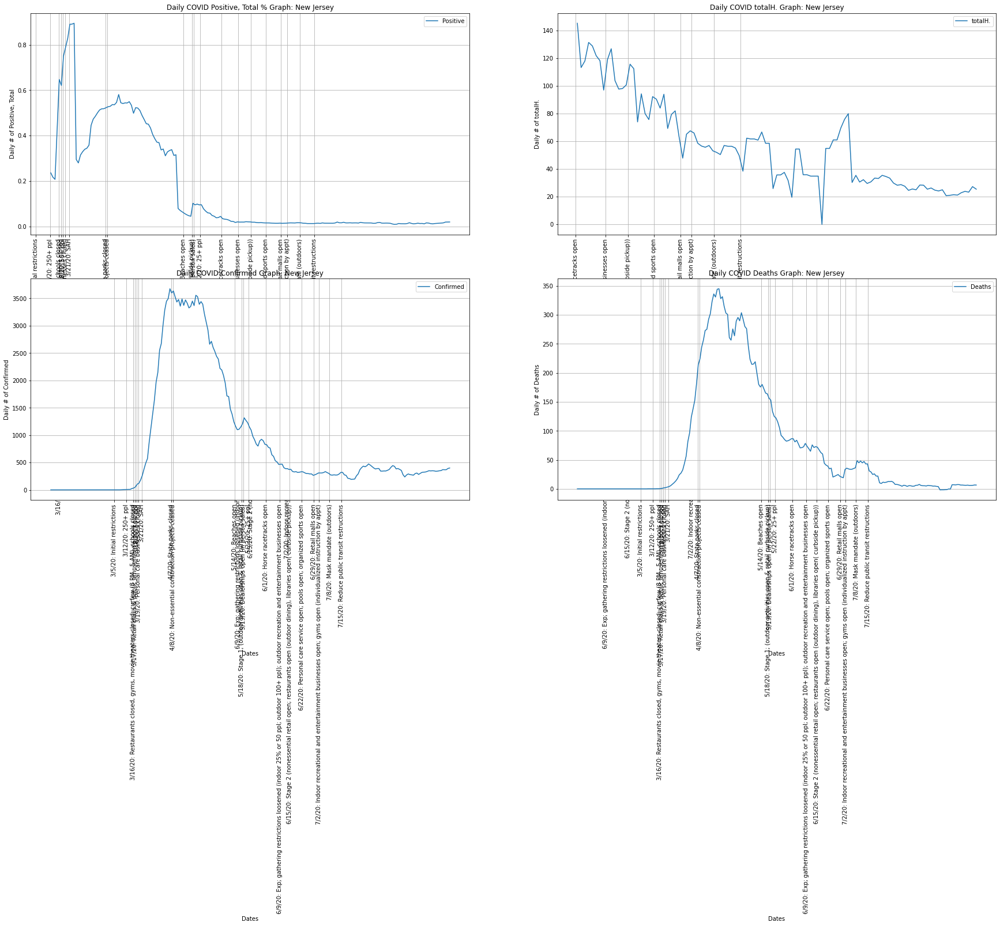

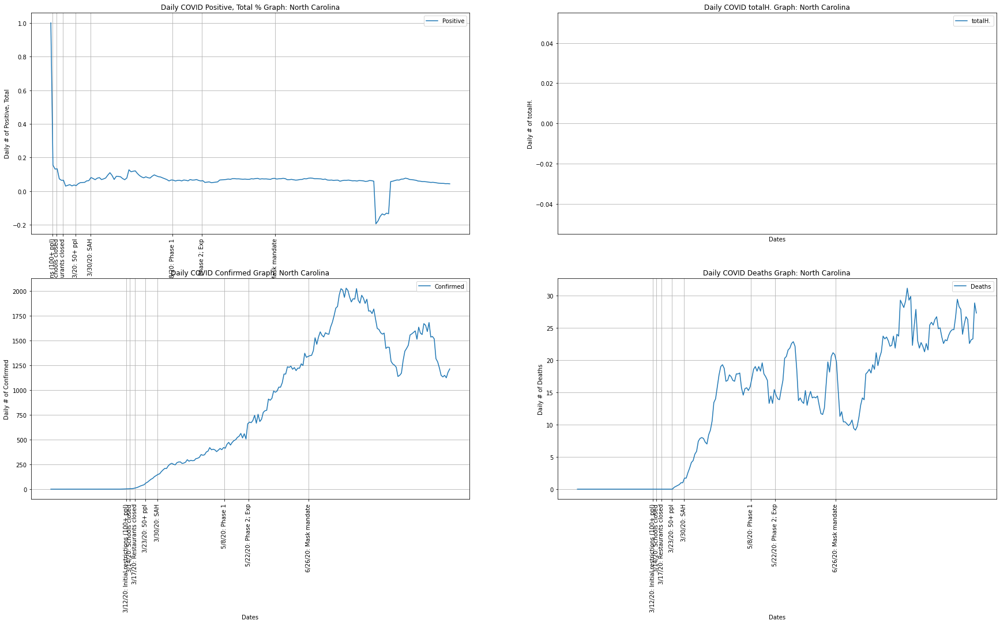

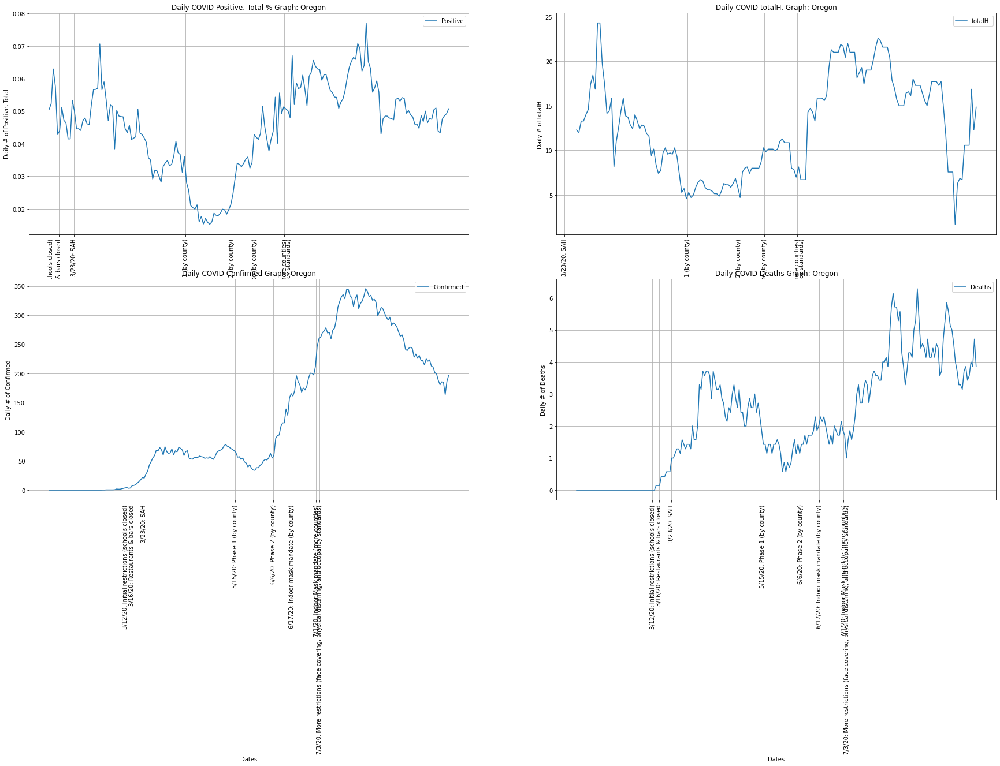

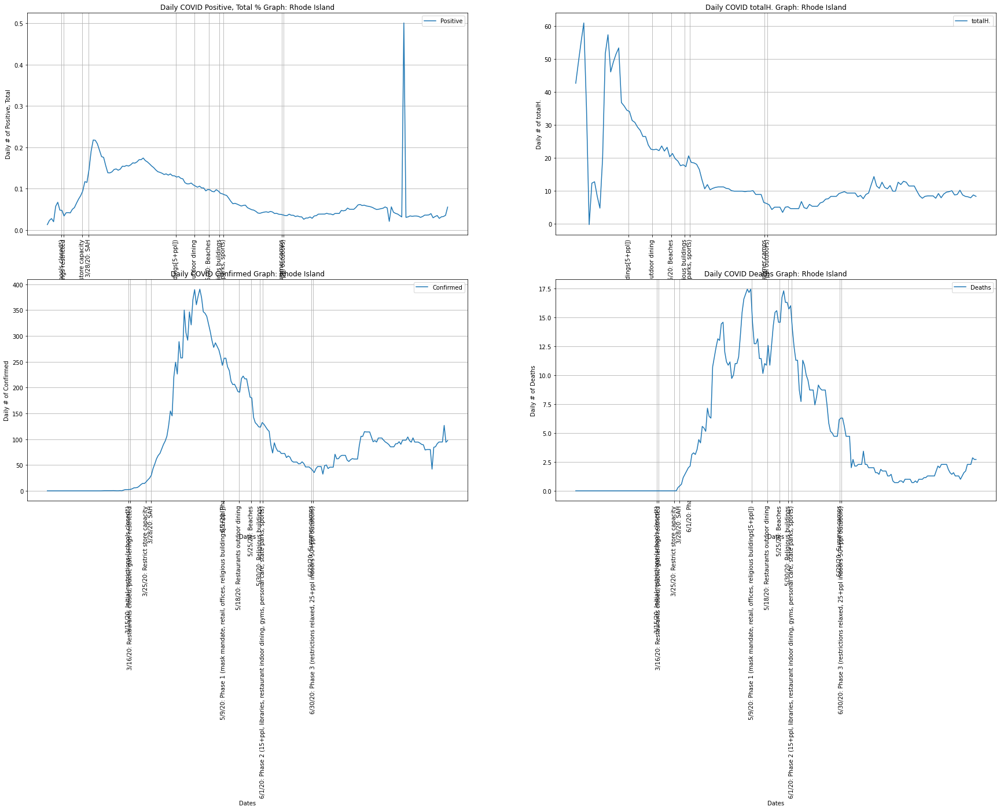

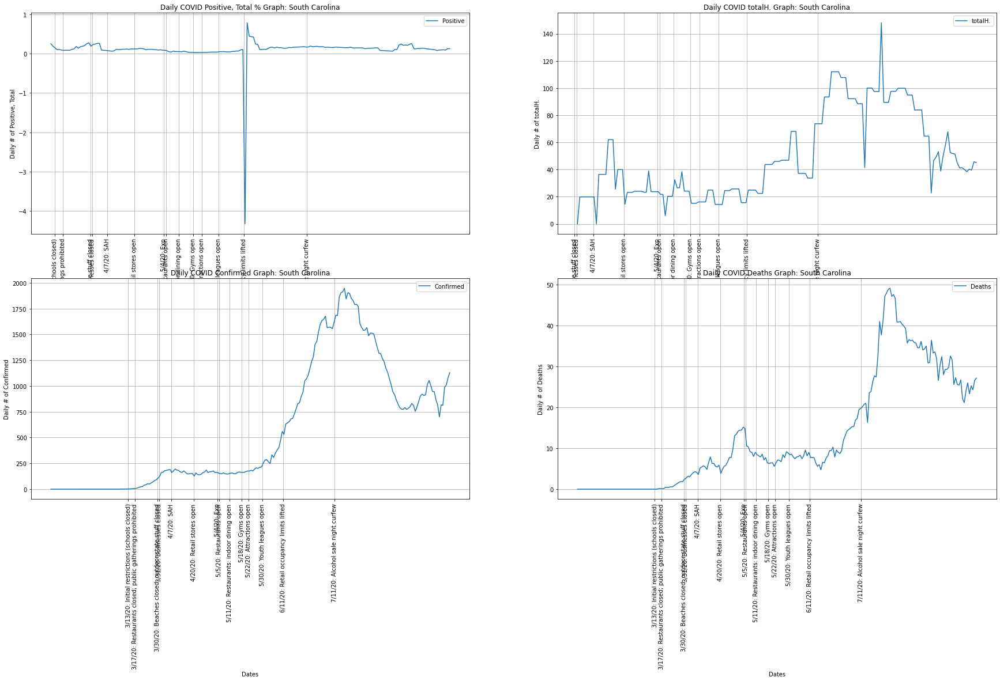

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:168: RuntimeWarning:

invalid value encountered in double_scalars



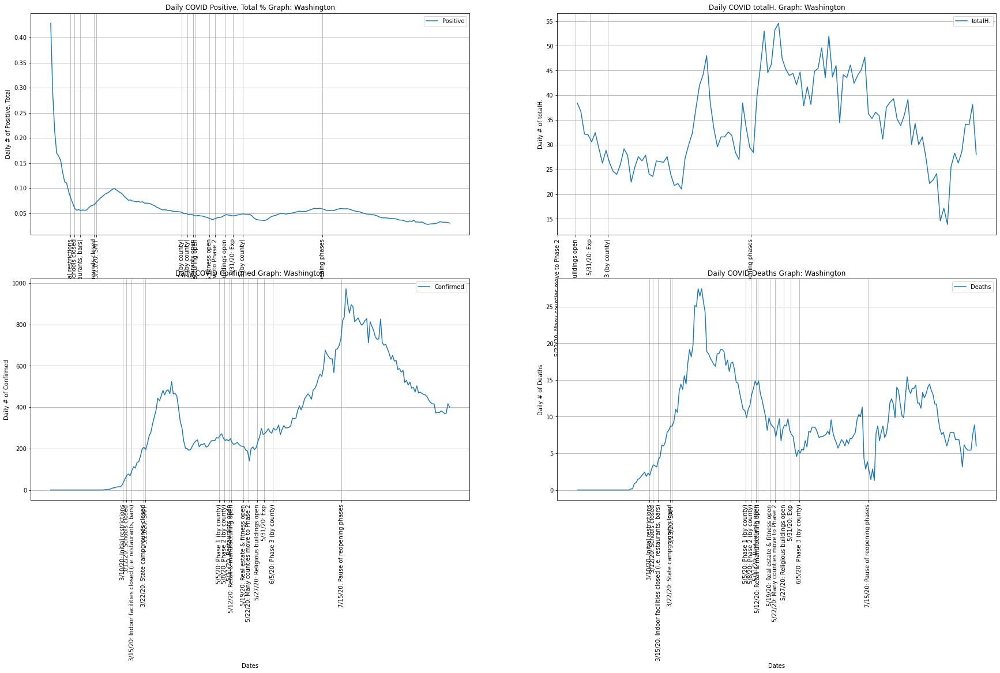

In [ ]:
states = ['Alabama', 'Arkansas', 'Connecticut', 'Delaware', 'Idaho', 
          'Indiana', 'Maryland', 'Mississippi', 'New Jersey', 
          'North Carolina', 'Oregon', 'Rhode Island', 'South Carolina', 
          'Washington',]

for state in states:
    graph = 4
    graph_types = [['Positive', 'Total'], ['totalH.'], ['Confirmed'], ['Deaths']]
    percent = ['yes', 'no', 'no', 'no']
    data = [graph, graph_types, percent]
    state_graph(state, 7, 'state_events', 'diff', data, 0, 'no')

### Reopening States

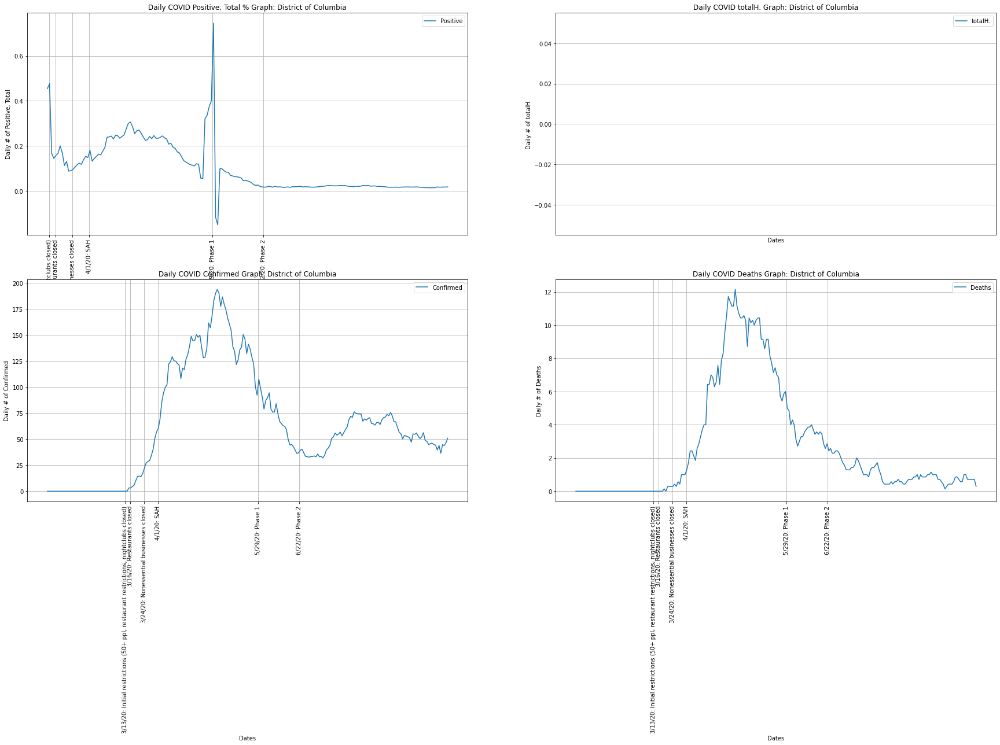

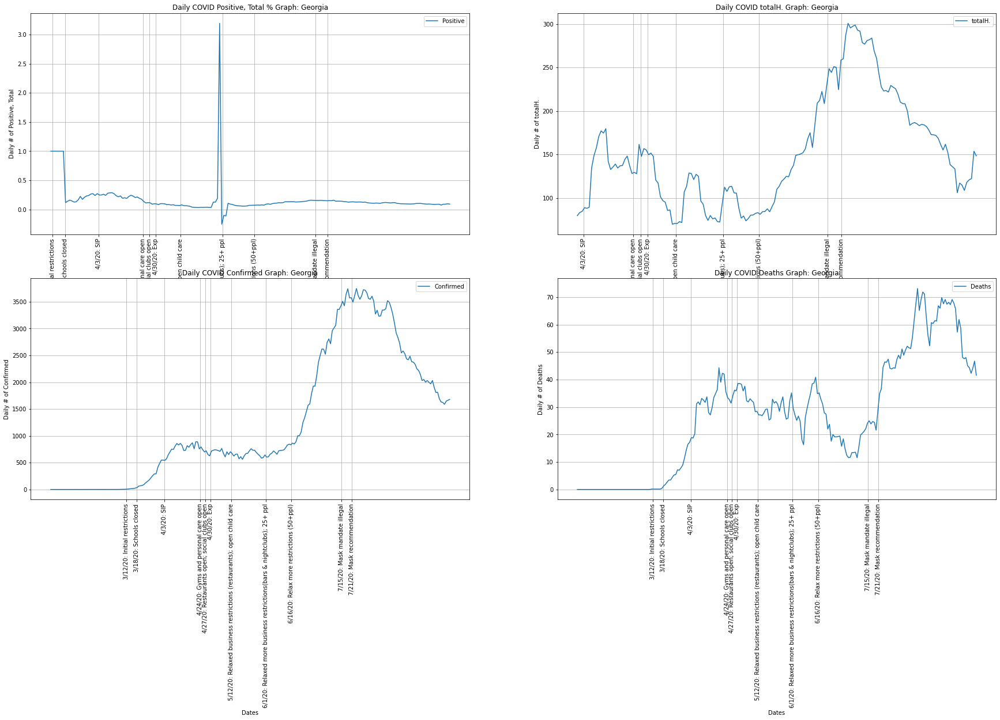

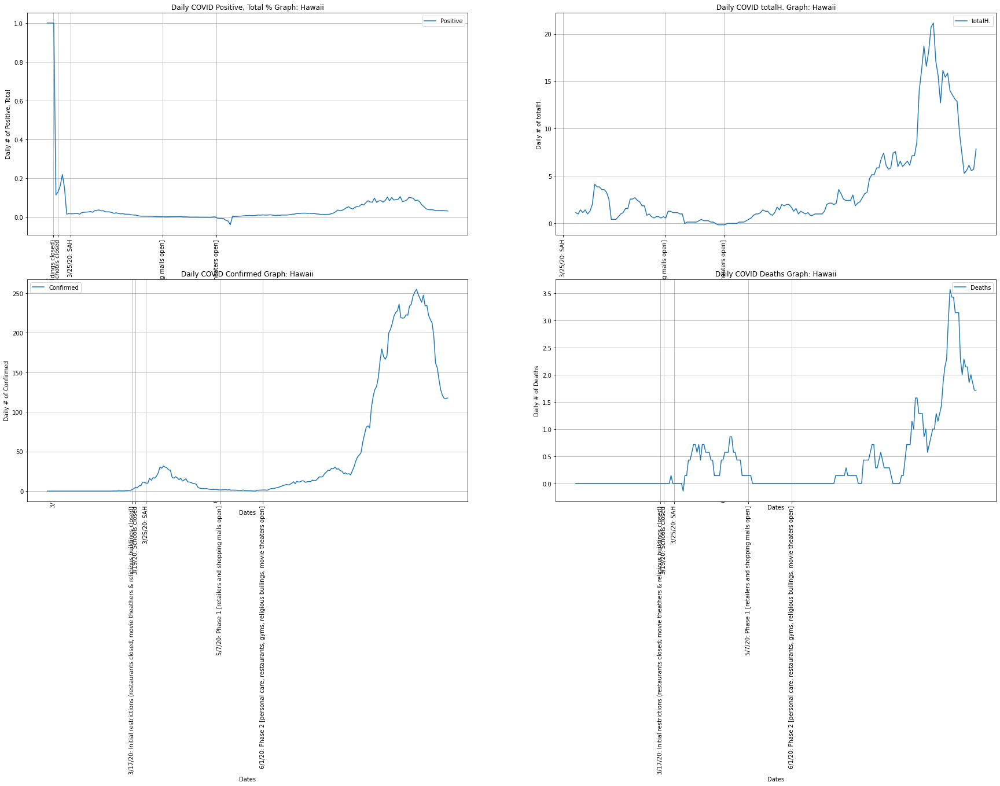

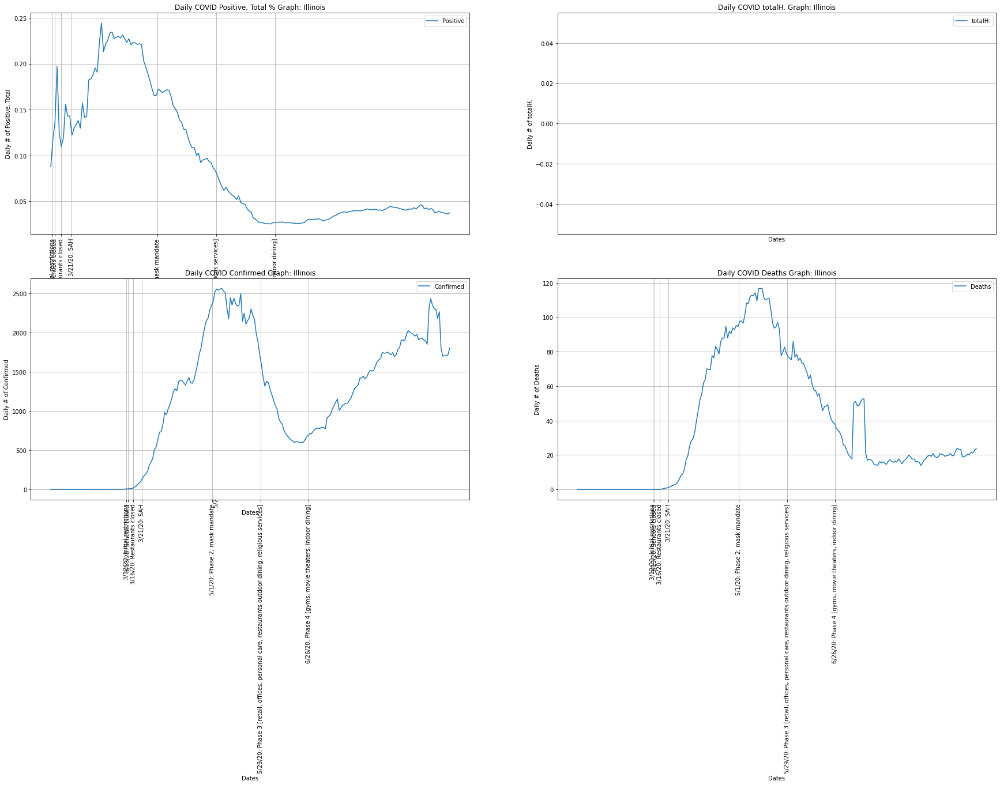

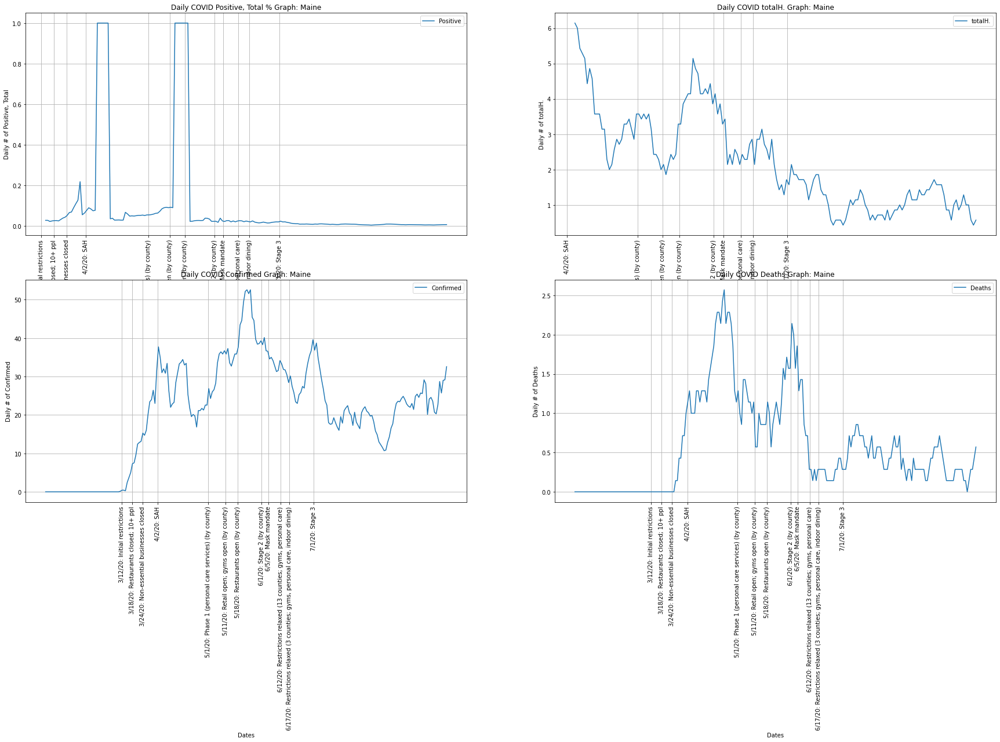

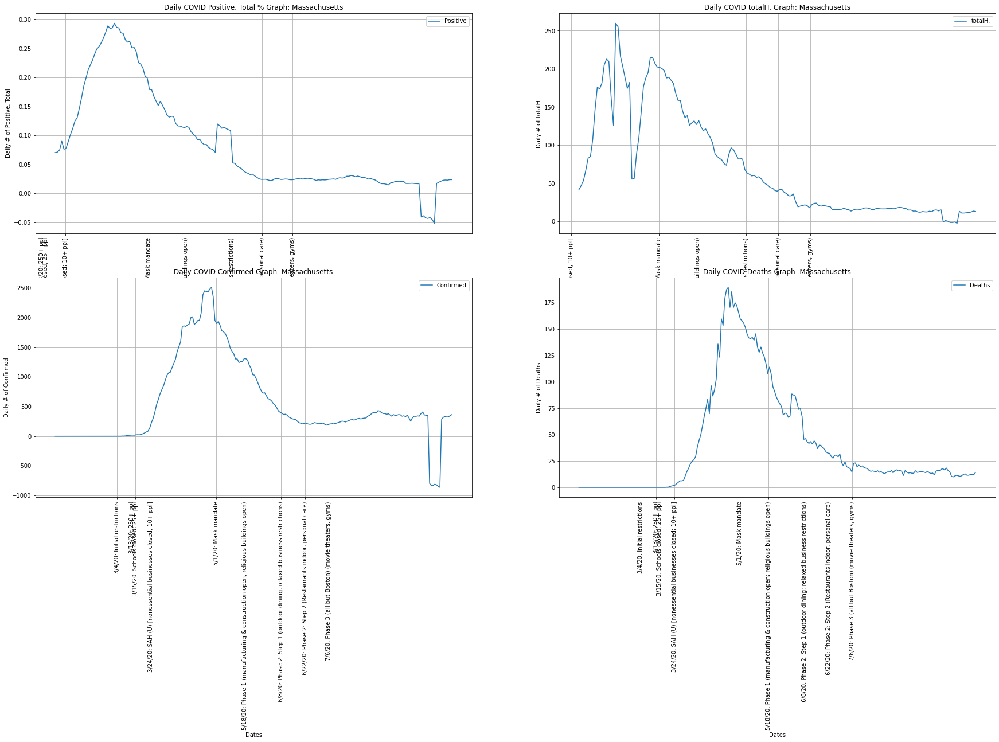

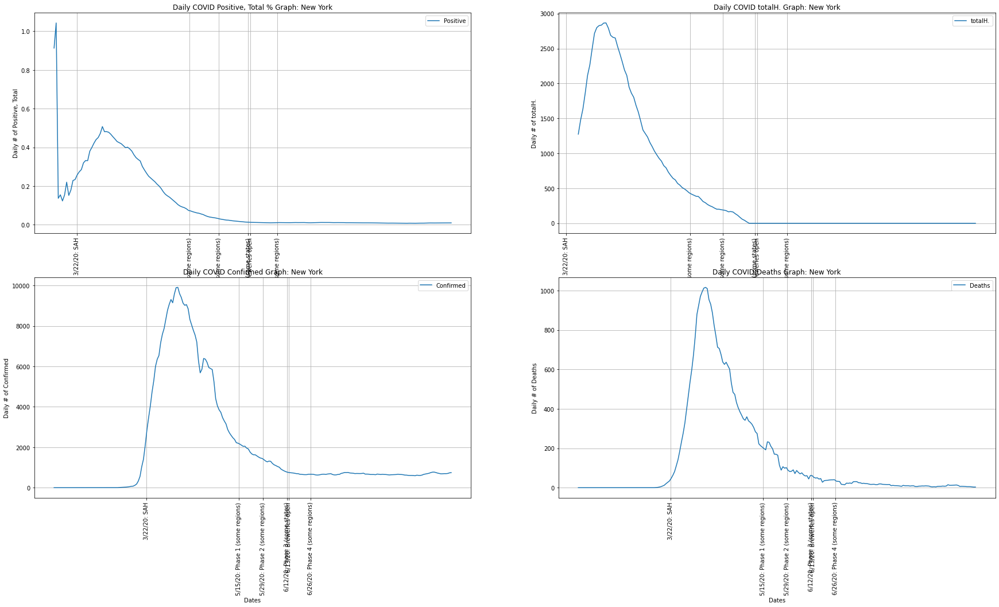

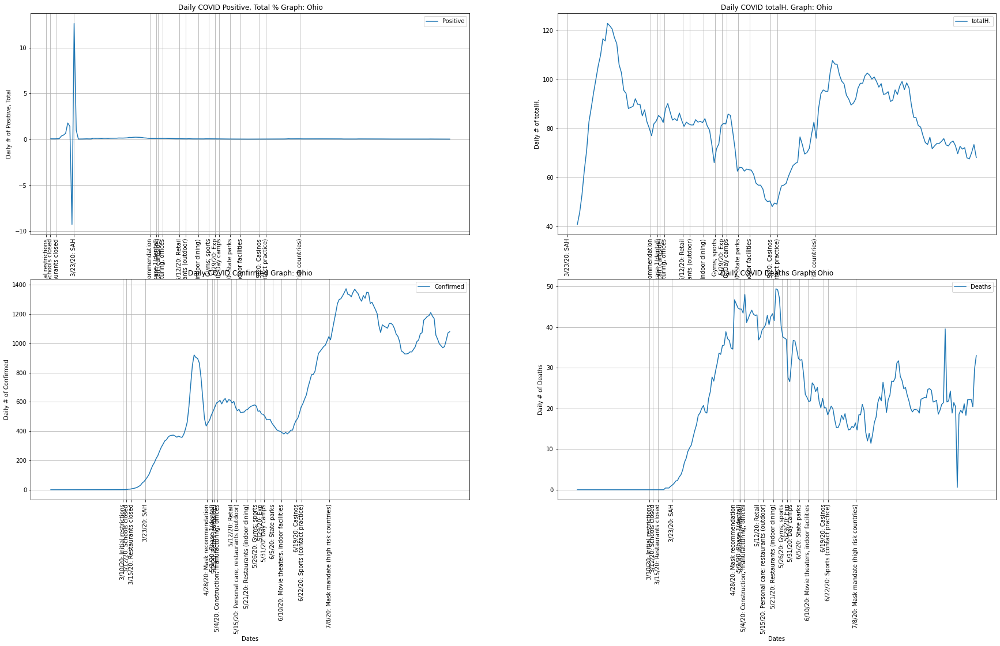

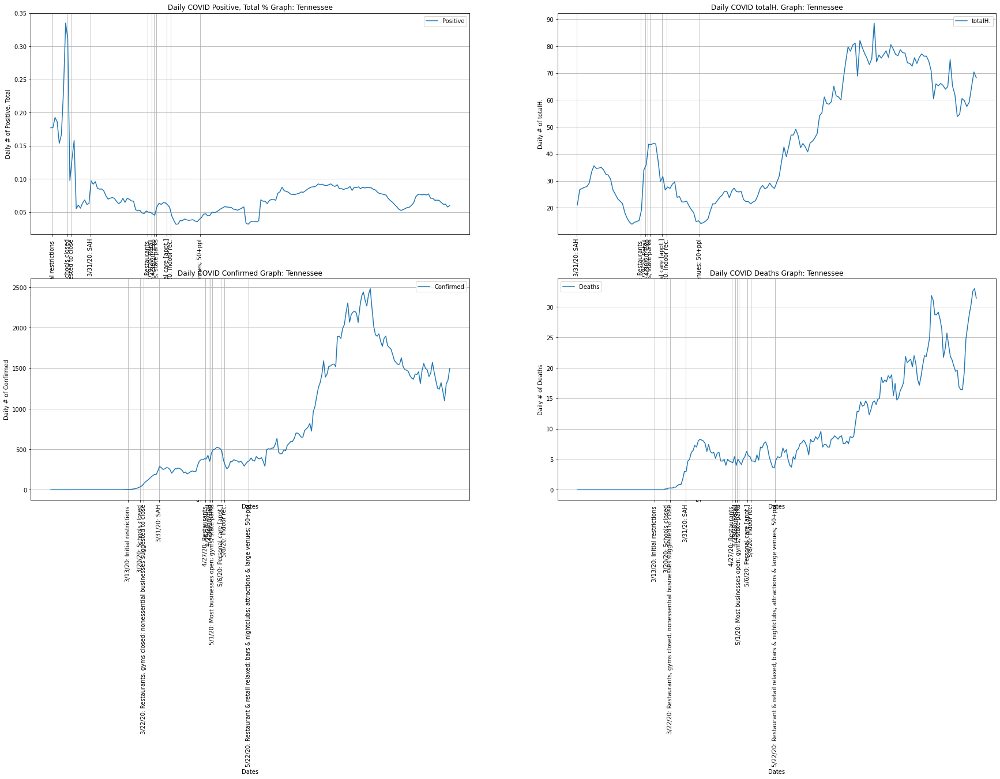

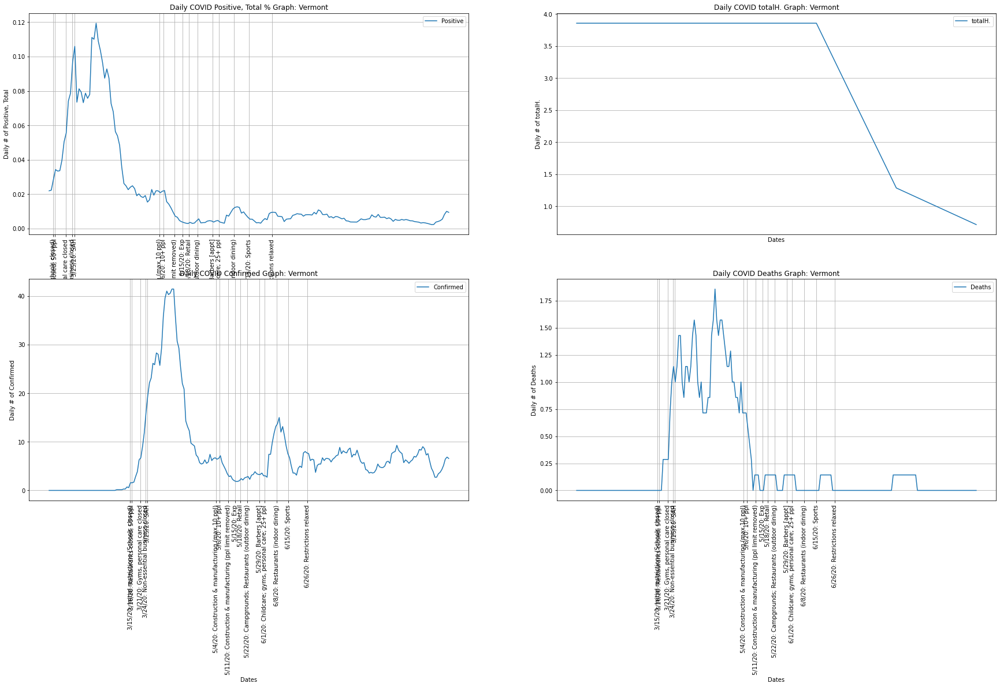

In [ ]:
states = ['District of Columbia', 'Georgia', 'Hawaii', 'Illinois', 'Maine', 
          'Massachusetts', 'New York', 'Ohio', 'Tennessee', 'Vermont',]

for state in states:
    graph = 4
    graph_types = [['Positive', 'Total'], ['totalH.'], ['Confirmed'], ['Deaths']]
    percent = ['yes', 'no', 'no', 'no']
    data = [graph, graph_types, percent]
    state_graph(state, 7, 'state_events', 'diff', data, 0, 'no')

#### Reopened States

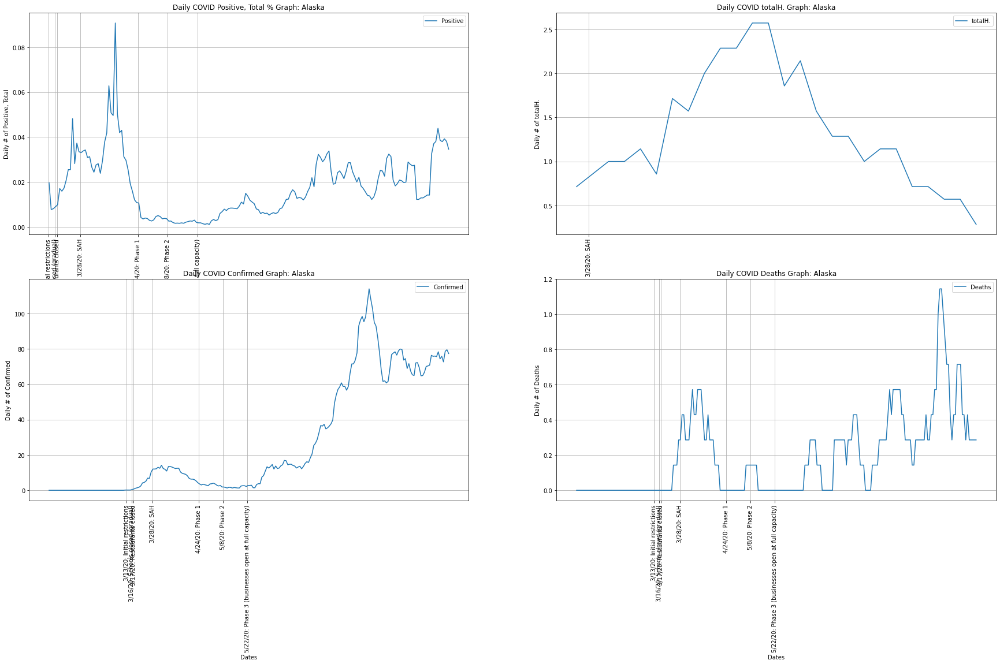

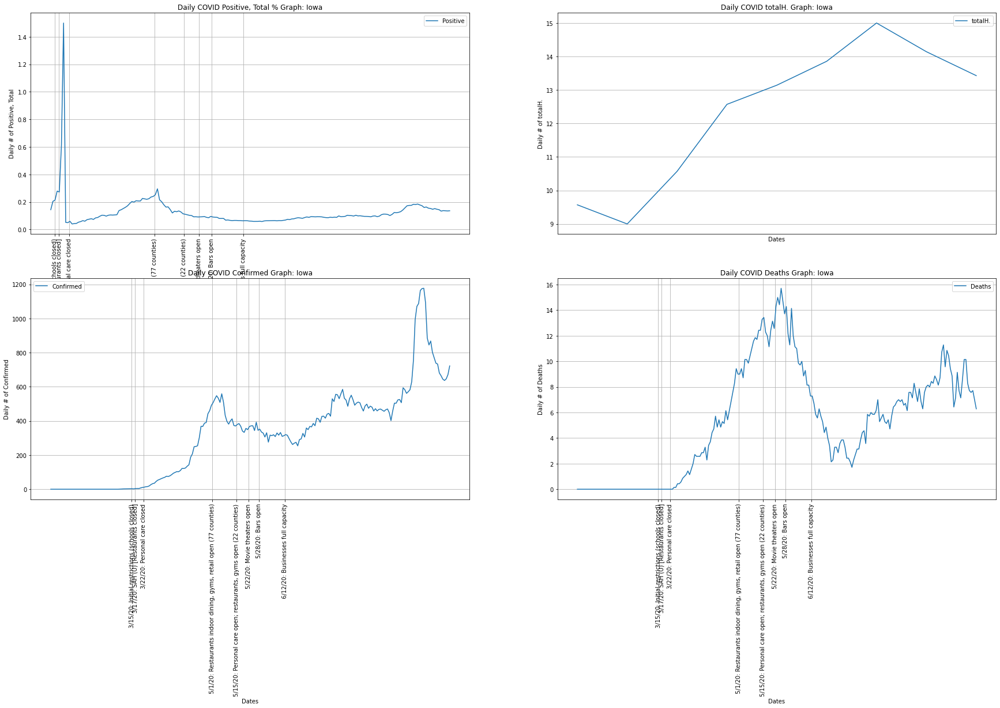

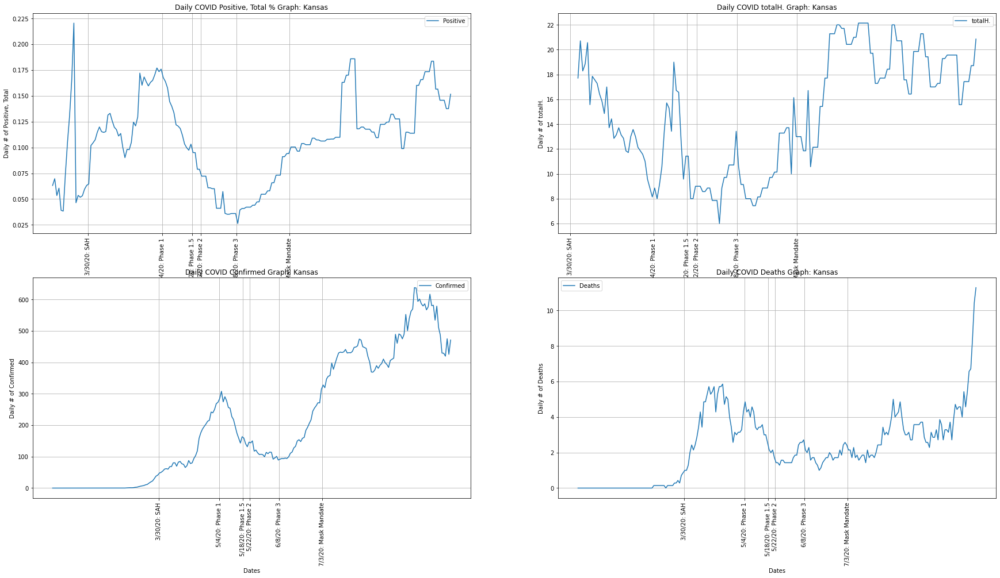

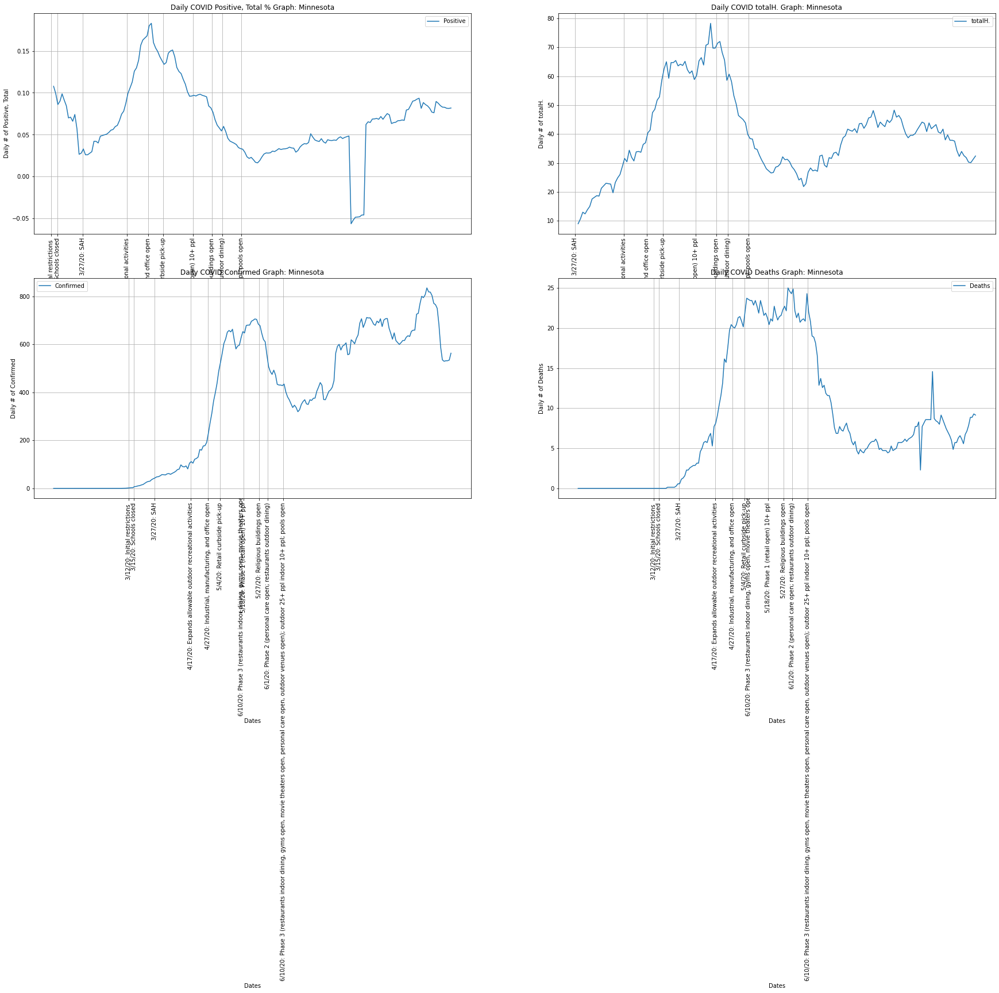

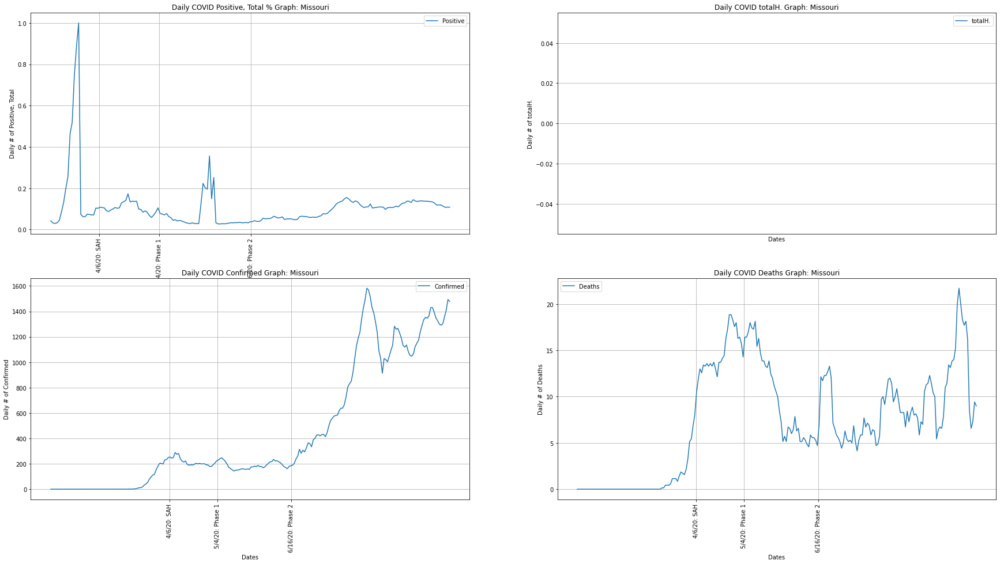

...

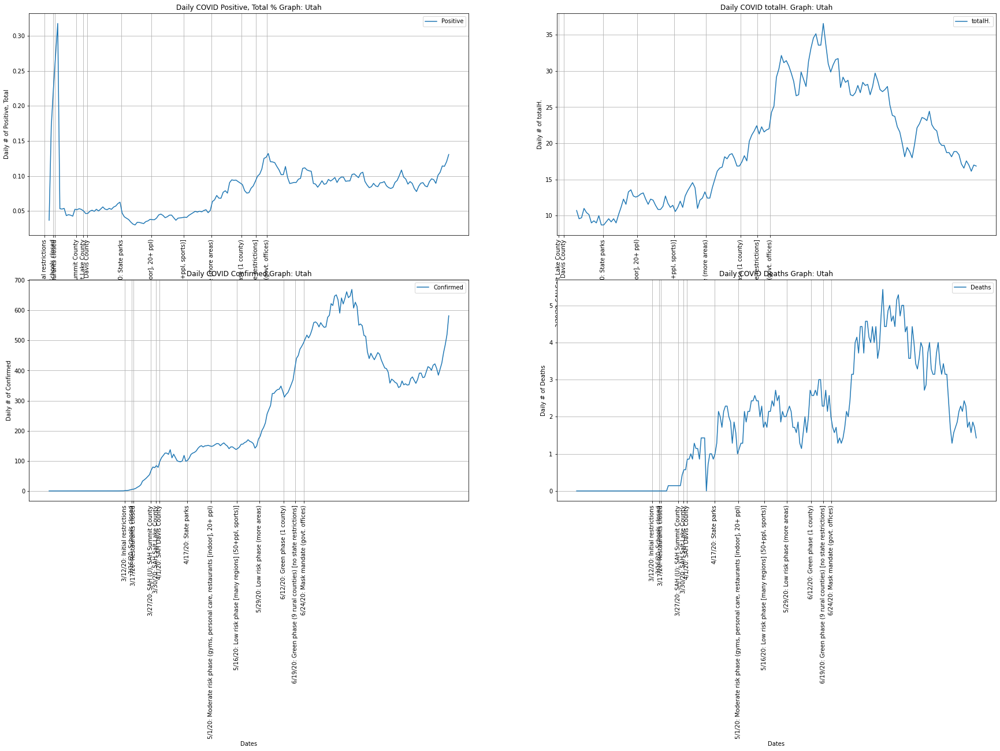

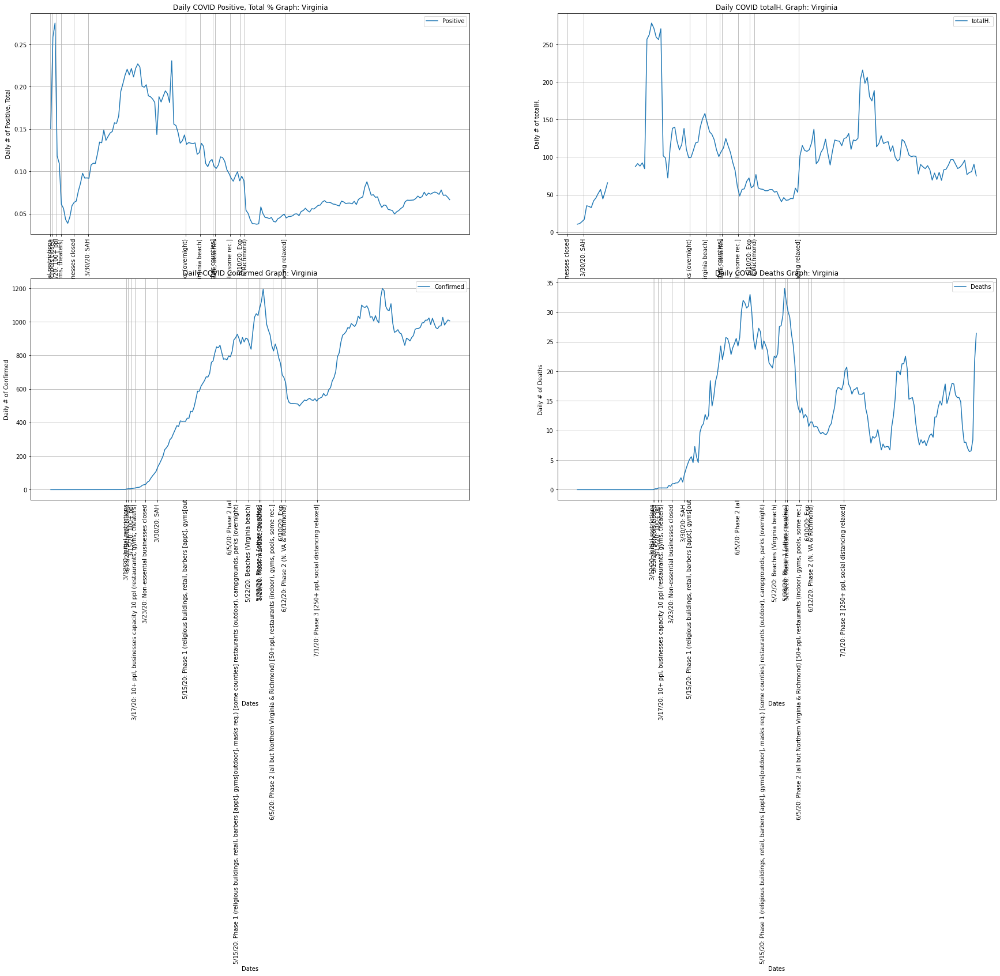

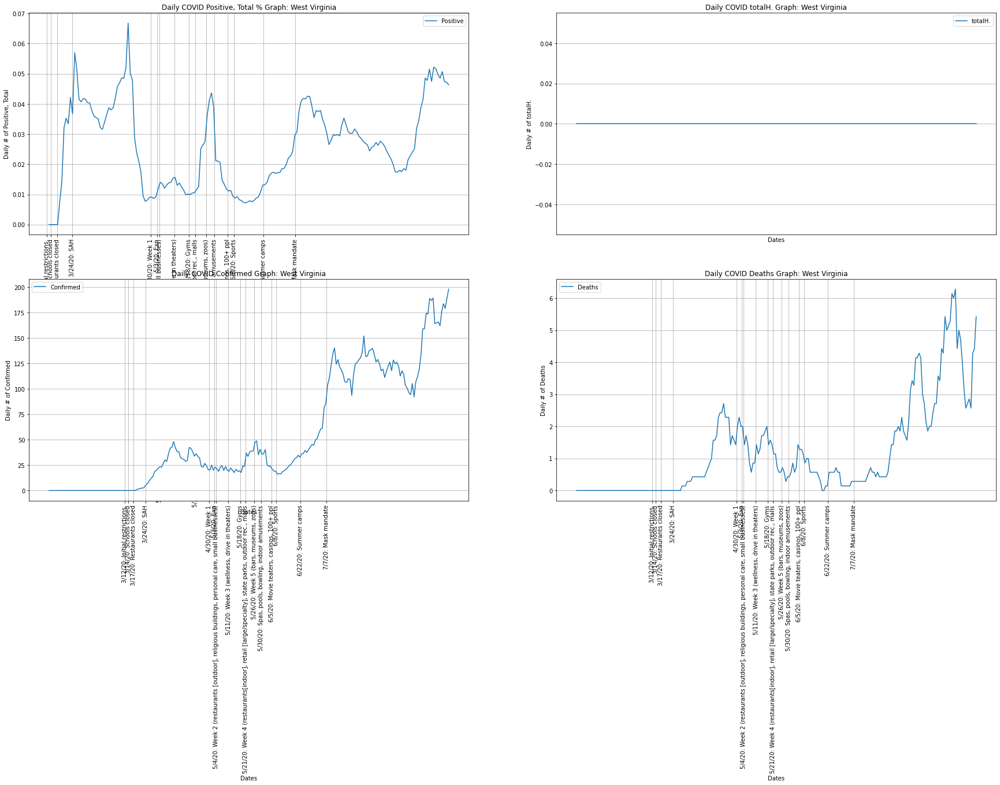

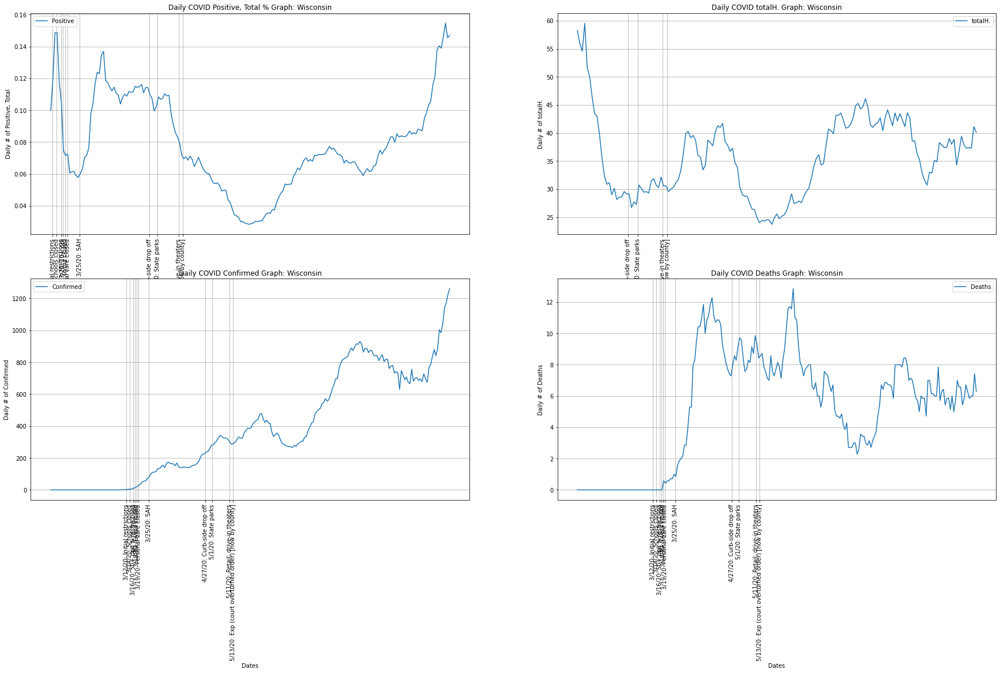

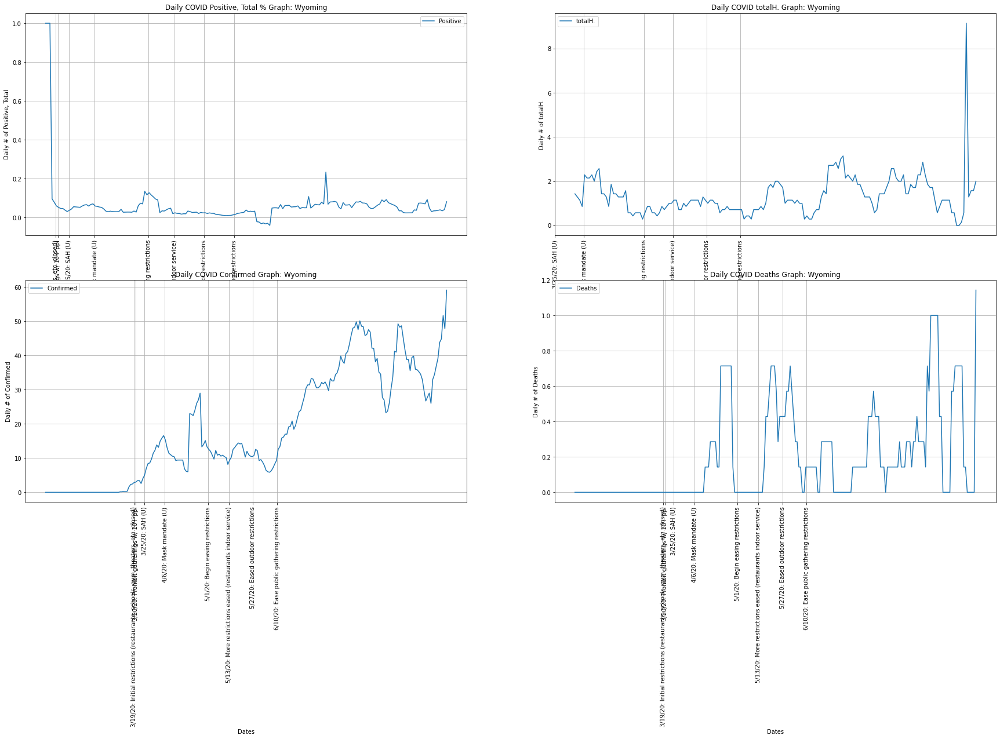

In [ ]:
states = ['Alaska', 'Iowa', 'Kansas', 'Minnesota', 'Missouri', 'Montana', 
          'Nebraska', 'New Hampshire', 'North Dakota', 'Oklahoma', 
          'Pennsylvania', 'South Dakota', 'Utah', 'Virginia', 'West Virginia'
          , 'Wisconsin', 'Wyoming']

for state in states:
    graph = 4
    graph_types = [['Positive', 'Total'], ['totalH.'], ['Confirmed'], ['Deaths']]
    percent = ['yes', 'no', 'no', 'no']
    data = [graph, graph_types, percent]
    state_graph(state, 7, 'state_events', 'diff', data, 0, 'no')

## Masks

### Mask Graph Code

In [ ]:
def group_state_graph(num, graph, percent, states, window, dates):
    # Graph of Early States's Confirmed
    fig = plt.figure(figsize = (40, 12))

    # Data cutoff
    cutoff = cutoff_code(dates, states[0])

    # Dates (do once)
    dates, tick_loc, tick_labels = make_dates('all', window, states[0], cutoff)
    t = np.linspace(0, len(dates), len(dates))

    for i in range(num):
        # Graph details
        ax = graph_details(fig, states[0], i, 2, [graph], percent[i], 'diff', tick_loc, tick_labels)

        for state in states:

            plot, scale = graph_func([graph], percent[i], state, 'diff', window, cutoff)

            ax.plot(t, plot[0], label = state)
            ax.set_yscale(scale)

            ax.grid(which = 'major')
            ax.legend()

    """
        if type(lag) == int:
            # Plot lag grid
            ax.plot(t[:-lag], plot[j][lag:], label = str(lag) + ' Day Lag Data')
        elif lag == 'no':
            pass
        else:
            raise ValueError('Invalid lag input')
    """


In [ ]:
def test_group_state_graph(num, graph, percent, states, window, dates):
    # Graph of Early States's Confirmed
    fig = plt.figure(figsize = (40, 12))

    # Data cutoff
    cutoff = cutoff_code(dates, states[0])

    # Dates (do once)
    dates, tick_loc, tick_labels = make_dates('all', window, states[0], cutoff)
    t = np.linspace(0, len(dates), len(dates))

    for i in range(num):
        # Graph details
        ax = graph_details(fig, states[0], i, 2, graph, percent[i], 'diff', tick_loc, tick_labels)

        for state in states:

            plot, scale = graph_func(graph, percent[i], state, 'diff', window, cutoff)

            ax.plot(t, plot[0], label = state)
            ax.set_yscale(scale)

            ax.grid(which = 'major')
            ax.legend()

    """
        if type(lag) == int:
            # Plot lag grid
            ax.plot(t[:-lag], plot[j][lag:], label = str(lag) + ' Day Lag Data')
        elif lag == 'no':
            pass
        else:
            raise ValueError('Invalid lag input')
    """


### State Mask Mandate Dates

In [ ]:
# Dictionary of Mask Mandate Dates in US
state_names = list(us_state_abbrev.keys())
state_names.sort()

state_mask_mandates = dict({x: None for x in state_names})

dates = ['7/16/20', None, None, '7/20/20', '6/18/20', '7/17/20', 
         '4/20/20', '4/28/20', '5/16/20', None, None, '4/20/20', 
         None, '5/1/20', '7/27/20', None, '7/3/20', '5/11/20', 
         '7/13/20', '5/1/20', '4/18/20', '5/6/20', '6/18/20', 
         '7/25/20', '8/4/20', None, '7/16/20', None, '6/24/20', 
         '8/11/20', '4/8/20', '5/16/20', '4/17/20', '6/26/20', 
         None, '7/23/20', None, '7/1/20', '4/19/20', '4/30/20',
         '5/8/20', None, None, None, '7/3/20', None, '8/1/20',
         '5/29/20', '6/26/20', '7/6/20', '8/1/20', None]

extra_mask_mandates = {'District of Columbia': '7/22/20', 
                       'Hawaii': '7/3/20', 'Illinois': '8/11/20',
                       'Kansas': 'opt out', 'Kentucky': '7/9/20',
                       'Maine': '7/8/20', 'Maryland': '7/31/20', 
                       'Michigan': '7/10/20', 'Mississippi': 
                       'earlier by county', 'New Jersey': '7/8/20',
                       'New Mexico': '7/13/20;enforcement issues',
                       'Pennsylvania': '4/19/20', 
                       'Puerto Rico': '5/26/20'}

counter = 0
for state in state_mask_mandates.keys():
    state_mask_mandates[state] = dates[counter]
    counter += 1

### Early Mask Mandate (- June 1st)

California: 6/18/20
Connecticut: 4/20/20
Delaware: 4/28/20
District of Columbia: 5/16/20
Hawaii: 4/20/20
Illinois: 5/1/20
Kentucky: 5/11/20
Maine: 5/1/20
Maryland: 4/18/20
Massachusetts: 5/6/20
Michigan: 6/18/20
Nevada: 6/24/20
New Jersey: 4/8/20
New Mexico: 5/16/20
New York: 4/17/20
North Carolina: 6/26/20
Pennsylvania: 4/19/20
Puerto Rico: 4/30/20
Rhode Island: 5/8/20
Virginia: 5/29/20
Washington: 6/26/20
Funky: District of Columbia
Funky: Hawaii
Funky: Illinois
Funky: Kentucky
Funky: Maine
Funky: Maryland
Funky: Michigan
Funky: New Jersey
Funky: New Mexico
Funky: Pennsylvania
Funky: Puerto Rico


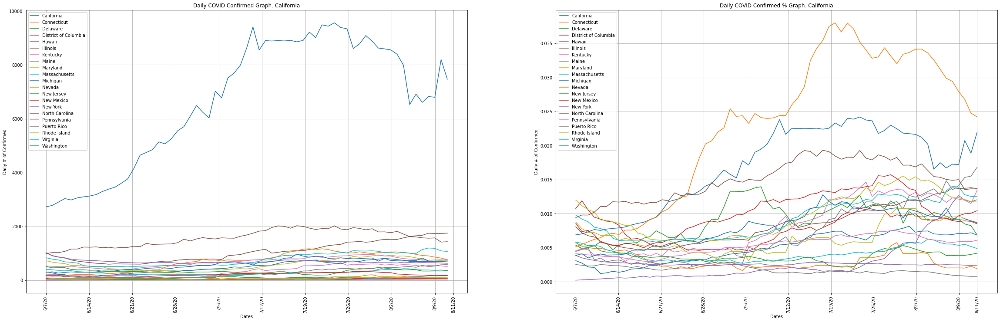

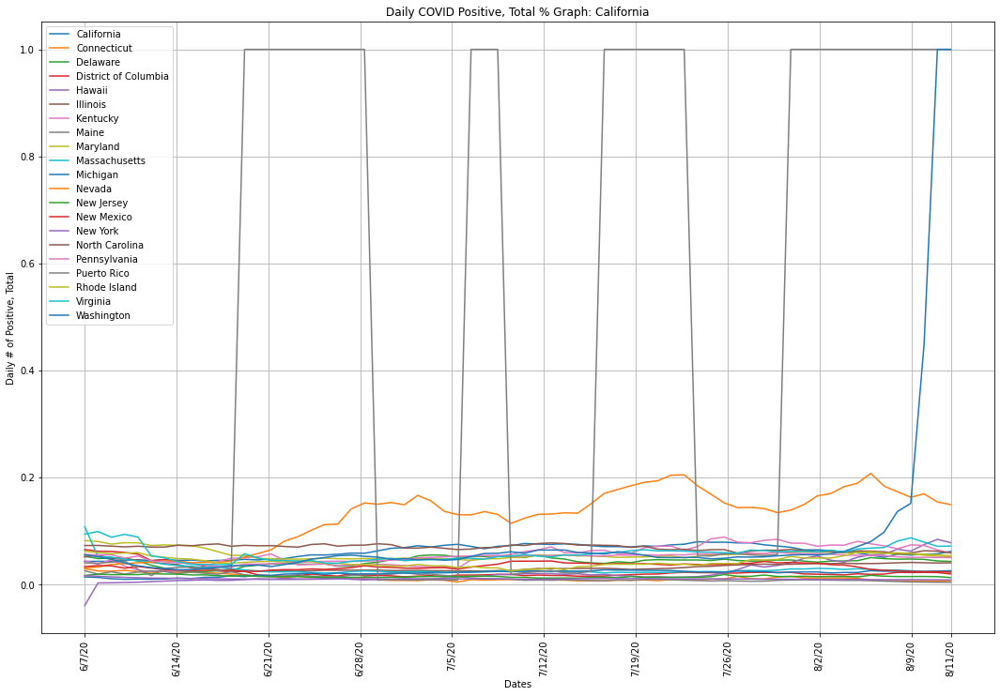

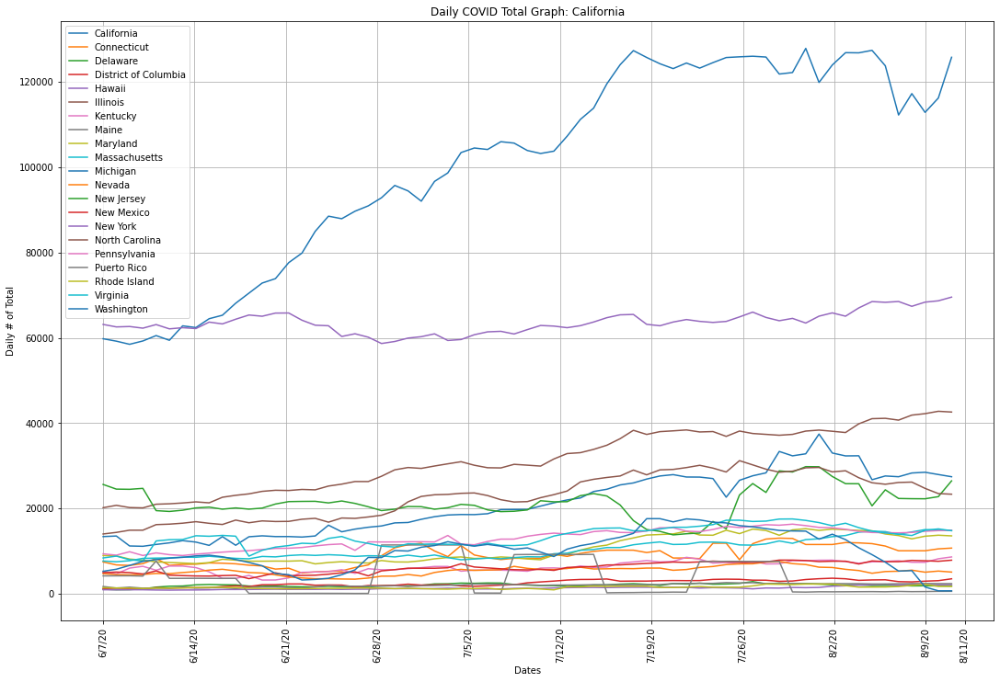

In [ ]:
# Graph of All States Confirmed

# Graph details
graph = 'Confirmed'
percent = ['no', 'yes']
window = 7
dates = ['6/1/20', '8/12/20']

states = [state for state in state_mask_mandates.keys() if state_mask_mandates[state] != None and state_mask_mandates[state][0] <= '6']
# states.remove('Washington')
# states.remove('Texas')

group_state_graph(2, graph, percent, states, window, dates)
test_group_state_graph(1, ['Positive', 'Total'], ['yes'], states, window, dates)
group_state_graph(1, 'Total', ['no'], states, window, dates)
# Redo labels
# ax.set_ylabel('# of Daily Cases')
# ax.set_title('Daily COVID Cases for States w/ July Mask Mandates')

# for state in states:
#     state_graph(state, window, 'all', 'diff', [1, [[graph]], ['no']], dates, 'no')

for state in states:
    print(state + ': ' + state_mask_mandates[state])

for state in states:
    if state in extra_mask_mandates.keys():
        print("Funky: " + state)

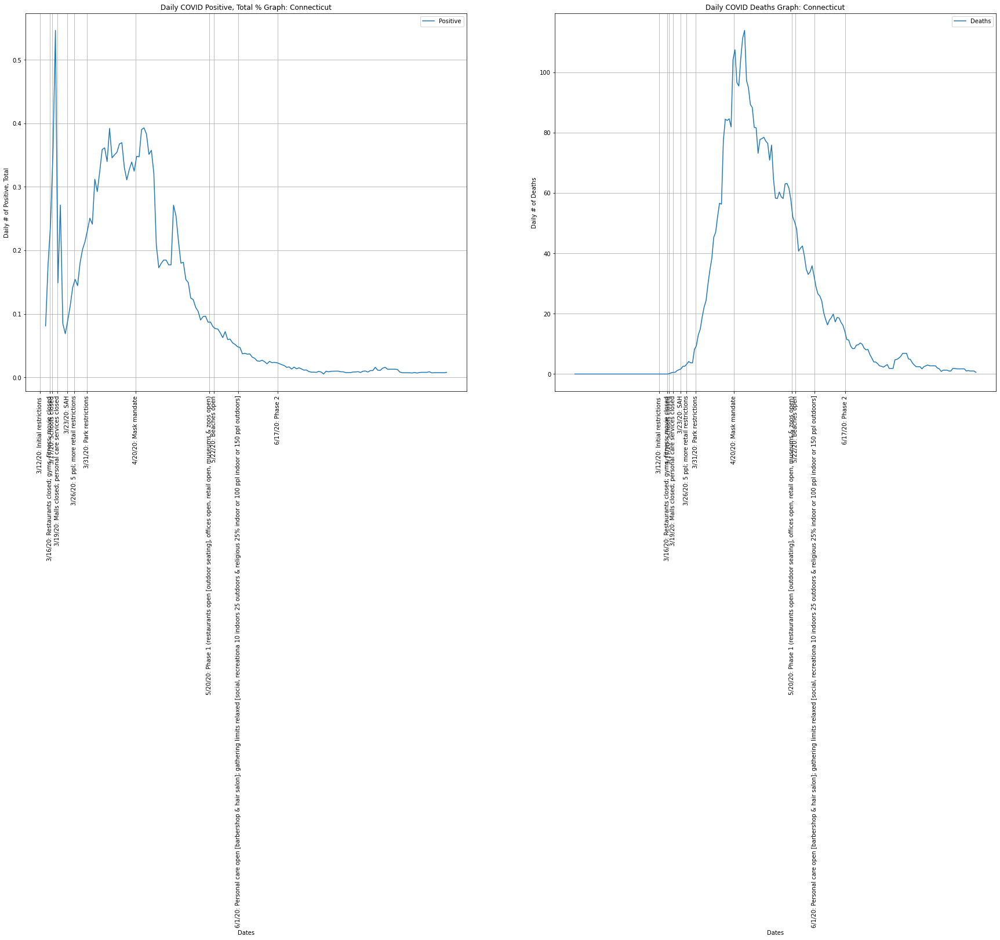

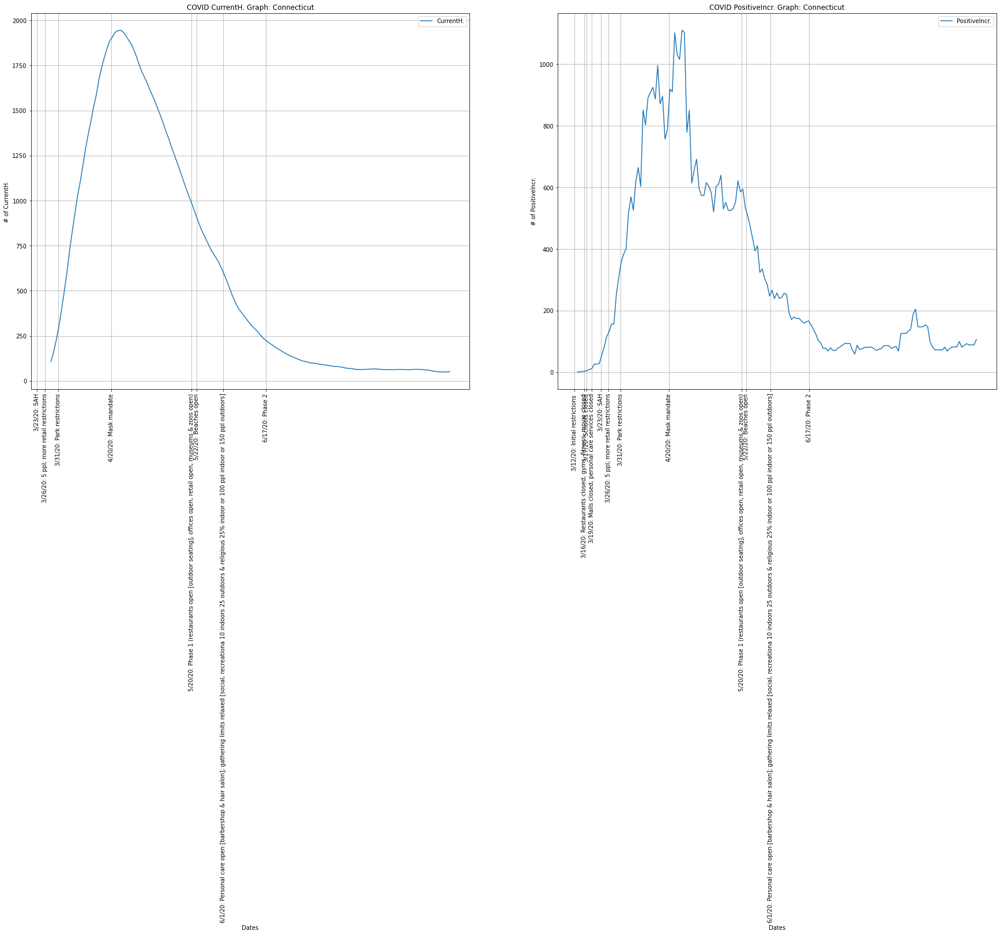

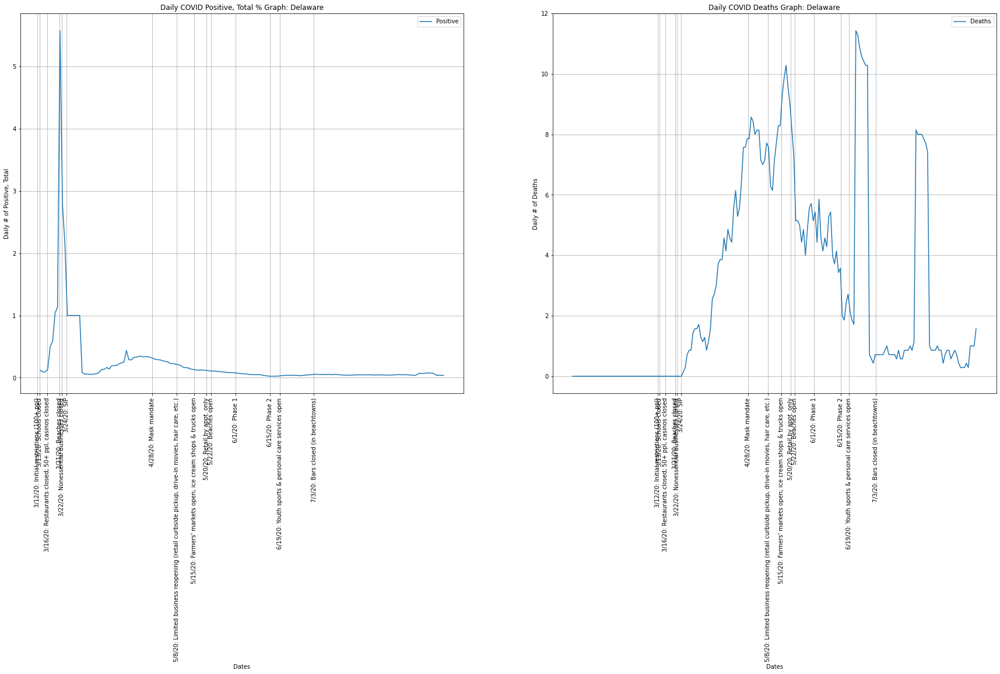

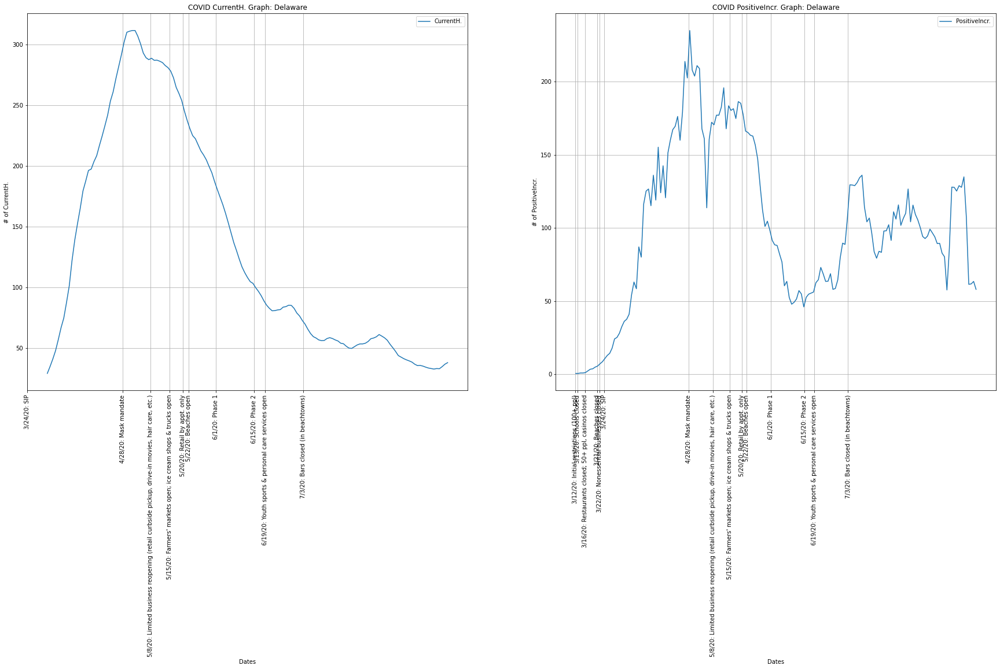

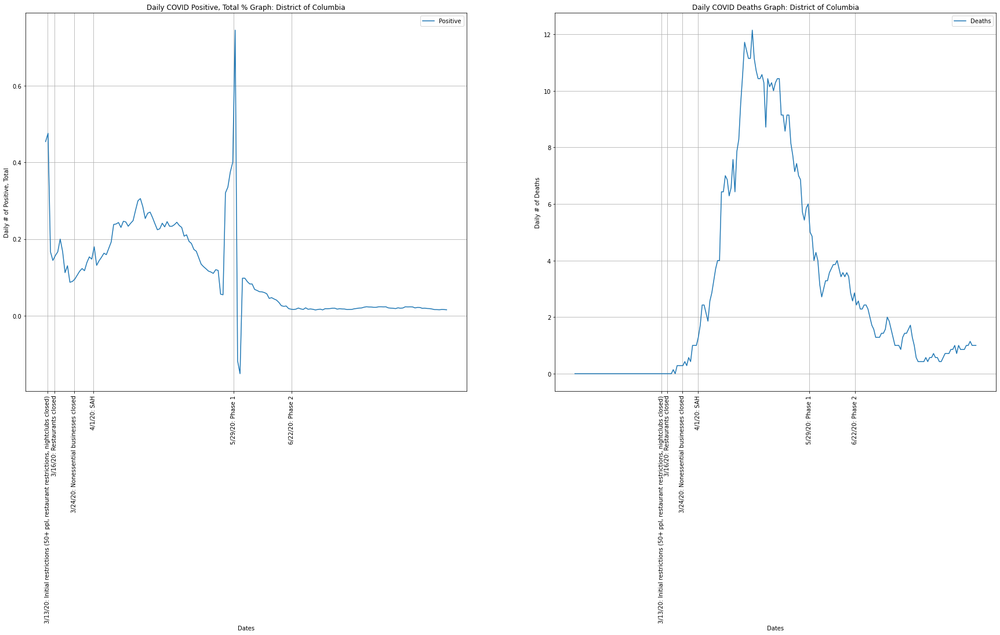

...

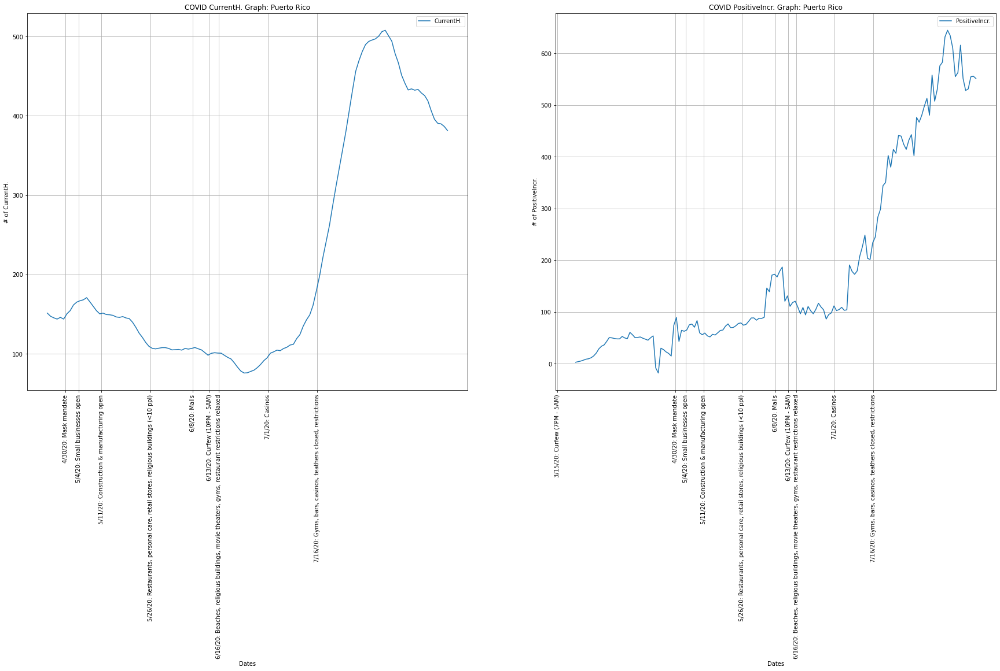

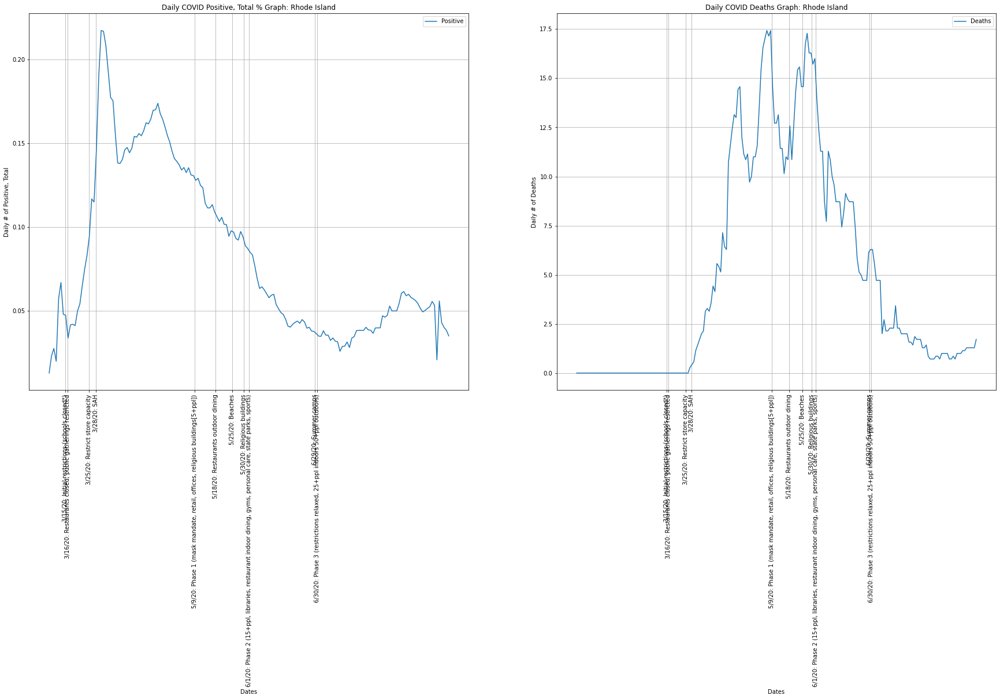

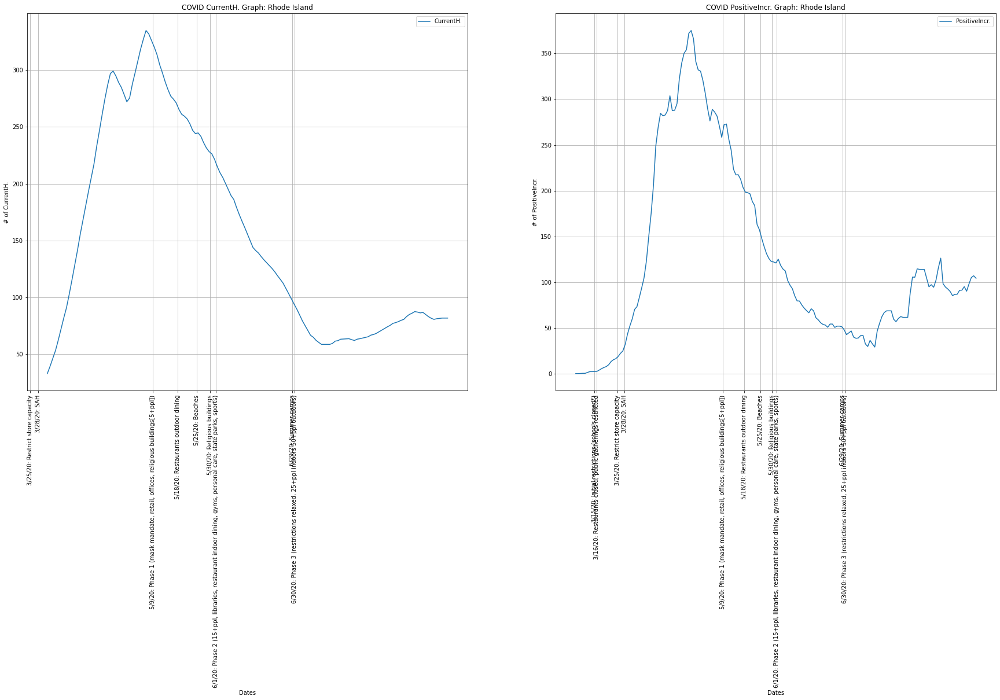

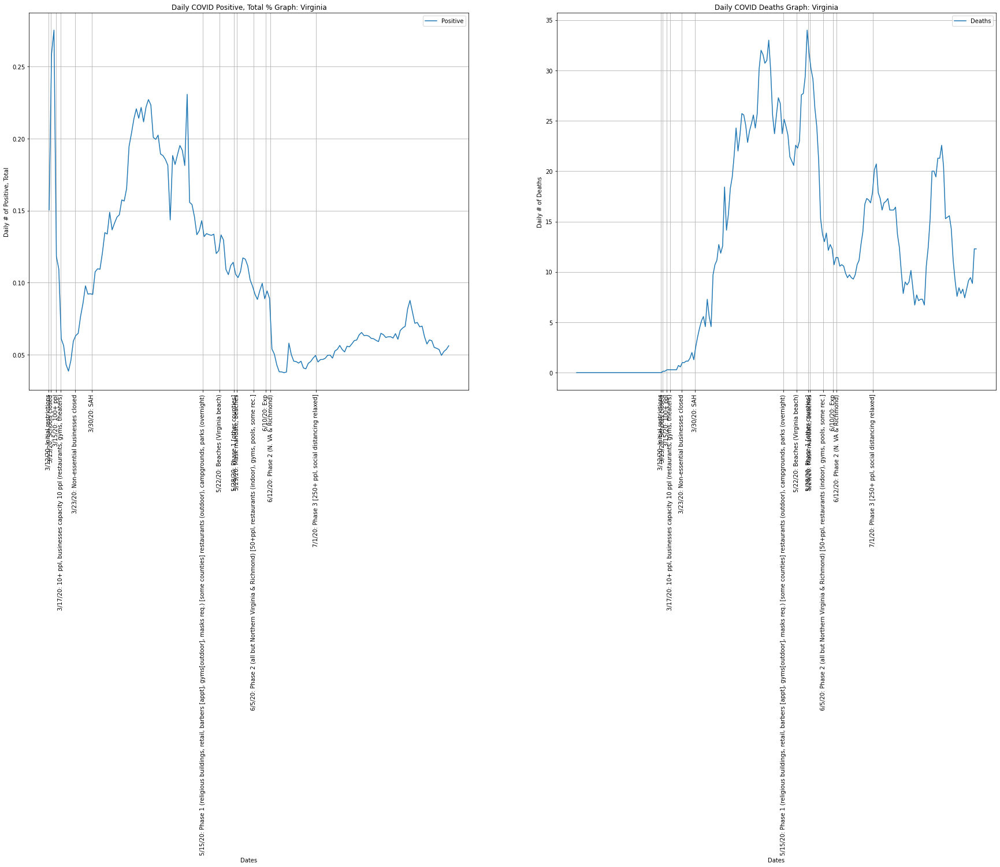

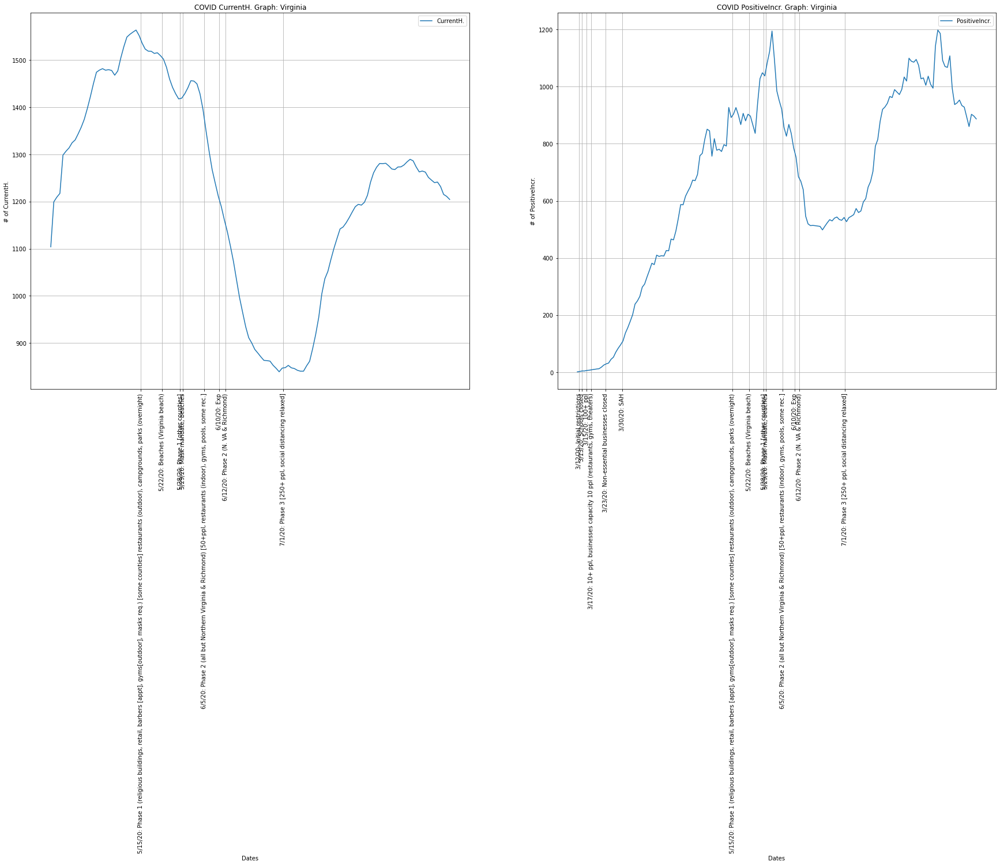

In [ ]:
states = ['Connecticut', 'Delaware', 'District of Columbia', 
          'Hawaii', 'Illinois', 'Kentucky', 'Maine', 'Maryland', 
          'Massachusetts',  'New Jersey', 'New Mexico', 'New York', 
          'Pennsylvania', 'Puerto Rico', 'Rhode Island', 'Virginia']

dates = 0

for state in states:
    # Graph Code
    graph = 2
    graph_types = [['Positive', 'Total'], ['Deaths'], ['CurrentH.'], ['PositiveIncr.']]
    percent = ['yes', 'no', 'no', 'no']
    data = [graph, graph_types[:2], percent[:2]]
    state_graph(state, 7, 'state_events', 'diff', data, dates, 'no')

    data = [graph, graph_types[2:], percent[2:]]
    state_graph(state, 7, 'state_events', 'linear', data, dates, 'no')

    """
    data = [1, [['PositiveIncr.']], ['no']]
    state_graph(state, 14, 'all', 'log', data, dates, 'no')
    """

#### Trends

"\n    if type(lag) == int:\n        # Plot lag grid\n        ax.plot(t[:-lag], plot[j][lag:], label = str(lag) + ' Day Lag Data')\n    elif lag == 'no':\n        pass\n    else:\n        raise ValueError('Invalid lag input')\n"

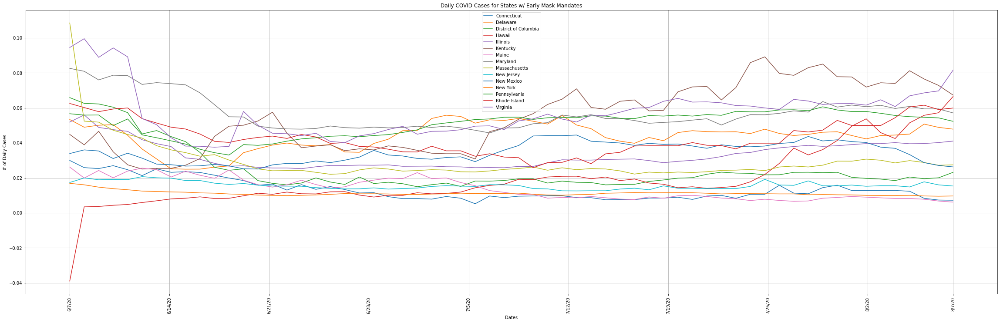

In [ ]:
# Graph of All States Confirmed
state = 'Kansas'
graph = ['Positive', 'Total']
percent = ['yes']
graph_type = 'diff'

states = ['Connecticut', 'Delaware', 'District of Columbia', 
          'Hawaii', 'Illinois', 'Kentucky', 'Maine', 'Maryland', 
          'Massachusetts',  'New Jersey', 'New Mexico', 'New York', 
          'Pennsylvania', 
          #'Puerto Rico', 
          'Rhode Island', 'Virginia']

window = 7

dates = ['6/1/20', '8/8/20']

# Graph of Early States's Confirmed
fig = plt.figure(figsize = (40, 12))

# Data cutoff
cutoff = cutoff_code(dates, state)

# Dates (do once)
dates, tick_loc, tick_labels = make_dates('all', window, state, cutoff)
t = np.linspace(0, len(dates), len(dates))

for i in range(1):
    # Graph details
    ax = graph_details(fig, state, i, 1, graph, percent[i], graph_type, tick_loc, tick_labels)

    for state in states:

        plot, scale = graph_func(graph, percent[i], state, graph_type, window, cutoff)

        ax.plot(t, plot[0], label = state)
        ax.set_yscale(scale)

        ax.grid(which = 'major')
        ax.legend()

    # Redo labels
    ax.set_ylabel('# of Daily Cases')
    ax.set_title('Daily COVID Cases for States w/ Early Mask Mandates')

"""
    if type(lag) == int:
        # Plot lag grid
        ax.plot(t[:-lag], plot[j][lag:], label = str(lag) + ' Day Lag Data')
    elif lag == 'no':
        pass
    else:
        raise ValueError('Invalid lag input')
"""

    

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:95: MatplotlibDeprecationWarning:

Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.



"\n    if type(lag) == int:\n        # Plot lag grid\n        ax.plot(t[:-lag], plot[j][lag:], label = str(lag) + ' Day Lag Data')\n    elif lag == 'no':\n        pass\n    else:\n        raise ValueError('Invalid lag input')\n"

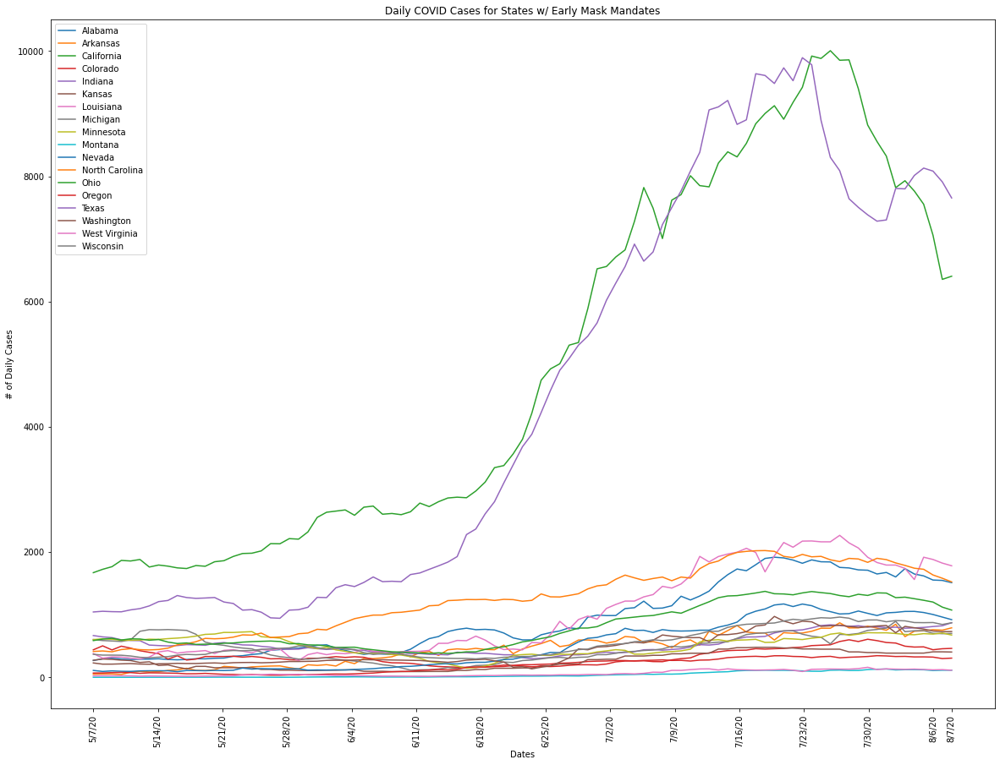

In [ ]:
state = 'Kansas'
graph = 'PositiveIncr.'

states = ['Alabama', 'Arkansas', 'California', 'Colorado', 'Indiana',
 'Kansas', 'Louisiana', 'Michigan', 'Minnesota', 'Montana', 'Nevada',
 'North Carolina', 'Ohio', 'Oregon', 'Texas', 'Washington', 'West Virginia',
 'Wisconsin']

window = 7

dates = ['5/1/20', '8/8/20']

# Graph of Early States's Confirmed
fig = plt.figure(figsize = (20, 15))
ax = fig.add_subplot()

# Data cutoff
cutoff = cutoff_code(dates, state)

# Dates (do once)
dates, tick_loc, tick_labels = make_dates('all', window, state, cutoff)
t = np.linspace(0, len(dates), len(dates))

# Graph details
ax = graph_details(fig, state, 0, 1, [graph], 'no', 'linear', tick_loc, tick_labels)

for state in states:

    plot, scale = graph_func([graph], 'no', state, 'linear', window, cutoff)

    ax.plot(t, plot[0], label = state)
    ax.set_yscale(scale)

    ax.grid(which = 'major')
    ax.legend()

# Redo labels
ax.set_ylabel('# of Daily Cases')
ax.set_title('Daily COVID Cases for States w/ Early Mask Mandates')

"""
    if type(lag) == int:
        # Plot lag grid
        ax.plot(t[:-lag], plot[j][lag:], label = str(lag) + ' Day Lag Data')
    elif lag == 'no':
        pass
    else:
        raise ValueError('Invalid lag input')
"""

    

### Late Mask Mandate (June 1st -)

California: 6/18/20
Michigan: 6/18/20
Nevada: 6/24/20
North Carolina: 6/26/20
Washington: 6/26/20
Funky: Michigan


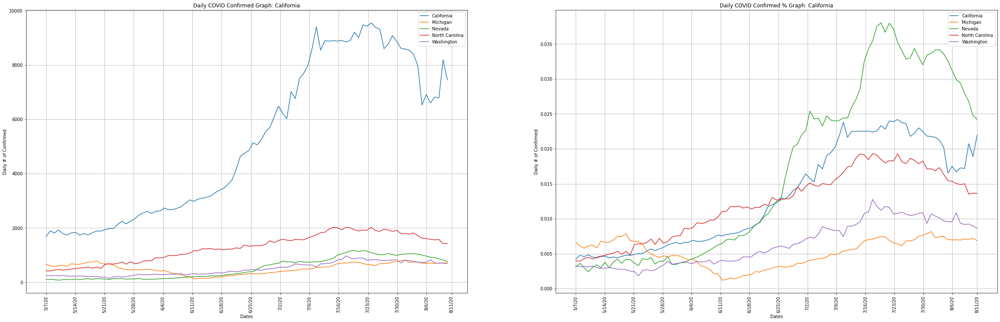

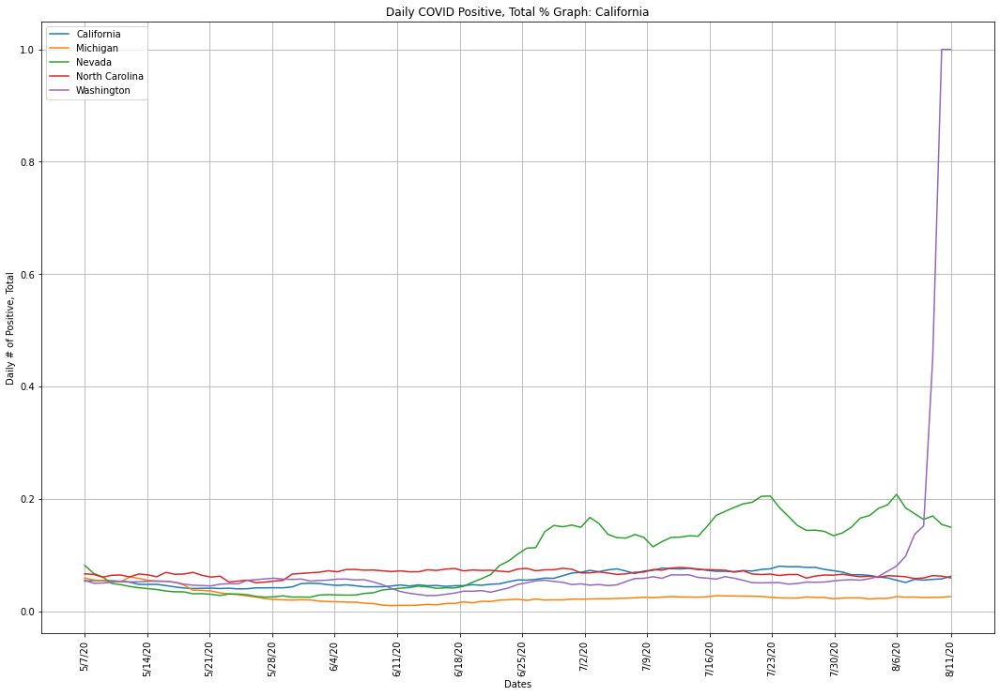

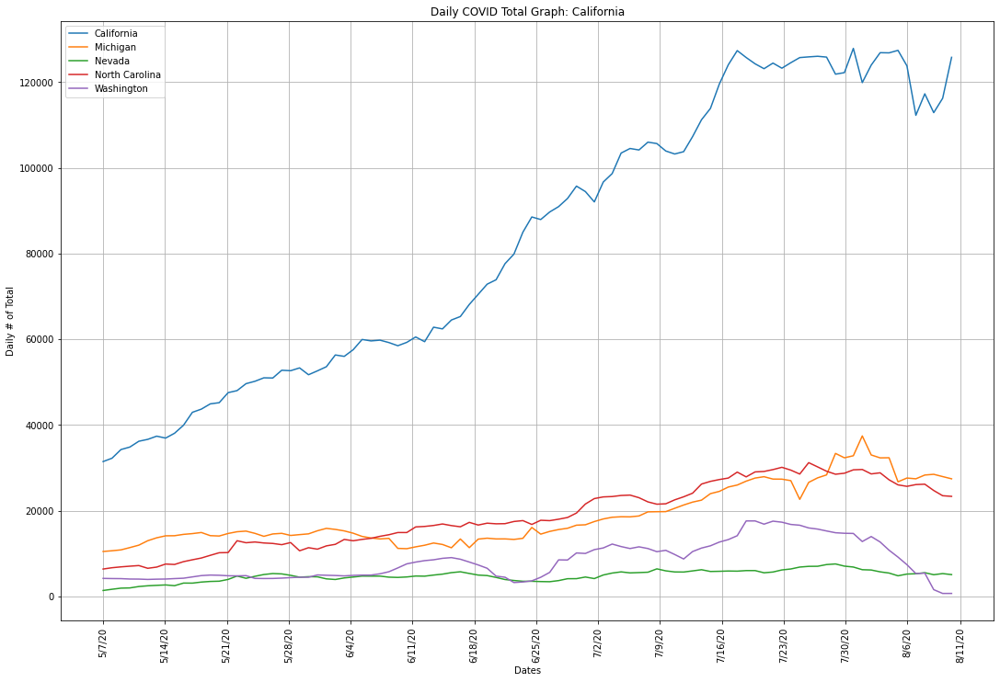

In [ ]:
# Graph of All States Confirmed

# Graph details
graph = 'Confirmed'
percent = ['no', 'yes']
window = 7
dates = ['5/1/20', '8/12/20']

states = [state for state in state_mask_mandates.keys() if state_mask_mandates[state] != None and state_mask_mandates[state][0] == '6']
# states.remove('Alabama')
# states.remove('Texas')

group_state_graph(2, graph, percent, states, window, dates)
test_group_state_graph(1, ['Positive', 'Total'], ['yes'], states, window, dates)
group_state_graph(1, 'Total', ['no'], states, window, dates)
# Redo labels
# ax.set_ylabel('# of Daily Cases')
# ax.set_title('Daily COVID Cases for States w/ July Mask Mandates')

# for state in states:
#     state_graph(state, window, 'all', 'diff', [1, [[graph]], ['no']], dates, 'no')

for state in states:
    print(state + ': ' + state_mask_mandates[state])

for state in states:
    if state in extra_mask_mandates.keys():
        print("Funky: " + state)

Alabama: 7/16/20
Arkansas: 7/20/20
Colorado: 7/17/20
Indiana: 7/27/20
Kansas: 7/3/20
Louisiana: 7/13/20
Minnesota: 7/25/20
Montana: 7/16/20
Ohio: 7/23/20
Oregon: 7/1/20
West Virginia: 7/6/20
Funky: Kansas


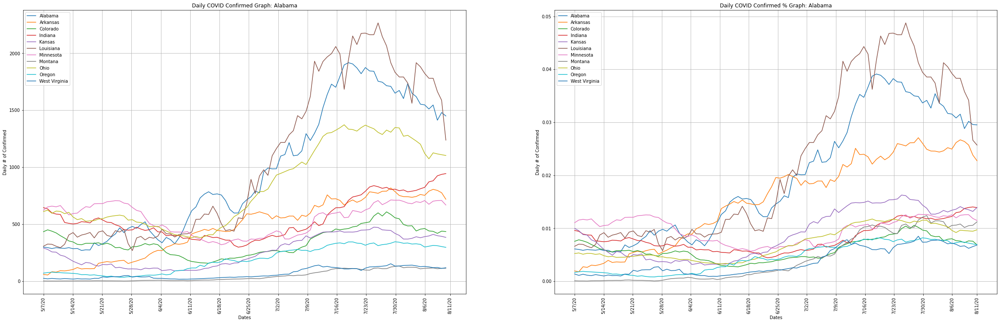

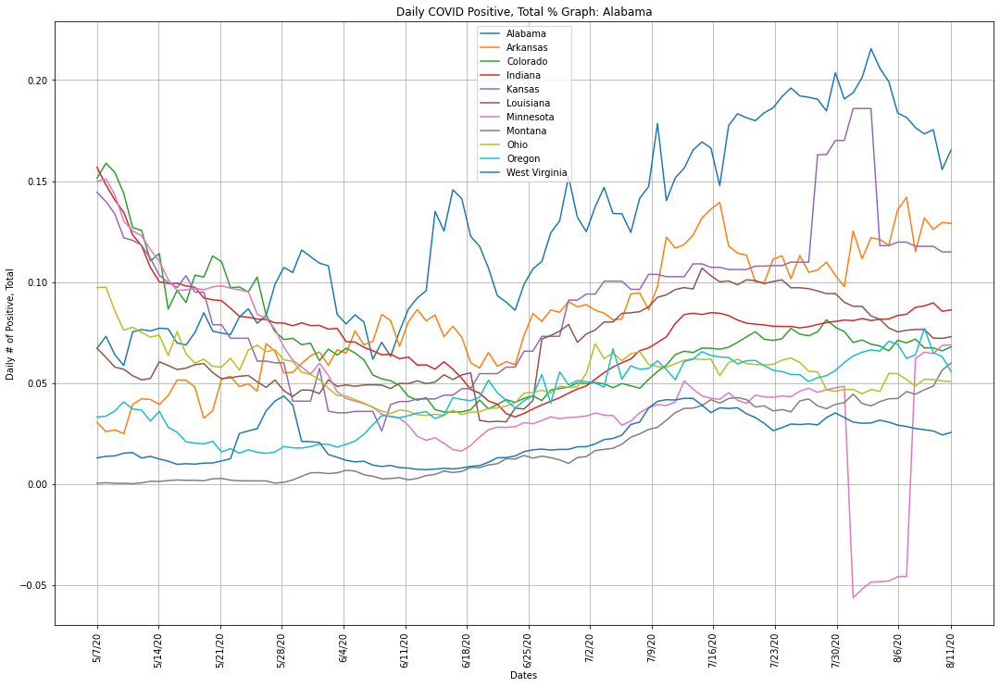

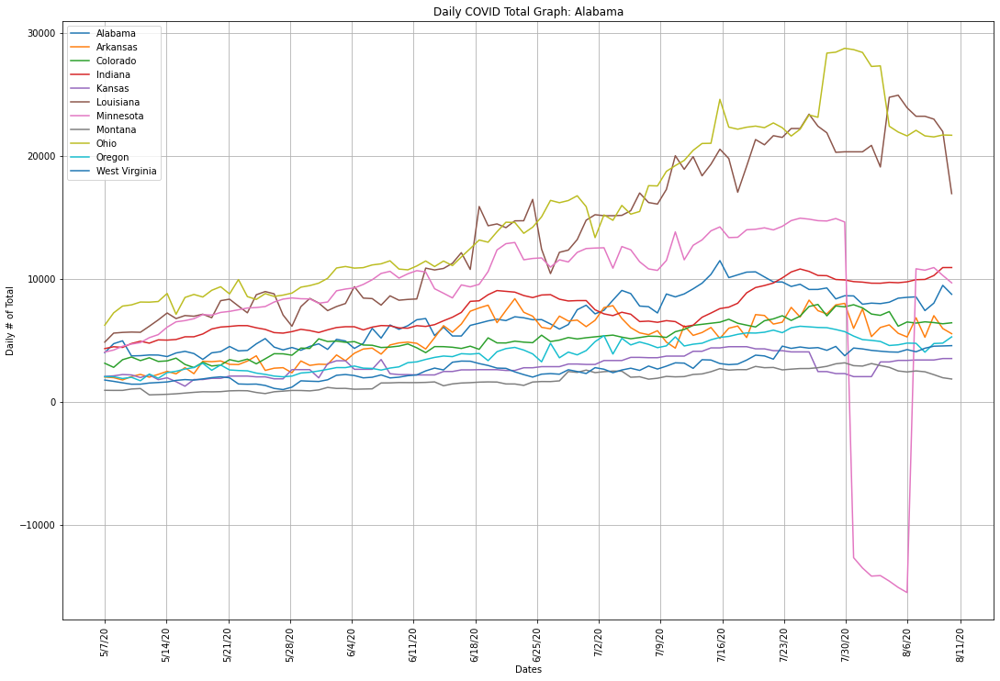

In [ ]:
# Graph of All States Confirmed

# Graph details
graph = 'Confirmed'
percent = ['no', 'yes']
window = 7
dates = ['5/1/20', '8/12/20']

states = [state for state in state_mask_mandates.keys() if state_mask_mandates[state] != None and state_mask_mandates[state][0] == '7']
# states.remove('Alabama')
states.remove('Texas')

group_state_graph(2, graph, percent, states, window, dates)
test_group_state_graph(1, ['Positive', 'Total'], ['yes'], states, window, dates)
group_state_graph(1, 'Total', ['no'], states, window, dates)
# Redo labels
# ax.set_ylabel('# of Daily Cases')
# ax.set_title('Daily COVID Cases for States w/ July Mask Mandates')

# for state in states:
#     state_graph(state, window, 'all', 'diff', [1, [[graph]], ['no']], dates, 'no')

for state in states:
    print(state + ': ' + state_mask_mandates[state])

for state in states:
    if state in extra_mask_mandates.keys():
        print("Funky: " + state)

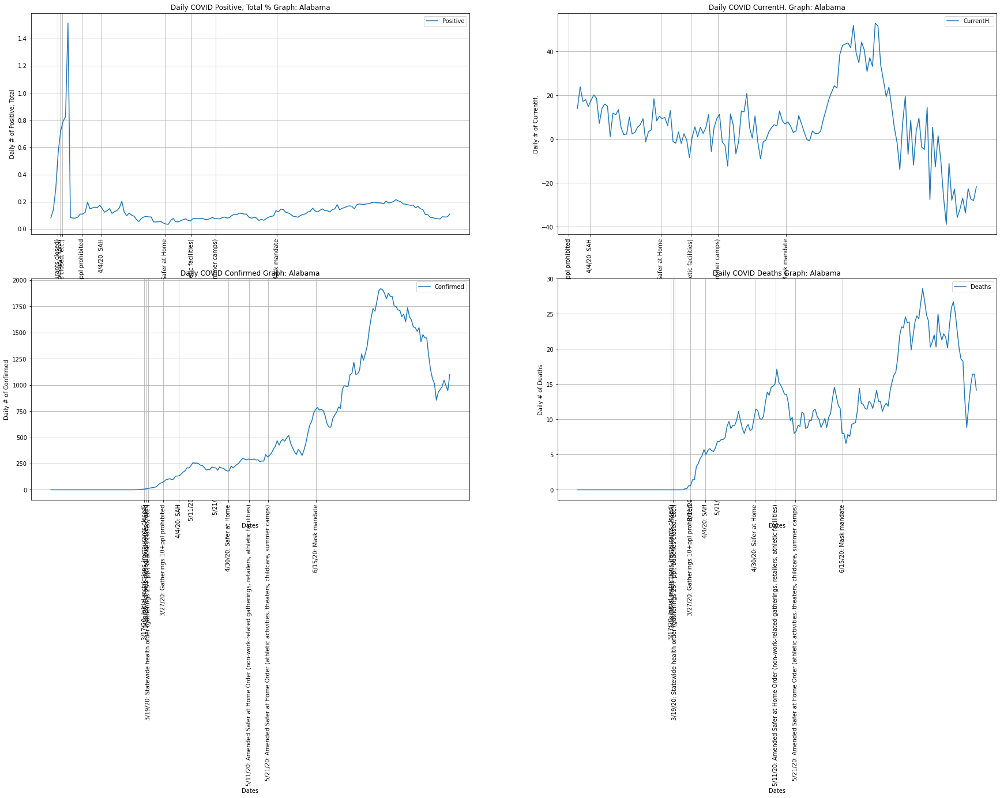

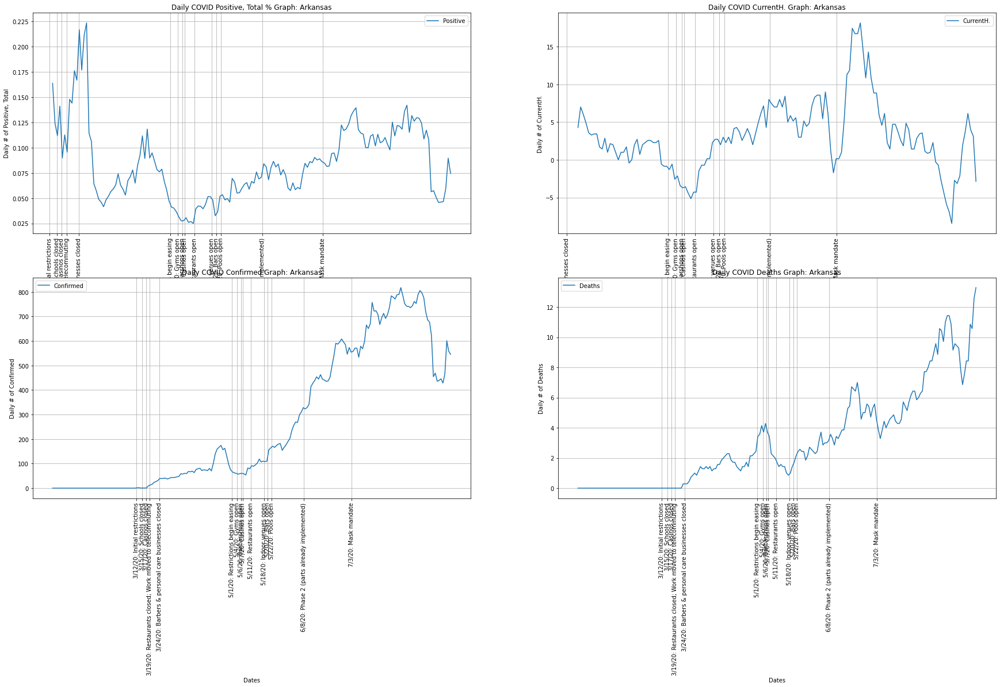

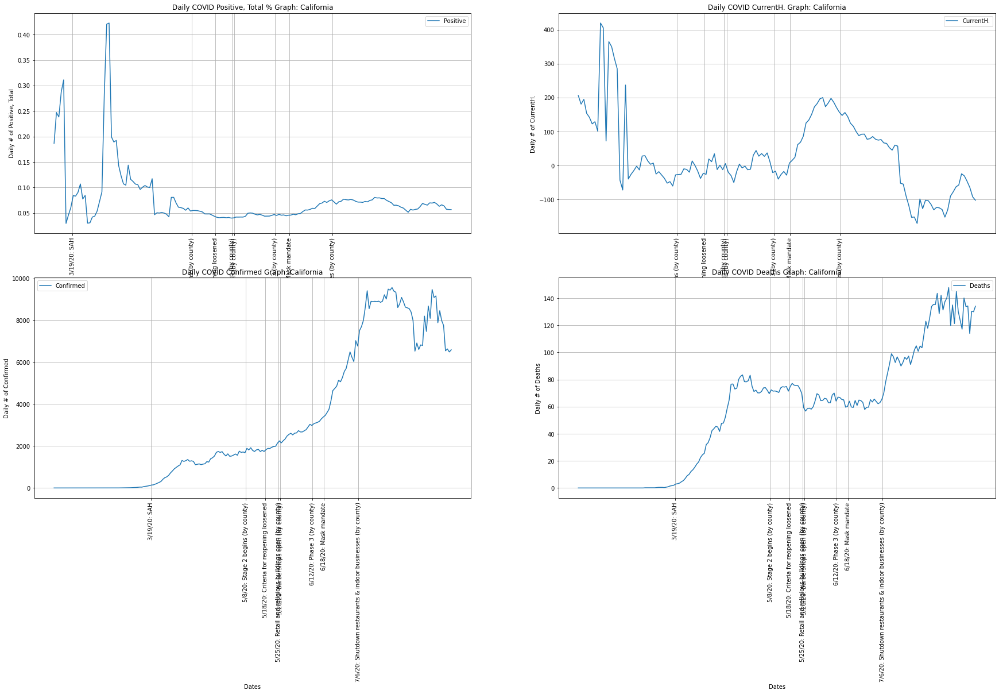

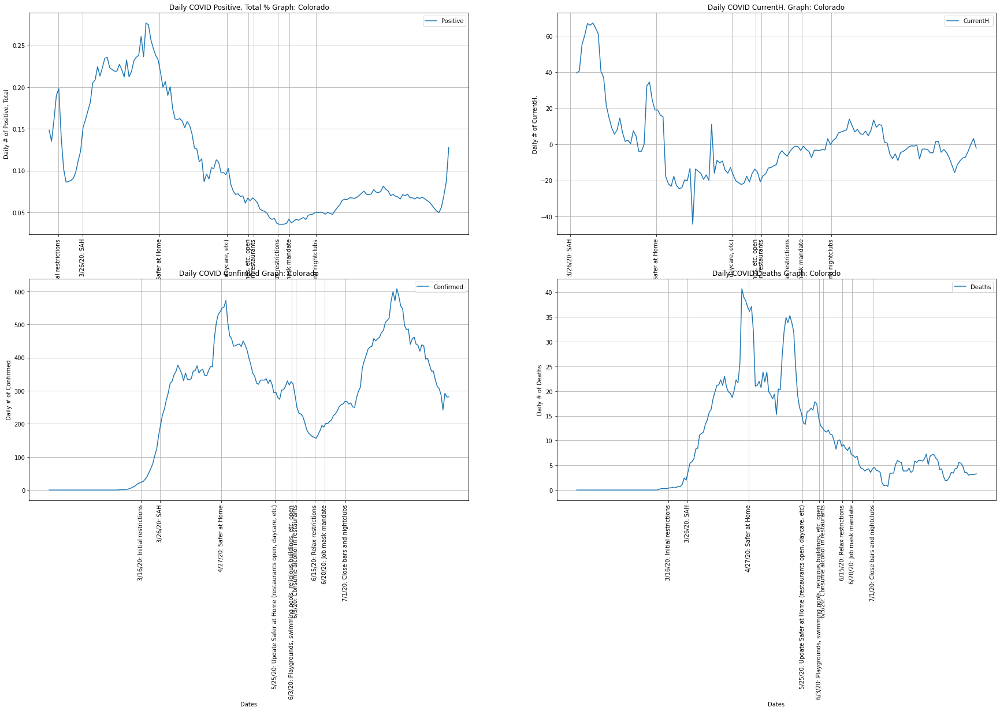

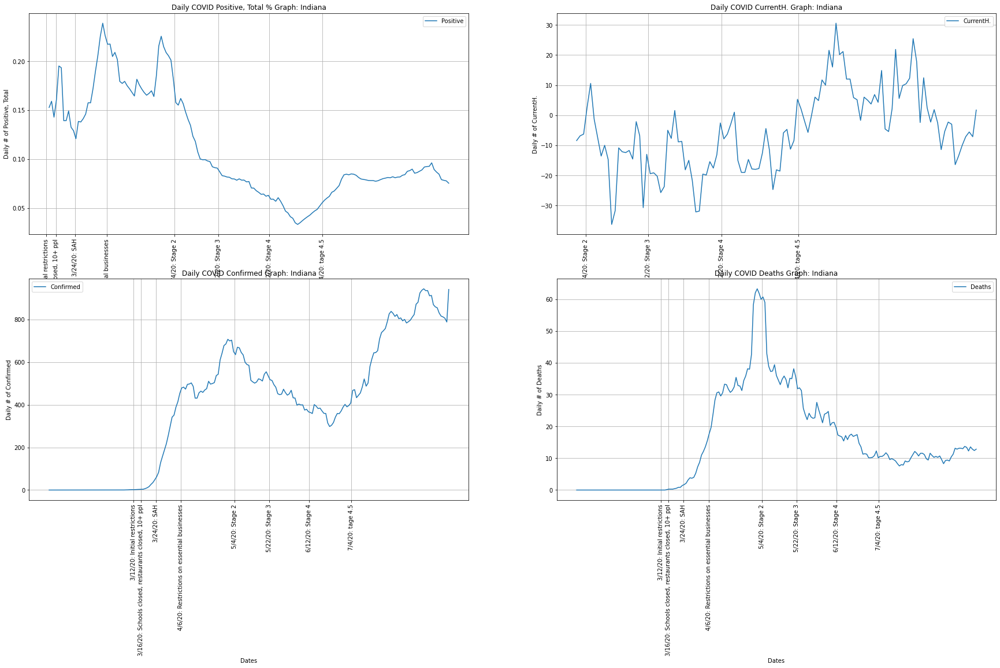

...

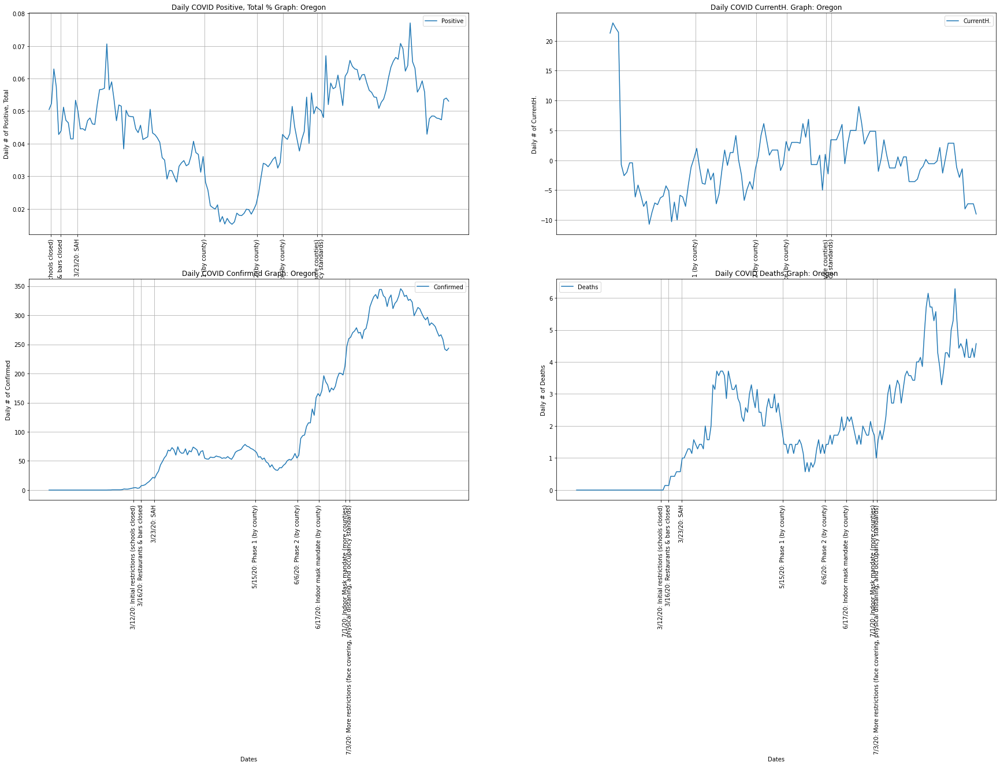

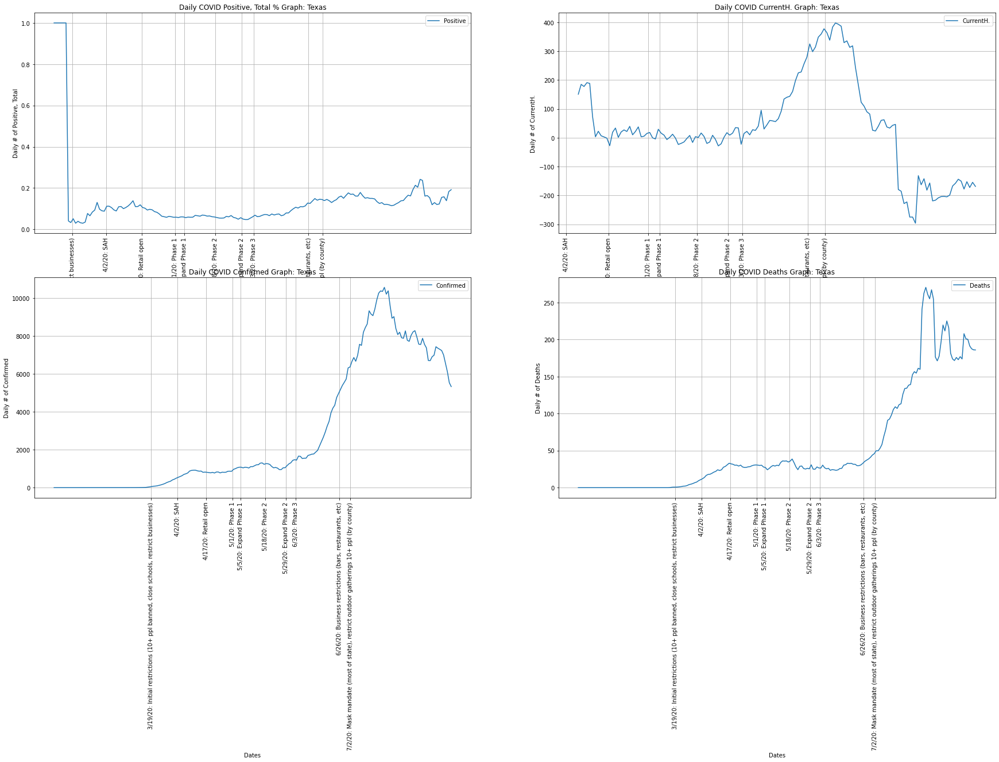

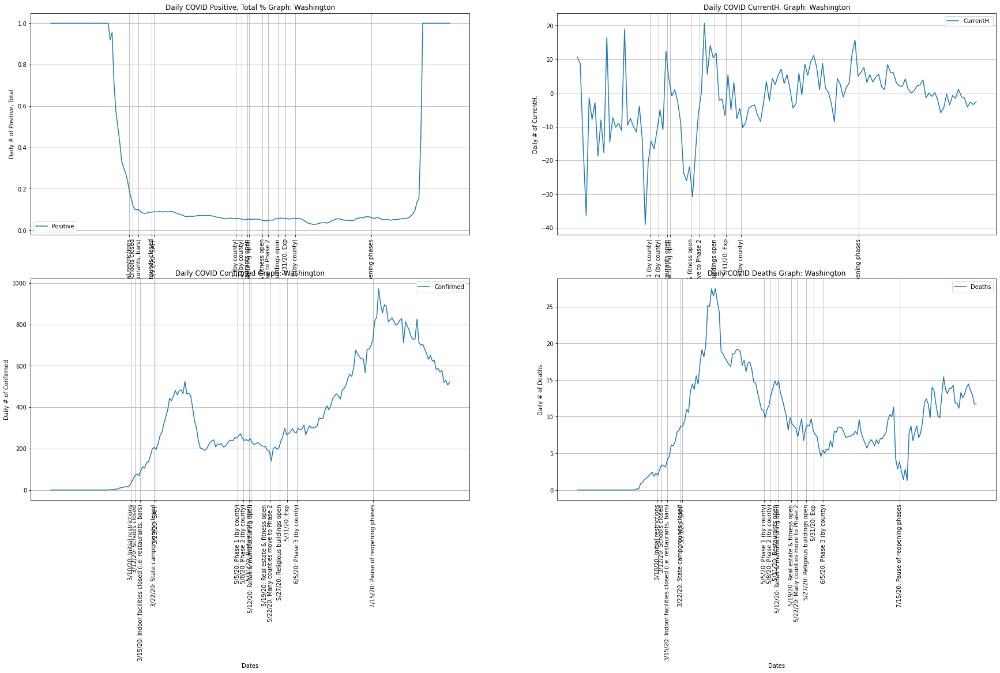

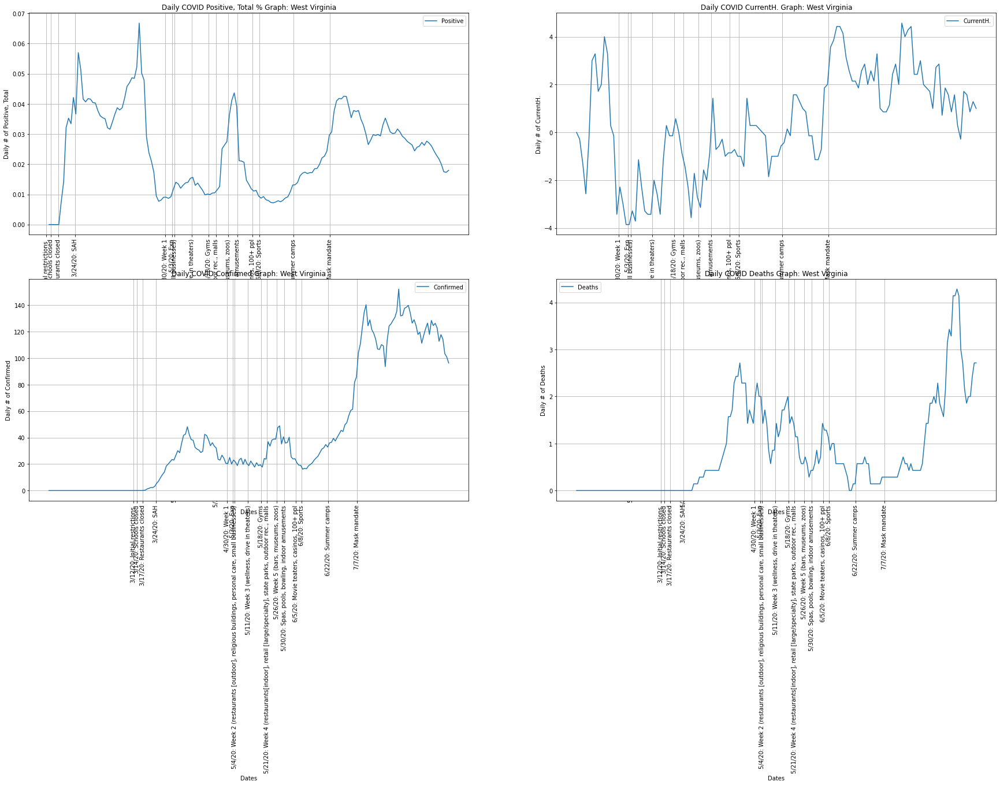

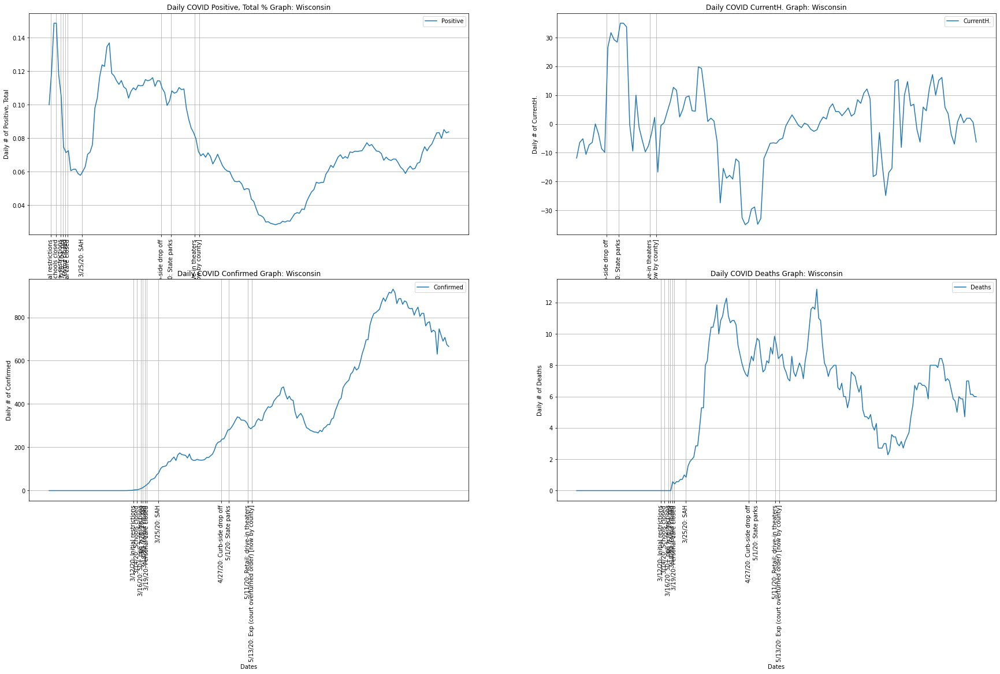

In [ ]:
states = ['Alabama', 'Arkansas', 'California', 'Colorado', 'Indiana',
 'Kansas', 'Louisiana', 'Michigan', 'Minnesota', 'Montana', 'Nevada',
 'North Carolina', 'Ohio', 'Oregon', 'Texas', 'Washington', 'West Virginia',
 'Wisconsin']

dates = 0

for state in states:
    # """
    # Graph Code
    graph = 4
    graph_types = [['Positive', 'Total'], ['CurrentH.'], ['Confirmed'], ['Deaths']]
    percent = ['yes', 'no', 'no', 'no']
    data = [graph, graph_types, percent]
    state_graph(state, 7, 'state_events', 'diff', data, dates, 'no')
    """
    data = [1, [['PositiveIncr.']], ['no']]
    state_graph(state, 14, 'all', 'log', data, dates, 'no')
    """

### No Mask Mandate

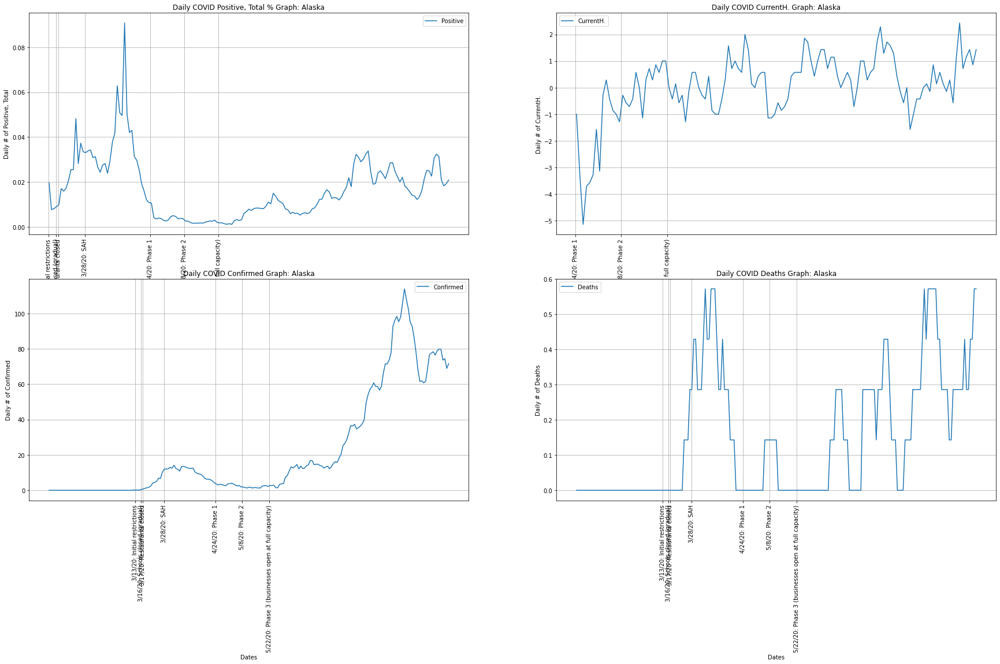

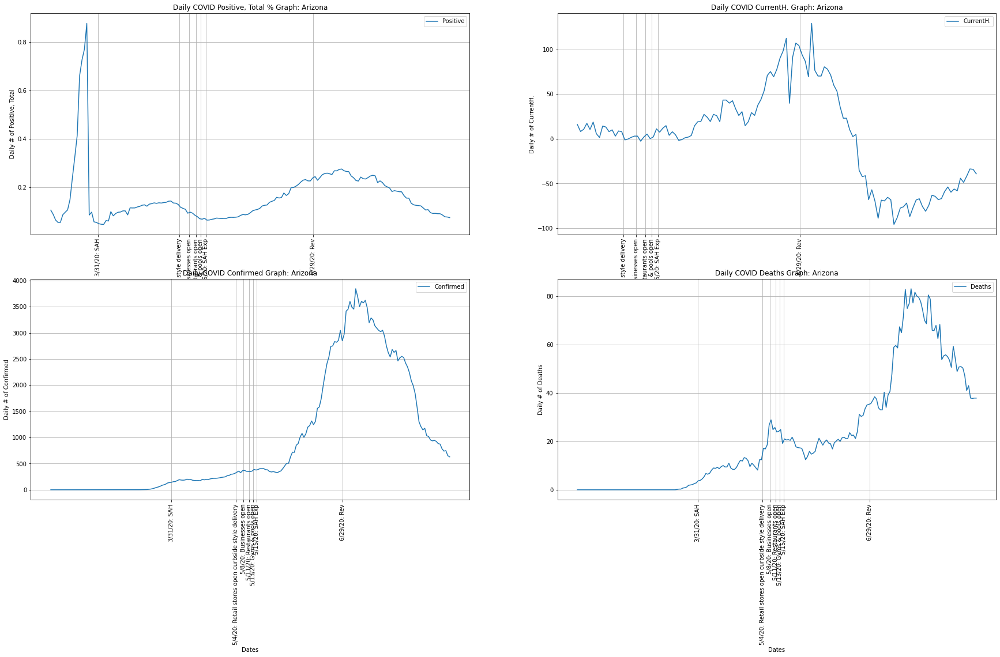

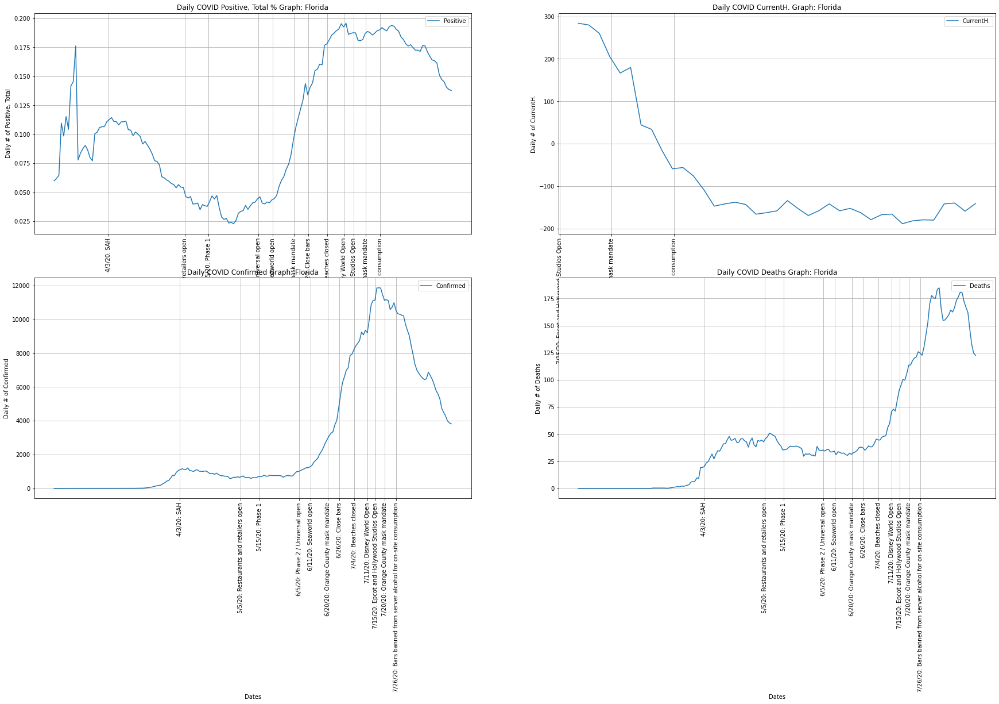

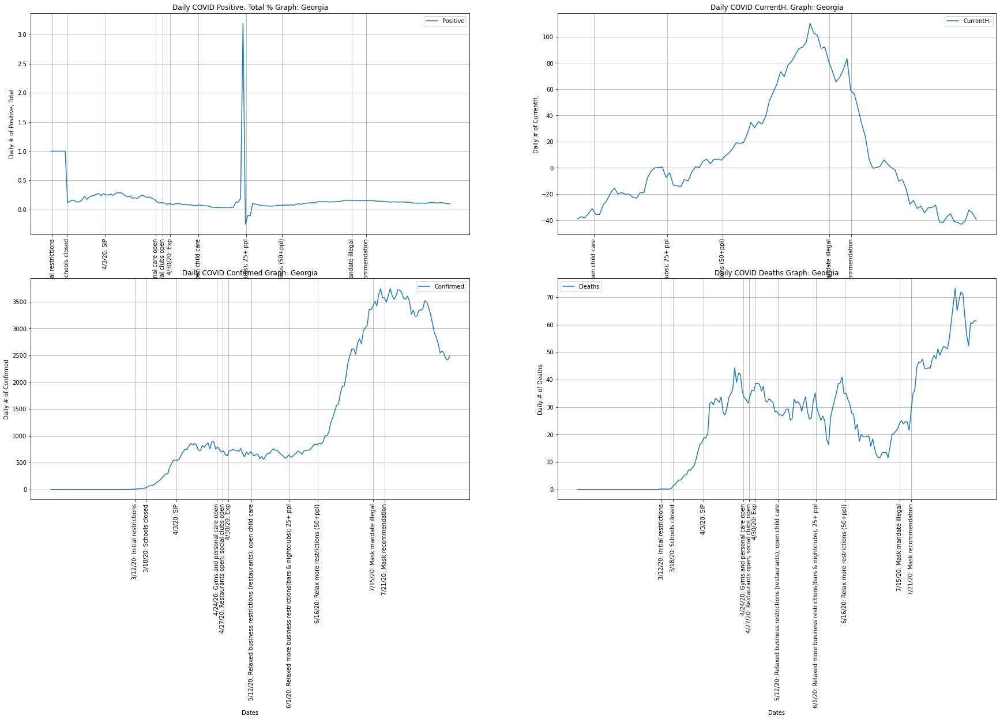

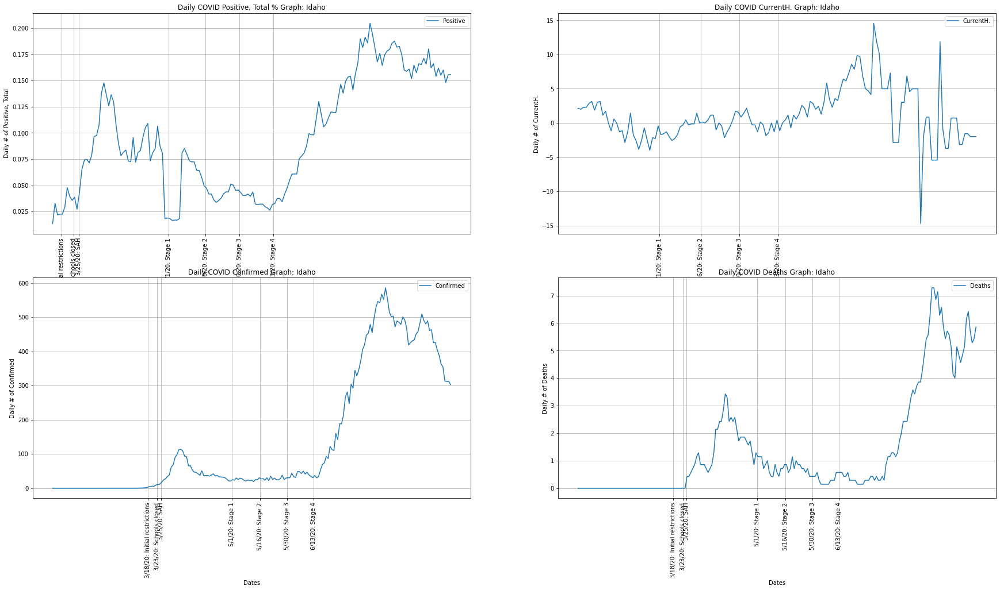

...

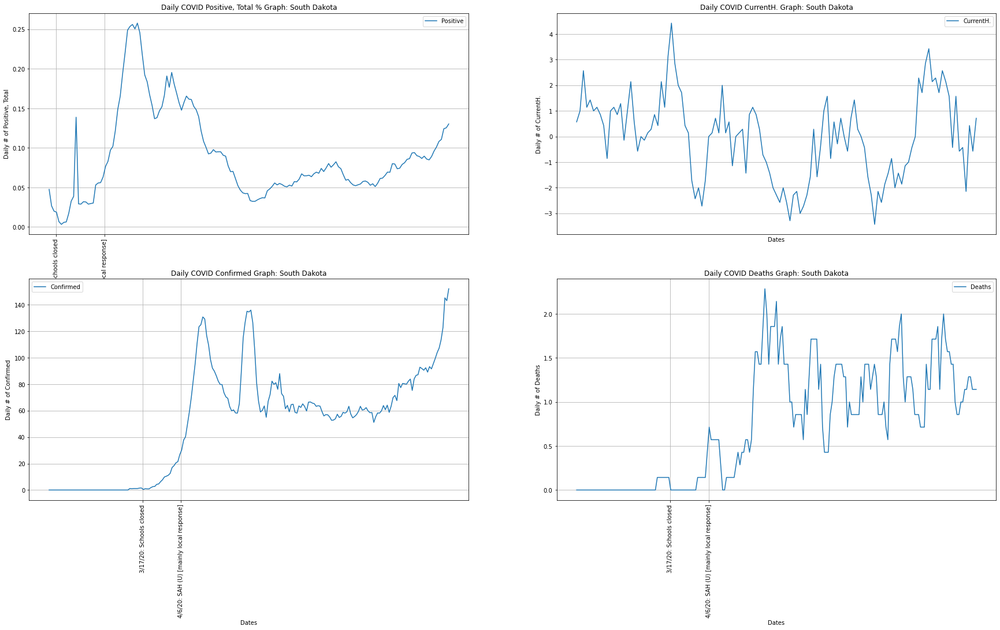

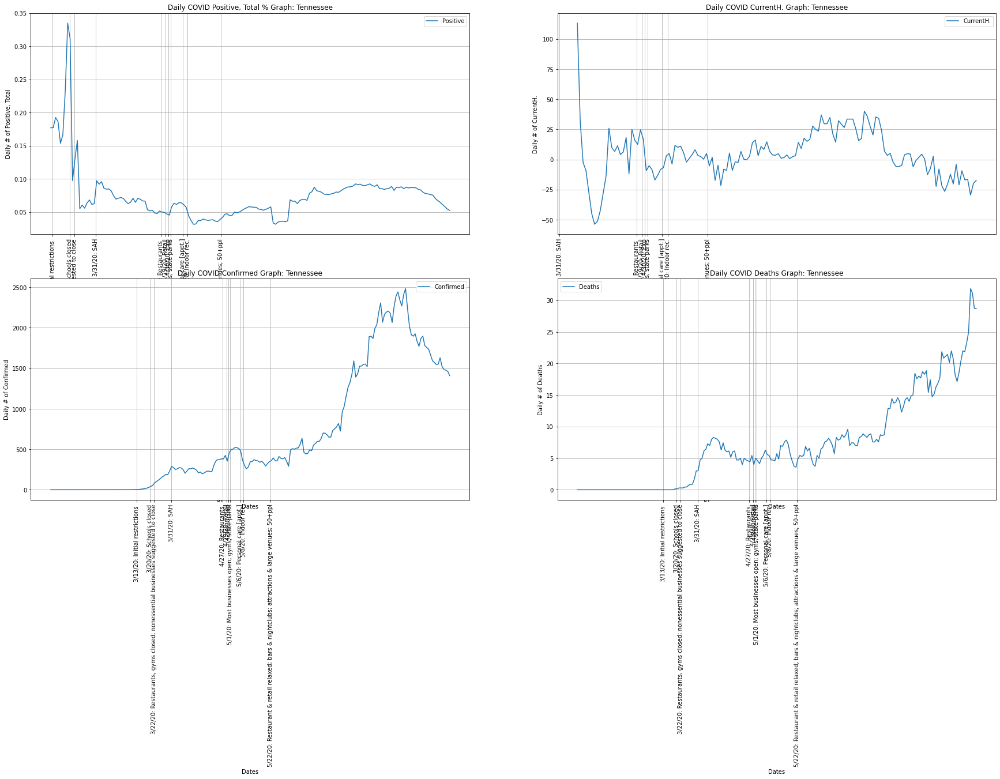

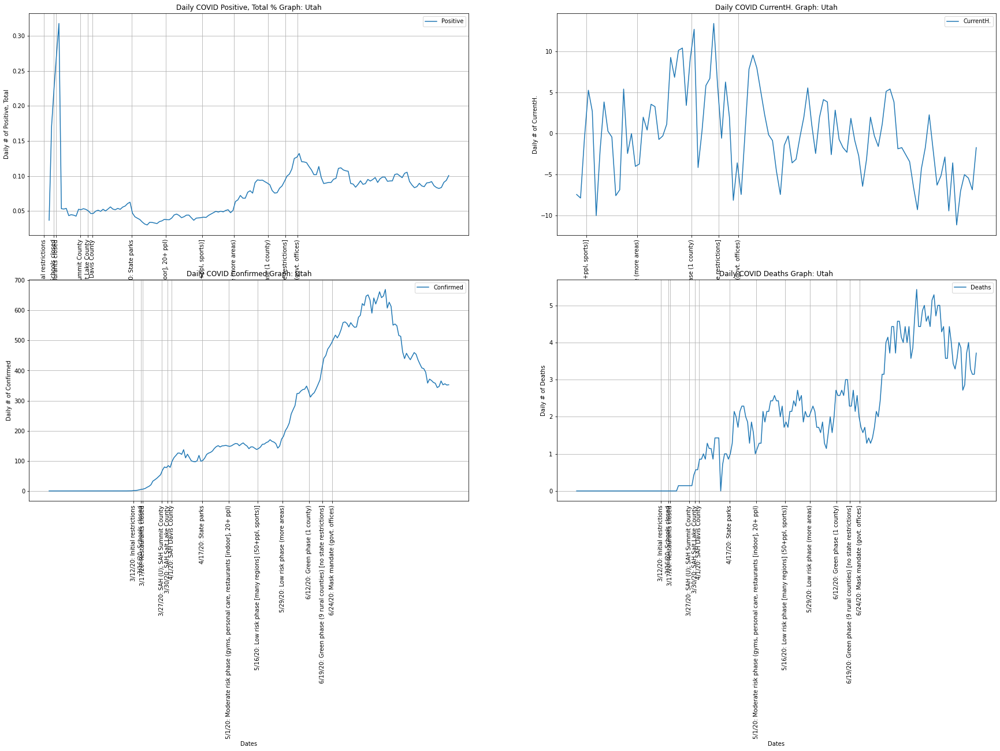

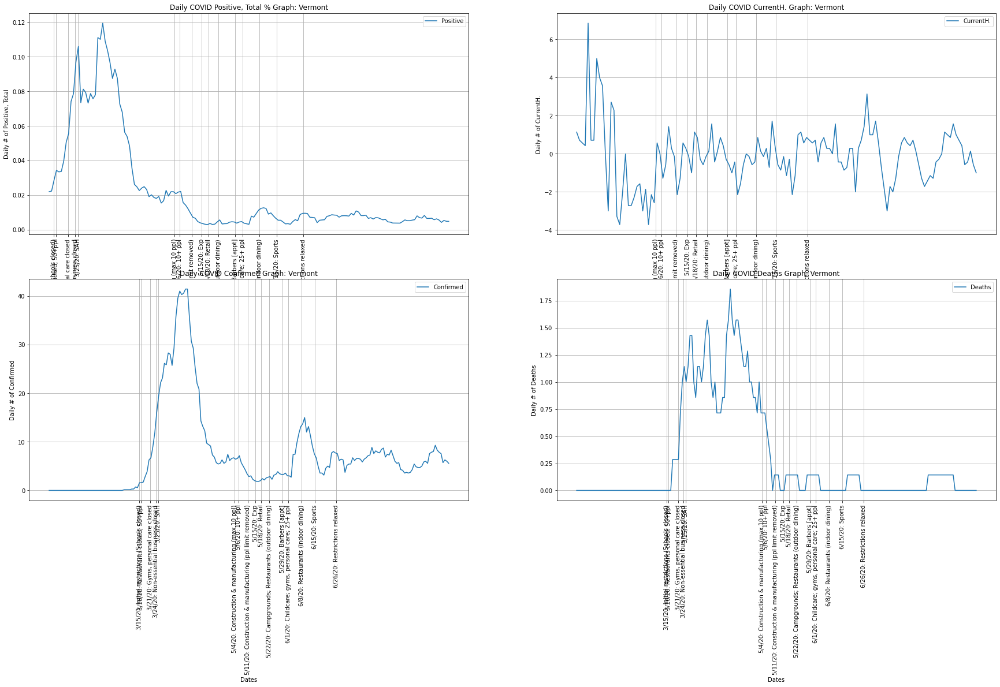

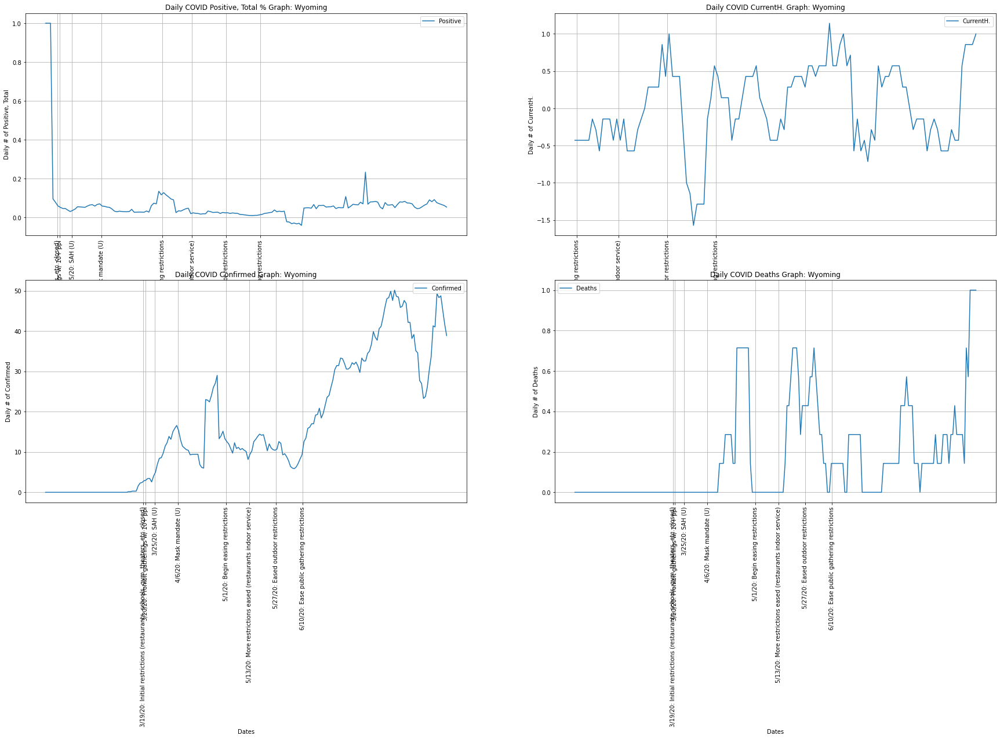

In [ ]:
states = ['Alaska',
 'Arizona',
 'Florida',
 'Georgia',
 'Idaho',
 'Iowa',
 'Kentucky',
 'Mississippi',
 'Missouri',
 'Nebraska',
 'New Hampshire',
 'North Dakota',
 'Oklahoma',
 'South Carolina',
 'South Dakota',
 'Tennessee',
 'Utah',
 'Vermont',
 'Wyoming']

dates = 0

for state in states:
    # """
    # Graph Code
    graph = 4
    graph_types = [['Positive', 'Total'], ['CurrentH.'], ['Confirmed'], ['Deaths']]
    percent = ['yes', 'no', 'no', 'no']
    data = [graph, graph_types, percent]
    state_graph(state, 7, 'state_events', 'diff', data, dates, 'no')

    """
    data = [1, [['PositiveIncr.']], ['no']]
    state_graph(state, 14, 'all', 'log', data, dates, 'no')
    """


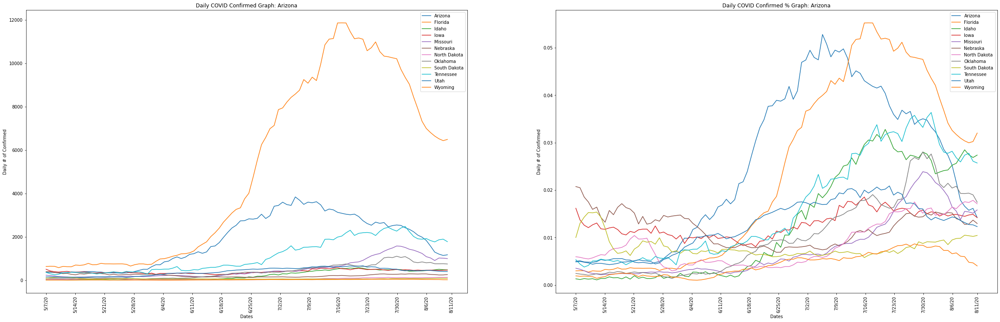

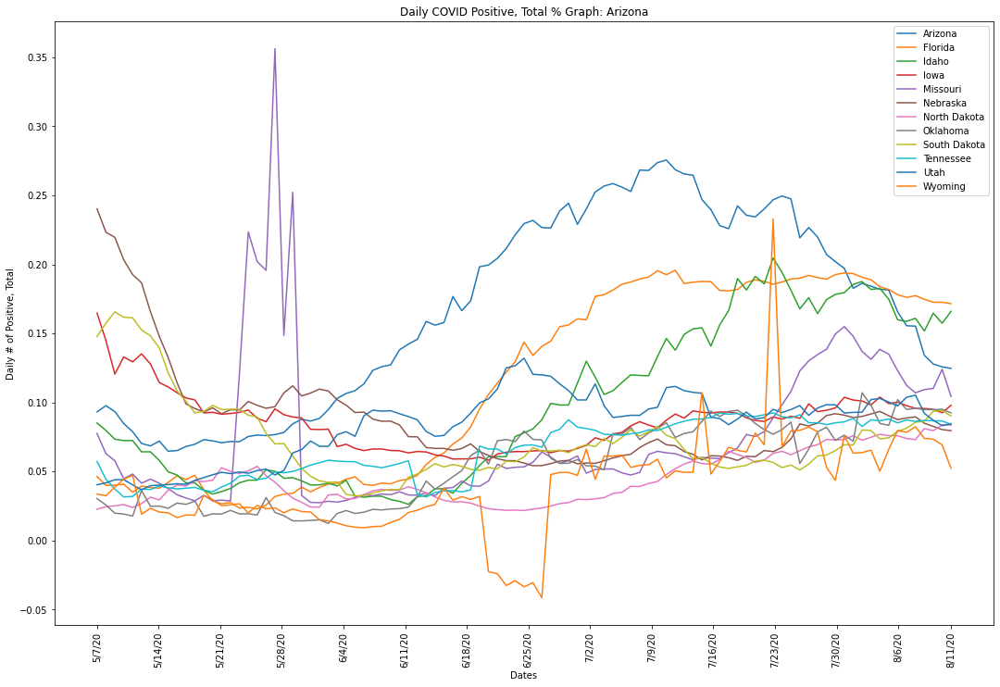

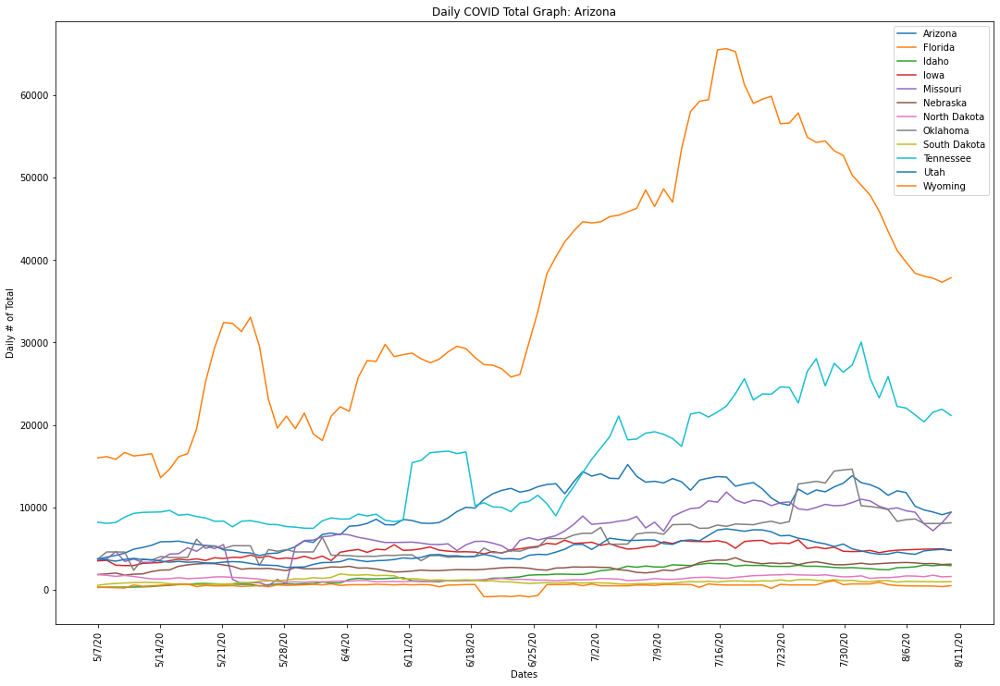

In [ ]:
# No Mask Mandate

# Graph details
graph = 'Confirmed'
percent = ['no', 'yes']
window = 7
dates = ['5/1/20', '8/12/20']

states = [state for state in state_mask_mandates.keys() if state_mask_mandates[state] == None]
states.remove('Alaska')
states.remove('Georgia')
states.remove('South Carolina')

group_state_graph(2, graph, percent, states, window, dates)
test_group_state_graph(1, ['Positive', 'Total'], ['yes'], states, window, dates)
group_state_graph(1, 'Total', ['no'], states, window, dates)
# Redo labels

# ax.set_ylabel('# of Daily Cases')
# ax.set_title('Daily COVID Cases for States w/ July Mask Mandates')

# for state in states:
#     state_graph(state, window, 'all', 'diff', [1, [[graph]], ['no']], dates, 'no')




# Interesting Trends


## TX, FL, NE

In [ ]:
states = ['Texas', 'Florida', 'Nevada']

# State Restrictions
state_restrictions = dict()

# Texas
state_restrictions['6/20/20'] = 'TX: Bars closed'
state_restrictions['7/2/20'] = 'TX: Mask mandate (most of state)'

# Florida
state_restrictions['6/26/20'] = 'FL: Bars closed'
state_restrictions['7/4/20'] = 'FL: Beaches Closed'

# Nevada
state_restrictions['6/24/20'] = 'NV: Mask mandate'
state_restrictions['7/10/20'] = 'NV: Bars closed'

state_restriction_date = ['6/26/20', '6/26/20', '6/24/20']


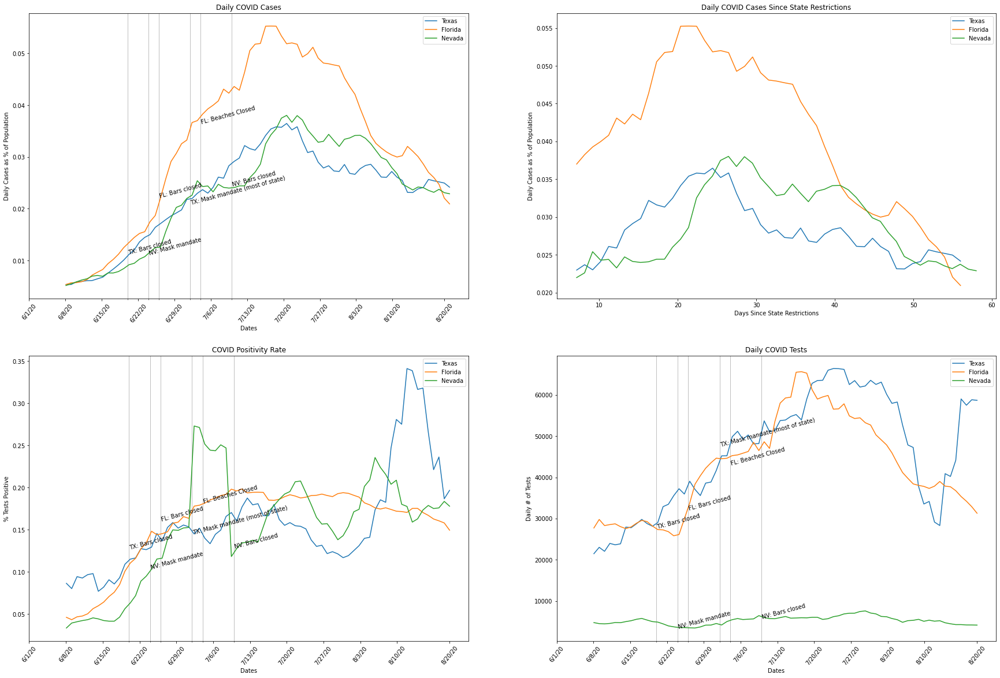

In [ ]:
from matplotlib.ticker import FixedLocator

# Make Graph
fig = plt.figure(figsize = (30, 20))

# Set dates
date_index = 131
t = np.linspace(0, len(states_confirmed.columns[date_index:]), len(states_confirmed.columns[date_index:]))
date_name = '6/1/20'

# Set states
states = ['Texas', 'Florida', 'Nevada']

# Tick labels
tick_loc = [7 * i for i in range(len(t) // 7)]
tick_loc.append(len(t) - 1)
dates = list(states_confirmed.columns[date_index:])
tick_label = [dates[i] for i in tick_loc]

# Daily Cases
ax = fig.add_subplot(221)

annotation_loc = []
counter = 0
state_restriction_dates = list(state_restrictions.keys())
y_max = []

for state in states:
    # Process data
    data = states_confirmed.loc[state, date_name:].rolling(window = 7).sum() / 7
    
    for i in range(len(data)):
        data[i] = data[i] / state_population[state] * 100
    data = data.diff()
    annotation_loc.append(data[dates.index(state_restriction_dates[counter])])
    annotation_loc.append(data[dates.index(state_restriction_dates[counter + 1])])
    # y_max.append(data.index(max(data)))
    ax.plot(t, data, label = state)
    counter += 2

ax.set_xticks(tick_loc)
ax.set_xticklabels(tick_label, rotation = 50)

# Graph Info
ax.set_title('Daily COVID Cases')
ax.set_ylabel('Daily Cases as % of Population')
ax.set_xlabel('Dates')
ax.legend()

# Add annotations
counter = 0
stagger = [1, 0.95, 1, 0.95, 0.95, 1.01]
for i in state_restrictions.keys():
    ax.annotate(state_restrictions[i], (dates.index(i), annotation_loc[counter] * stagger[counter]), rotation = 15)
    counter += 1

# Set minor axis
minor_axis = [dates.index(i) for i in state_restrictions.keys()]
ax.xaxis.set_minor_locator(FixedLocator(minor_axis))
ax.grid(axis = 'x', which = 'minor')

# ax.yaxis.set_minor_locator(FixedLocator(y_max))
# ax.grid(axis = 'y', which = 'minor')

# Days Since First Restrictions
ax = fig.add_subplot(222)
counter = 0
for state in states:
    data = states_confirmed.loc[state, state_restriction_date[counter]:].rolling(window = 7).sum() / 7
    counter += 1
    for i in range(len(data)):
        data[i] = data[i] / state_population[state] * 100
    data = data.diff()

    t_two = np.linspace(0, len(data), len(data))
    ax.plot(t_two, data, label = state)

# Graph Info
ax.set_title('Daily COVID Cases Since State Restrictions')
ax.set_ylabel('Daily Cases as % of Population')
ax.set_xlabel('Days Since State Restrictions')
ax.legend()

# Pos. Rate
ax = fig.add_subplot(223)

annotation_loc = []
counter = 0

for state in states:
    # Process data
    data = hospital_data['positive'].loc[state, date_name:].diff() / hospital_data['total'].loc[state, date_name:].diff()
    data = data.rolling(window = 7).sum() / 7
    annotation_loc.append(data[dates.index(state_restriction_dates[counter])])
    annotation_loc.append(data[dates.index(state_restriction_dates[counter + 1])])    
    ax.plot(t, data, label = state)
    counter += 2

ax.set_xticks(tick_loc)
ax.set_xticklabels(tick_label, rotation = 50)

# Graph Info
ax.set_title('COVID Positivity Rate')
ax.set_ylabel('% Tests Positive')
ax.set_xlabel('Dates')
ax.legend()

# Add annotations
counter = 0
stagger = [1.1, 1, 1.1, 1, 1, 1]
for i in state_restrictions.keys():
    ax.annotate(state_restrictions[i], (dates.index(i), annotation_loc[counter] * stagger[counter]), rotation = 15)
    counter += 1

# Set minor axis
minor_axis = [dates.index(i) for i in state_restrictions.keys()]
ax.xaxis.set_minor_locator(FixedLocator(minor_axis))
ax.grid(axis = 'x', which = 'minor')

# Total Tests
ax = fig.add_subplot(224)

annotation_loc = []
counter = 0

for state in states:
    # Process data
    data = hospital_data['total'].loc[state, date_name:].diff()
    data = data.rolling(window = 7).sum() / 7
    annotation_loc.append(data[dates.index(state_restriction_dates[counter])])
    annotation_loc.append(data[dates.index(state_restriction_dates[counter + 1])])   
    ax.plot(t, data, label = state)
    counter += 2

ax.set_xticks(tick_loc)
ax.set_xticklabels(tick_label, rotation = 50)

# Graph Info
ax.set_title('Daily COVID Tests')
ax.set_ylabel('Daily # of Tests')
ax.set_xlabel('Dates')
ax.legend()

# Add annotations
counter = 0
stagger = [.95, 1.05, 0.95, 0.95, 0.95, 0.95]
for i in state_restrictions.keys():
    ax.annotate(state_restrictions[i], (dates.index(i), annotation_loc[counter] * stagger[counter]), rotation = 15)
    counter += 1

# Set minor axis
minor_axis = [dates.index(i) for i in state_restrictions.keys()]
ax.xaxis.set_minor_locator(FixedLocator(minor_axis))
ax.grid(axis = 'x', which = 'minor')



## Mask Mandates

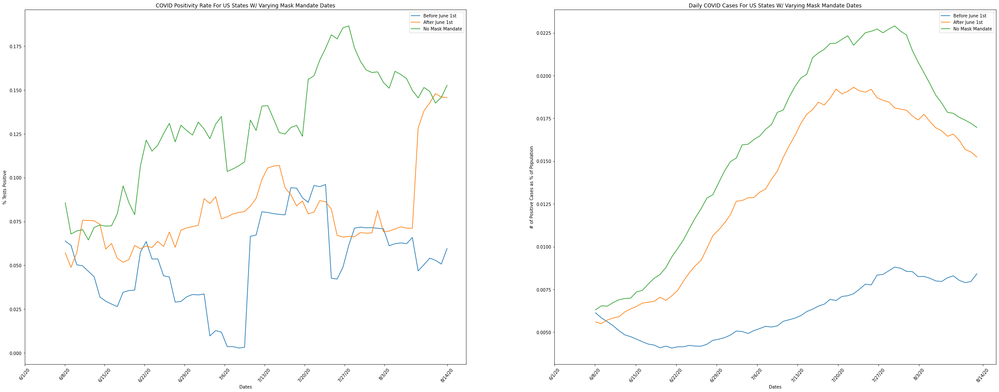

In [ ]:
# Avg. Pos. Rate 

# States
early = ['Connecticut', 'Delaware', 'District of Columbia', 
          'Hawaii', 'Illinois', 'Kentucky', 'Maine', 'Maryland', 
          'Massachusetts',  'New Jersey', 'New Mexico', 'New York', 
          'Pennsylvania', 'Rhode Island', 'Virginia']
      
late = ['Alabama', 'Arkansas', 'California', 'Colorado', 'Indiana',
        'Kansas', 'Louisiana', 'Michigan', 'Minnesota', 'Montana', 
        'Nevada', 'North Carolina', 'Ohio', 'Oregon', 'Texas', 
        'Washington', 'West Virginia', 'Wisconsin']

no = ['Alaska', 'Arizona', 'Florida', 'Georgia', 'Idaho', 'Iowa',
 'Kentucky', 'Mississippi', 'Missouri', 'Nebraska', 'New Hampshire',
 'North Dakota', 'Oklahoma', 'South Carolina', 'South Dakota',
 'Tennessee', 'Utah', 'Vermont', 'Wyoming']


state_masks = [early, late, no]
names = ['Before June 1st', 'After June 1st', 'No Mask Mandate']

# Make Graph
fig = plt.figure(figsize = (40, 15))

# Set dates
date_index = 131
t = np.linspace(0, len(states_confirmed.columns[date_index:]), len(states_confirmed.columns[date_index:]))
date_name = '6/1/20'

# Tick labels
tick_loc = [7 * i for i in range(len(t) // 7)]
tick_loc.append(len(t) - 1)
dates = list(states_confirmed.columns[date_index:])
tick_label = [dates[i] for i in tick_loc]

# Pos. Rate
ax = fig.add_subplot(121)

total_data = []

for j in range(len(state_masks)):
    states = state_masks[j]
    for state in states:
        
        # Process data
        data = hospital_data['positive'].loc[state, date_name:].diff() / hospital_data['total'].loc[state, date_name:].diff()
        data = list((data.rolling(window = 7).sum() / 7).fillna(0))

        if total_data == []:
            total_data.extend(data)
        else:
            total_data = [total_data[i] + data[i] for i in range(len(data))]

    total_data = [total_data[i] / len(states) for i in range(len(total_data))]

    ax.plot(t[7:-1], total_data[7:-1], label = names[j])

ax.set_xticks(tick_loc)
ax.set_xticklabels(tick_label, rotation = 50)

# Graph Info
ax.set_title('COVID Positivity Rate For US States W/ Varying Mask Mandate Dates')
ax.set_ylabel('% Tests Positive')
ax.set_xlabel('Dates')
ax.legend()

# Daily Cases
ax = fig.add_subplot(122)

total_data = []

for j in range(len(state_masks)):
    states = state_masks[j]
    for state in states:
        
        # Process data
        data = hospital_data['positive'].loc[state, date_name:]
        data = list((data.rolling(window = 7).sum() / 7).fillna(0))
        population = state_population[state]
        data = [data[i] * 100 / population for i in range(len(data))]
        data = np.diff(data) 
            
        if total_data == []:
            total_data.extend(data)
        else:
            total_data = [total_data[i] + data[i] for i in range(len(data))]

    total_data = [total_data[i] / len(states) for i in range(len(total_data))]

    ax.plot(t[7:-2], total_data[7:-1], label = names[j])

ax.set_xticks(tick_loc)
ax.set_xticklabels(tick_label, rotation = 50)

# Graph Info
ax.set_title('Daily COVID Cases For US States W/ Varying Mask Mandate Dates')
ax.set_ylabel('# of Positive Cases as % of Population')
ax.set_xlabel('Dates')
ax.legend()




# Test

## Missing Data

### Imputer

In [ ]:
# Set up data
posIncr = hospital_data['positiveIncrease'].fillna(0)
testing = np.array(posIncr.loc['Kansas', '6/1/20':])
testing = np.array(np.array_split(testing, len(testing) // 8))
print(len(testing))
testing

13


array([array([292,   0, 159,   0, 223,   0,   0, 257,   0]),
       array([162,   0, 235,   0,   0, 372,   0, 262,   0]),
       array([378,   0,   0, 406,   0, 505,   0, 568,   0]),
       array([  0, 905,   0, 547,   0, 929,   0,   0, 982]),
       array([   0,  717,    0,  993,    0,    0, 1447,    0]),
       array([ 875,    0, 1032,    0,    0, 1369,    0,  770]),
       array([   0, 1005,    0,    0, 1063,    0,  698,    0]),
       array([ 942,    0,    0, 1064,    0,  841,    0,  921]),
       array([   0,    0, 1092,    0,  817,    0, 1338,    0]),
       array([   0, 1282,    0,  723,    0,  966,    0,    0]),
       array([1545,    0, 1536,    0, 1111,    0,    0, 1564]),
       array([   0, 1328,    0, 1280,    0,    0, 1694,    0]),
       array([ 496,    0,  976,    0,    0, 1513,    0,  971])],
      dtype=object)

In [ ]:
testing = np.array(posIncr.loc['Kansas', '6/1/20':])
testing = np.array(np.array_split(testing, len(testing) // 8))
print(len(testing))
mean = SimpleImputer(missing_values = 0, strategy = 'mean')
mean.fit(testing)
test = mean.fit_transform(testing)
print(len(test))

13


ValueError: ignored

In [ ]:
my_list = posIncr.loc['Kansas', '6/1/20':].values.tolist()
n = 7
final = [my_list[i * n:(i + 1) * n] for i in range((len(my_list) + n - 1) // n )]  
# np.nan_to_num(final, 0)
mean = SimpleImputer(missing_values = 0, strategy = 'mean')
mean.fit([[1, 2, 3,], [4, 5, 6]])
test = mean.fit_transform([[1, 2, 3,], [4, 0, 6]])
test

In [ ]:
from sklearn.impute import SimpleImputer
# Create Imputer
mean = SimpleImputer(missing_values = np.nan, strategy = 'mean')
# Create DataFrame
posIncr = hospital_data['positiveIncrease'].fillna(0)
# for i in hospital_index:
i = 'Kansas'
data = np.reshape(np.array(posIncr.loc[i, :]), (1, len(posIncr.loc[i, :])))
mean.fit(data, y = None)
test = mean.fit_transform(data)
len(test[0])

116

In [ ]:
# Find when data first doesn't equal Nan
data = np.array(posIncr.loc['Kansas', :])
for i in data:
    # print(i)
    if not np.isnan(i):
        print(i)
        print('yeet')
        date = np.where(data == i)
        break
date

1.0
yeet


array([46, 56])

In [ ]:
my_list = posIncr.loc['Kansas', '6/1/20':].values.tolist()
n = 7
final = [my_list[i * n:(i + 1) * n] for i in range((len(my_list) + n - 1) // n )]  
# np.nan_to_num(final, 0)
mean = SimpleImputer(missing_values = 0, strategy = 'mean')
mean.fit([[1, 2, 3,], [4, 5, 6]])
test = mean.fit_transform([[1, 2, 3,], [4, 0, 6]])
test

In [ ]:
mean = SimpleImputer(missing_values = 0, strategy = 'mean')
mean.fit([[1, 2, 3,], [4, 5, 6]])
test = mean.fit_transform([[1, 10, 3,], [4, 0, 6]])
test

array([[ 1., 10.,  3.],
       [ 4., 10.,  6.]])

In [ ]:
testing = np.array(posIncr.loc['Kansas', '6/1/20':])
testing = np.array(np.array_split(testing, len(testing) // 7))
print(len(testing))
mean = SimpleImputer(missing_values = nan, strategy = 'mean')
mean.fit(testing)
test = mean.fit_transform(testing)
print(len(test))

15


ValueError: ignored

In [ ]:
length = len(testing) * len(testing[0])
plt.plot(np.linspace(0, length, length), testing.flatten())
testing.flatten().sum()

In [ ]:
test = np.asarray(final)
test.T
mean = SimpleImputer(missing_values = 0, strategy = 'mean')
testing = mean.fit_transform(test.T).T

In [ ]:
# Find zeroes in posIncr and average them and fix for pos
for i in hospital_index:
    values = np.array(hospital_data['positiveIncrease'].loc[i, :])
    index = np.where(values <= 0)
    print(i, index)

Alabama (array([45, 46, 47, 48, 49, 50]),)
Alaska (array([ 44,  45,  46,  47,  48,  49,  50,  52,  53,  54,  57,  61,  94,
        99, 112, 118, 120, 123, 130, 166]),)
Arizona (array([42, 43, 46, 47, 50, 51, 53]),)
Arkansas (array([ 44,  45,  46,  47,  48,  49,  55, 109, 112, 122, 128, 132, 134,
       143, 151, 156, 165, 168, 171, 178, 185, 193, 199, 206, 228]),)
California (array([42, 43, 51]),)
Colorado (array([ 43,  44,  46,  54,  69,  80, 111]),)
Connecticut (array([ 45,  47,  51,  59,  66,  77,  87,  96, 101, 103, 126, 164, 165,
       171, 172, 178, 179, 185, 186, 192, 193, 199, 200, 206, 207, 209,
       213, 214, 220, 221, 227, 228, 229, 234, 235]),)
Delaware (array([ 44,  45,  46,  47,  48,  51,  53,  75,  77,  81,  87, 180, 185,
       203, 218, 221, 231, 233]),)
District of Columbia (array([ 43,  44,  45,  47,  49,  51,  52, 123]),)
Florida (array([ 42,  44, 114]),)
Georgia (array([42, 43, 44]),)
Hawaii (array([ 45,  46,  48,  49,  50,  51,  52,  53, 103, 108, 114, 118, 122

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in less_equal
  after removing the cwd from sys.path.


### Interpolation

In [ ]:
# Import the required libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
# Import a scoring metric to compare methods
from sklearn.metrics import r2_score
%matplotlib inline
# the data path
#To View the data go here: 
#https://github.com/drnesr/WaterConsumption/blob/master/data/SampleData.csv"
# To load the raw data:
remote_path = "https://raw.githubusercontent.com/drnesr/WaterConsumption/master/data/SampleData.csv"

df=pd.read_csv(remote_path)
df.head()

,Date,reference,target
0,15-01-2010,12.0,12.0
1,15-02-2010,18.0,18.0
2,15-03-2010,22.0,22.0
3,15-04-2010,26.0,26.0
4,15-05-2010,31.0,NaN


In [ ]:
# Converting the column to DateTime format
df.Date = pd.to_datetime(df.Date, format='%d-%m-%Y')
df = df.set_index('Date')
df.head()

,reference,target
Date,,
2010-01-15,12.0,12.0
2010-02-15,18.0,18.0
2010-03-15,22.0,22.0
2010-04-15,26.0,26.0
2010-05-15,31.0,NaN


In [ ]:
df = df.assign(missing= np.nan)
df.missing[df.target.isna()] = df.reference
df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 96 entries, 2010-01-15 to 2017-12-15
Data columns (total 3 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   reference  96 non-null     float64
 1   target     75 non-null     float64
 2   missing    21 non-null     float64
dtypes: float64(3)
memory usage: 3.0 KB


In [ ]:
# Filling using mean or median
# Creating a column in the dataframe
# instead of : df['NewCol']=0, we use
# df = df.assign(NewCol=default_value)
# to avoid pandas warning.
df = df.assign(FillMean=df.target.fillna(df.target.mean()))
df = df.assign(FillMedian=df.target.fillna(df.target.median()))

In [ ]:
print(df['FillMean'].head(20))

Date
2010-01-15    12.000000
2010-02-15    18.000000
2010-03-15    22.000000
2010-04-15    26.000000
2010-05-15    25.887473
2010-06-15    25.887473
2010-07-15    45.000000
2010-08-15    43.000000
2010-09-15    25.887473
2010-10-15    29.000000
2010-11-15    25.887473
2010-12-15    17.000000
2011-01-15    13.306754
2011-02-15    18.531384
2011-03-15    21.671861
2011-04-15    23.787254
2011-05-15    30.911899
2011-06-15    37.159990
2011-07-15    25.887473
2011-08-15    44.304235
Name: FillMean, dtype: float64


In [ ]:
print(df['target'].head(20))

Date
2010-01-15    12.000000
2010-02-15    18.000000
2010-03-15    22.000000
2010-04-15    26.000000
2010-05-15          NaN
2010-06-15          NaN
2010-07-15    45.000000
2010-08-15    43.000000
2010-09-15          NaN
2010-10-15    29.000000
2010-11-15          NaN
2010-12-15    17.000000
2011-01-15    13.306754
2011-02-15    18.531384
2011-03-15    21.671861
2011-04-15    23.787254
2011-05-15    30.911899
2011-06-15    37.159990
2011-07-15          NaN
2011-08-15    44.304235
Name: target, dtype: float64


In [ ]:
df

,reference,target,missing,FillMean,FillMedian,RollingMean,RollingMedian
Date,,,,,,,
2010-01-15,12.000000,12.000000,NaN,12.000000,12.000000,12.000000,12.000000
2010-02-15,18.000000,18.000000,NaN,18.000000,18.000000,18.000000,18.000000
2010-03-15,22.000000,22.000000,NaN,22.000000,22.000000,22.000000,22.000000
2010-04-15,26.000000,26.000000,NaN,26.000000,26.000000,26.000000,26.000000
2010-05-15,31.000000,NaN,31.0,25.887473,23.787254,19.500000,20.000000
...,...,...,...,...,...,...,...
2017-08-15,44.550281,44.550281,NaN,44.550281,44.550281,44.550281,44.550281
2017-09-15,31.099088,31.099088,NaN,31.099088,31.099088,31.099088,31.099088
2017-10-15,26.803926,26.803926,NaN,26.803926,26.803926,26.803926,26.803926


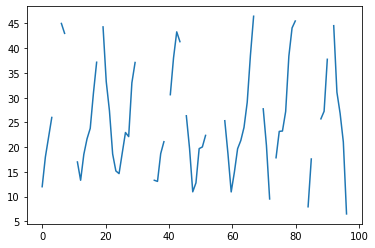

In [ ]:
df
t = np.linspace(0, len(df.index), len(df.index))
# plt.plot(t, df['FillMean'])
# plt.plot(t, df['reference'])
plt.plot(t, df['target'])

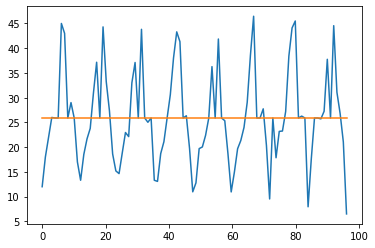

In [ ]:
plt.plot(t, df['FillMean'])
plt.plot(t, [df.target.mean() for i in range(len(t))])

In [ ]:
# imputing using the rolling average
df = df.assign(RollingMean=df.target.fillna(df.target.rolling(24,min_periods=1,).mean()))
# imputing using the rolling median
df = df.assign(RollingMedian=df.target.fillna(df.target.rolling(24,min_periods=1,).median()))# imputing using the median

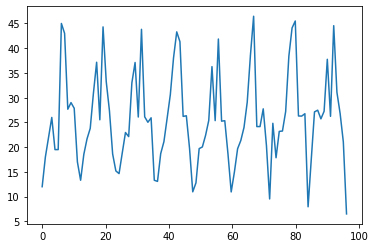

In [ ]:
plt.plot(t, df['RollingMean'])

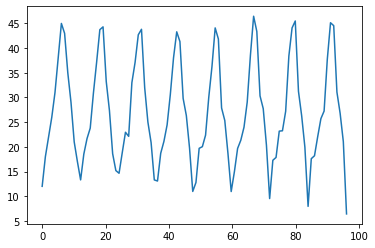

In [ ]:
plt.plot(t, df['reference'])

In [ ]:
plt.plot(t, df['reference'])

### Average

In [ ]:
hospital_data['positiveIncrease']

,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,2/25/20,2/26/20,2/27/20,2/28/20,2/29/20,3/1/20,...,8/12/20,8/13/20,8/14/20,8/15/20,8/16/20,8/17/20,8/18/20,8/19/20,8/20/20,8/21/20,8/22/20,8/23/20,8/24/20,8/25/20,8/26/20,8/27/20,8/28/20,8/29/20,8/30/20,8/31/20,9/1/20,9/2/20,9/3/20,9/4/20,9/5/20,9/6/20,9/7/20,9/8/20,9/9/20,9/10/20,9/11/20,9/12/20,9/13/20,9/14/20,9/15/20,9/16/20,9/17/20,9/18/20,9/19/20,9/20/20
Alabama,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,935,771,752,1271,853,571,1357,1117,971,321,1762,528,1650,532,2012,1769,1162,1704,1346,823,1558,623,1046,1108,1410,511,659,633,811,1148,1138,943,1109,704,701,927,670,1106,1301,798.0
Alaska,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,66,95,119,85,106,50,67,70,85,71,91,64,70,38,53,82,122,112,51,39,35,73,106,130,98,89,34,34,66,125,109,107,62,77,43,52,106,116,87,93.0
Arizona,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,706,1351,927,933,883,468,915,637,723,619,996,208,311,859,186,680,519,629,374,174,507,519,1092,728,835,250,198,81,496,461,521,605,384,213,484,698,1753,1282,609,467.0
Arkansas,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,703,652,626,-400,673,412,410,729,549,887,547,375,320,480,649,722,838,795,478,368,273,615,1392,1174,548,0,1054,477,498,548,1180,727,509,408,730,862,992,871,0,1641.0
California,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,11645,7085,7934,12614,7873,6469,4636,6164,5920,5585,6556,6777,4946,4480,6004,4430,5329,4981,6070,4176,3712,4255,5125,5106,4956,4905,3091,2676,1616,3338,3326,4107,4625,2855,2235,2950,3238,3630,4304,4265.0
Colorado,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,402,315,463,319,300,338,194,261,270,329,356,297,260,198,459,193,350,430,268,182,201,351,244,268,368,334,285,213,187,246,265,307,415,417,375,400,587,459,605,606.0
Connecticut,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,22,76,115,0,0,370,-12,59,118,87,0,0,492,29,180,130,145,0,0,384,127,102,101,156,0,0,0,417,89,222,233,0,0,569,136,135,220,141,0,0.0
Delaware,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0,268,373,56,55,85,57,50,75,52,58,67,47,20,24,-10,107,266,-6,86,106,14,104,99,140,151,206,59,0,158,0,260,123,88,200,97,84,48,83,117.0
District of Columbia,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,63,65,94,41,61,53,52,29,55,60,65,56,49,45,38,72,57,74,34,33,57,28,58,51,52,41,36,47,25,25,81,59,40,30,65,56,47,62,50,53.0
Florida,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,8109,6236,6148,6352,3779,2678,3838,4115,4555,4684,4311,2974,2258,2673,3220,3269,3815,3197,2583,1885,7569,2402,3571,3198,3656,2564,1838,1823,2056,2583,3650,3190,2423,1736,3116,2355,3255,3204,3573,2521.0


In [ ]:
import copy  as c
copy_df = c.deepcopy(hospital_data)
posIncr = copy['positiveIncrease'].copy(deep=True)

In [ ]:
state_cutoff

{'Alabama': '3/13/20',
 'Alaska': '3/13/20',
 'Arizona': '3/6/20',
 'Arkansas': '3/12/20',
 'California': '3/6/20',
 'Colorado': '3/7/20',
 'Connecticut': '3/8/20',
 'Delaware': '3/11/20',
 'District of Columbia': '3/8/20',
 'Florida': '3/5/20',
 'Georgia': '3/7/20',
 'Hawaii': '3/9/20',
 'Idaho': '3/14/20',
 'Illinois': '3/5/20',
 'Indiana': '3/8/20',
 'Iowa': '3/9/20',
 'Kansas': '3/8/20',
 'Kentucky': '3/7/20',
 'Louisiana': '3/9/20',
 'Maine': '3/12/20',
 'Maryland': '3/6/20',
 'Massachusetts': '3/12/20',
 'Michigan': '3/2/20',
 'Minnesota': '3/7/20',
 'Mississippi': '3/12/20',
 'Missouri': '3/8/20',
 'Montana': '3/12/20',
 'Nebraska': '3/7/20',
 'Nevada': '3/6/20',
 'New Hampshire': '3/8/20',
 'New Jersey': '3/5/20',
 'New Mexico': '3/11/20',
 'New York': '3/5/20',
 'North Carolina': '3/6/20',
 'North Dakota': '3/12/20',
 'Ohio': '3/9/20',
 'Oklahoma': '3/10/20',
 'Oregon': '3/7/20',
 'Pennsylvania': '3/7/20',
 'Puerto Rico': '3/20/20',
 'Rhode Island': '3/5/20',
 'South Carolina'

In [ ]:
test = int(round(100.6, 0))
test

101

In [ ]:
posIncr.columns[-1]

'9/20/20'

In [ ]:
dates = posIncr.columns
# Create averaging code
def average_posIncr(posIncr, state, date_index, zero_len):
    if dates[date_index] == posIncr.columns[-1]:
        return posIncr
    elif posIncr.loc[state, dates[date_index]] == 0:
        return average_posIncr(posIncr, state, date_index + 1, zero_len + 1)
    else:
        if zero_len == 0:
            return average_posIncr(posIncr, state, date_index + 1, 0)
        else:
            print(dates[date_index], 'STOP')
            print('Value:', posIncr.loc[state, dates[date_index]])
            average = posIncr.loc[state, dates[date_index]] / (zero_len + 1)
            average = int(round(average, 0))
            for i in range(zero_len + 1):
                posIncr.loc[state, dates[date_index -  i]] = average
                print(dates[date_index - i], 'date')
            # print(posIncr.loc[state, dates[date_index - zero_len]: dates[date_index]])
            return average_posIncr(posIncr, state, date_index + 1, 0)     

for state in states:
    posIncr = average_posIncr(posIncr, state, 0, 0)


3/13/20 STOP
Value: 1
3/13/20 date
3/12/20 date
3/11/20 date
3/10/20 date
3/9/20 date
3/8/20 date
3/7/20 date
3/13/20 STOP
Value: 1
3/13/20 date
3/12/20 date
3/11/20 date
3/10/20 date
3/9/20 date
3/8/20 date
3/7/20 date
3/6/20 date
3/17/20 STOP
Value: 2
3/17/20 date
3/16/20 date
3/15/20 date
3/14/20 date
3/20/20 STOP
Value: 6
3/20/20 date
3/19/20 date
3/24/20 STOP
Value: 14
3/24/20 date
3/23/20 date
4/26/20 STOP
Value: 2
4/26/20 date
4/25/20 date
5/1/20 STOP
Value: 9
5/1/20 date
4/30/20 date
5/14/20 STOP
Value: 4
5/14/20 date
5/13/20 date
5/20/20 STOP
Value: 3
5/20/20 date
5/19/20 date
5/22/20 STOP
Value: 2
5/22/20 date
5/21/20 date
5/25/20 STOP
Value: 1
5/25/20 date
5/24/20 date
6/1/20 STOP
Value: 33
6/1/20 date
5/31/20 date
7/7/20 STOP
Value: 46
7/7/20 date
7/6/20 date
3/6/20 STOP
Value: 1
3/6/20 date
3/5/20 date
3/4/20 date
3/10/20 STOP
Value: 1
3/10/20 date
3/9/20 date
3/8/20 date
3/14/20 STOP
Value: 3
3/14/20 date
3/13/20 date
3/12/20 date
3/16/20 STOP
Value: 6
3/16/20 date
3/15/2

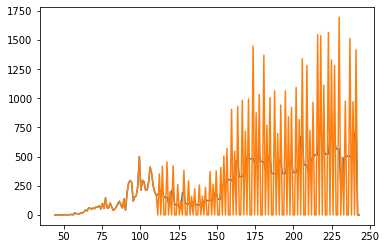

In [ ]:
time = np.linspace(0, len(posIncr.columns), len(posIncr.columns))
plt.plot(time, posIncr.loc['Kansas', :])
plt.plot(time, hospital_data['positiveIncrease'].loc['Kansas', :])

In [ ]:
posIncr

,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,2/25/20,2/26/20,2/27/20,2/28/20,2/29/20,3/1/20,...,8/12/20,8/13/20,8/14/20,8/15/20,8/16/20,8/17/20,8/18/20,8/19/20,8/20/20,8/21/20,8/22/20,8/23/20,8/24/20,8/25/20,8/26/20,8/27/20,8/28/20,8/29/20,8/30/20,8/31/20,9/1/20,9/2/20,9/3/20,9/4/20,9/5/20,9/6/20,9/7/20,9/8/20,9/9/20,9/10/20,9/11/20,9/12/20,9/13/20,9/14/20,9/15/20,9/16/20,9/17/20,9/18/20,9/19/20,9/20/20
Alabama,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,935,771,752,1271,853,571,1357,1117,971,321,1762,528,1650,532,2012,1769,1162,1704,1346,823,1558,623,1046,1108,1410,511,659,633,811,1148,1138,943,1109,704,701,927,670,1106,1301,798.0
Alaska,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,66,95,119,85,106,50,67,70,85,71,91,64,70,38,53,82,122,112,51,39,35,73,106,130,98,89,34,34,66,125,109,107,62,77,43,52,106,116,87,93.0
Arizona,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,706,1351,927,933,883,468,915,637,723,619,996,208,311,859,186,680,519,629,374,174,507,519,1092,728,835,250,198,81,496,461,521,605,384,213,484,698,1753,1282,609,467.0
Arkansas,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,703,652,626,-400,673,412,410,729,549,887,547,375,320,480,649,722,838,795,478,368,273,615,1392,1174,548,527,527,477,498,548,1180,727,509,408,730,862,992,871,0,1641.0
California,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,11645,7085,7934,12614,7873,6469,4636,6164,5920,5585,6556,6777,4946,4480,6004,4430,5329,4981,6070,4176,3712,4255,5125,5106,4956,4905,3091,2676,1616,3338,3326,4107,4625,2855,2235,2950,3238,3630,4304,4265.0
Colorado,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,402,315,463,319,300,338,194,261,270,329,356,297,260,198,459,193,350,430,268,182,201,351,244,268,368,334,285,213,187,246,265,307,415,417,375,400,587,459,605,606.0
Connecticut,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,22,76,115,123,123,123,-12,59,118,87,164,164,164,29,180,130,145,128,128,128,127,102,101,156,104,104,104,104,89,222,233,190,190,190,136,135,220,141,0,0.0
Delaware,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,134,134,373,56,55,85,57,50,75,52,58,67,47,20,24,-10,107,266,-6,86,106,14,104,99,140,151,206,59,79,79,130,130,123,88,200,97,84,48,83,117.0
District of Columbia,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,63,65,94,41,61,53,52,29,55,60,65,56,49,45,38,72,57,74,34,33,57,28,58,51,52,41,36,47,25,25,81,59,40,30,65,56,47,62,50,53.0
Florida,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,8109,6236,6148,6352,3779,2678,3838,4115,4555,4684,4311,2974,2258,2673,3220,3269,3815,3197,2583,1885,7569,2402,3571,3198,3656,2564,1838,1823,2056,2583,3650,3190,2423,1736,3116,2355,3255,3204,3573,2521.0


In [ ]:
def cutoff_code(df, dates, state):
    for i in dates:
        if df.loc[state, i] > 0:
            return i
    return dates[0]

states = hospital_data['positiveIncrease'].index
posIncr = hospital_data['positiveIncrease']
cutoff = [cutoff_code(posIncr, posIncr.columns, state) for state in states]
state_cutoff = {states[i]: cutoff[i] for i in range(len(cutoff))}

dates = posIncr.columns
# Create averaging code
def average_posIncr(posIncr, state, date_index, zero_len):
    if dates[date_index] == posIncr.columns[-1]:
        return posIncr
    elif posIncr.loc[state, dates[date_index]] == 0:
        return average_posIncr(posIncr, state, date_index + 1, zero_len + 1)
    else:
        if zero_len == 0:
            return average_posIncr(posIncr, state, date_index + 1, 0)
        else:
            print(dates[date_index], 'STOP')
            print('Value:', posIncr.loc[state, dates[date_index]])
            average = posIncr.loc[state, dates[date_index]] / (zero_len + 1)
            average = int(round(average, 0))
            for i in range(zero_len + 1):
                posIncr.loc[state, dates[date_index -  i]] = average
                print(dates[date_index - i], 'date')
            # print(posIncr.loc[state, dates[date_index - zero_len]: dates[date_index]])
            return average_posIncr(posIncr, state, date_index + 1, 0)     

for state in states:
    posIncr = average_posIncr(posIncr, state, 0, 0)

for state in states:
    print(state, 'diff:', abs(posIncr.loc[state, :].sum() - hospital_data['positiveIncrease'].loc[state, :].sum()))

Alabama diff: 1.0
Alaska diff: 5.0
Arizona diff: 2.0
Arkansas diff: 4.0
California diff: 1.0
Colorado diff: 0.0
Connecticut diff: 6.0
Delaware diff: 3.0
District of Columbia diff: 1.0
Florida diff: 1.0
Georgia diff: 0.0
Hawaii diff: 2.0
Idaho diff: 3.0
Illinois diff: 3.0
Indiana diff: 0.0
Iowa diff: 1.0
Kansas diff: 3.0
Kentucky diff: 2.0
Louisiana diff: 2.0
Maine diff: 0.0
Maryland diff: 2.0
Massachusetts diff: 8.0
Michigan diff: 3.0
Minnesota diff: 0.0
Mississippi diff: 1.0
Missouri diff: 5.0
Montana diff: 4.0
Nebraska diff: 1.0
Nevada diff: 1.0
New Hampshire diff: 3.0
New Jersey diff: 0.0
New Mexico diff: 1.0
New York diff: 1.0
North Carolina diff: 3.0
North Dakota diff: 0.0
Ohio diff: 2.0
Oklahoma diff: 3.0
Oregon diff: 1.0
Pennsylvania diff: 0.0
Puerto Rico diff: 0.0
Rhode Island diff: 2.0
South Carolina diff: 1.0
South Dakota diff: 0.0
Tennessee diff: 3.0
Texas diff: 2.0
Utah diff: 1.0
Vermont diff: 1.0
Virginia diff: 1.0
Washington diff: 17.0
West Virginia diff: 1.0
Wisconsin di

## School Trends

[Text(0, 0, '8/1/20'),
 Text(0, 0, '8/8/20'),
 Text(0, 0, '8/15/20'),
 Text(0, 0, '8/22/20'),
 Text(0, 0, '8/29/20'),
 Text(0, 0, '9/5/20'),
 Text(0, 0, '9/12/20'),
 Text(0, 0, '9/19/20'),
 Text(0, 0, '9/26/20')]

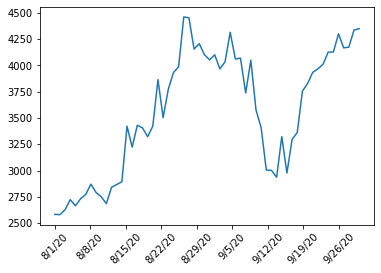

In [ ]:
fig, ax = plt.subplots()
data = states_confirmed.loc['Kansas', :].diff().rolling(window = 7).sum()
data = data['8/1/20':]
t = np.linspace(0, len(data), len(data))
ax.plot(t, data)

dates = data.index

labels = [7 * i for i in range(len(dates) // 7 + 1)]

ax.set_xticks(labels)
ax.set_xticklabels([dates[i] for i in labels], rotation = 45)


ValueError: ignored

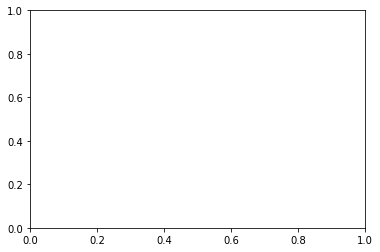

In [ ]:
plt.plot(t[:-1], posIncr.loc['Kansas', '8/1/20':'9/18/20'].rolling(window = 7).sum() / 7)


In [ ]:
raw_kansas = raw_us_confirmed[raw_us_confirmed['Province_State'] == 'Kansas']
kansas = raw_kansas.copy(deep = True)
# print(raw_kansas['9/19/20'].sum())
# raw_kansas['9/19/20'].sum() - raw_kansas['9/19/20'].sort_values(ascending = False).head(30).sum()

In [ ]:
kansas.loc[:, '1/22/20'] = kansas.loc[:, '1/22/20'].rolling(window = 7).sum()

In [ ]:
kansas_diff = kansas.copy(deep = True)
kansas_diff.loc[:, '1/22/20'] = kansas_diff.loc[:, '1/22/20'].diff()

In [ ]:
ks_index = list(map(int, raw_kansas['9/19/20'].sort_values(ascending=False).index))
type(ks_index[0])

int

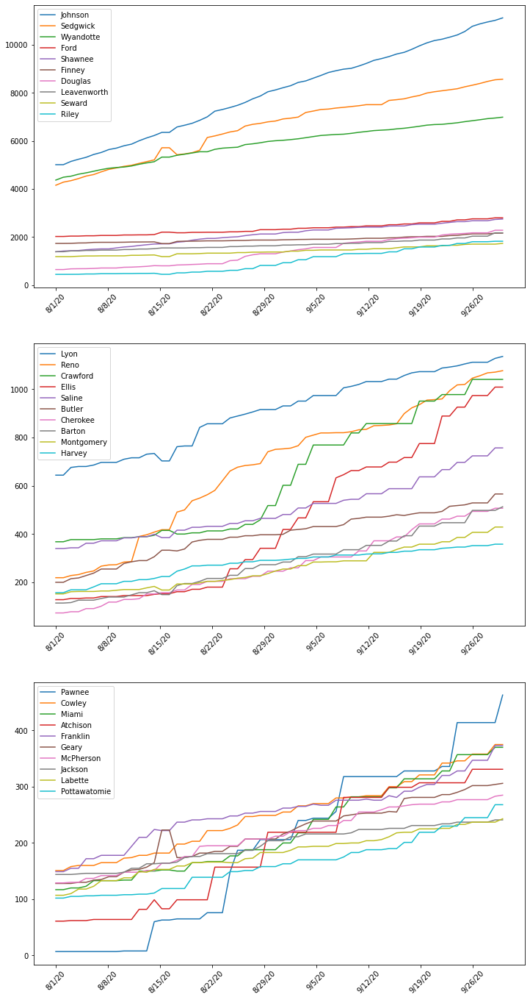

In [ ]:
# Graph top 30 counties
fig, axes = plt.subplots(3, 1, figsize = (12, 24))
dates = raw_kansas.columns[list(raw_kansas.columns).index('8/1/20'):]
t = np.linspace(0, len(dates), len(dates))
counter = 0
for ax in axes:
    labels = [7 * i for i in range(len(dates) // 7 + 1)]
    ax.set_xticks(labels)
    ax.set_xticklabels([dates[i] for i in labels], rotation = 45)
    for i in range(10):
        ax.plot(t, raw_kansas.loc[ks_index[i + counter],'8/1/20':], label = raw_kansas.loc[ks_index[i + counter], 'Admin2'])
    counter += 10
    ax.legend()
    



In [ ]:
ks_index

[969,
 1011,
 1030,
 952,
 1013,
 951,
 946,
 975,
 1012,
 1005,
 979,
 1002,
 942,
 949,
 1009,
 931,
 934,
 928,
 986,
 963,
 997,
 941,
 984,
 926,
 953,
 954,
 982,
 966,
 973,
 999,
 957,
 967,
 1020,
 990,
 929,
 958,
 1019,
 1021,
 962,
 944,
 939,
 945,
 964,
 1010,
 983,
 930,
 993,
 998,
 932,
 970,
 1008,
 989,
 980,
 971,
 977,
 1024,
 1004,
 991,
 938,
 1000,
 1028,
 925,
 1006,
 1017,
 995,
 1018,
 936,
 960,
 937,
 1022,
 947,
 985,
 961,
 1003,
 1007,
 924,
 956,
 992,
 987,
 950,
 955,
 1015,
 935,
 965,
 981,
 972,
 1025,
 1026,
 943,
 968,
 988,
 1029,
 933,
 974,
 1014,
 976,
 940,
 978,
 959,
 927,
 1027,
 994,
 1016,
 1001,
 948,
 1023,
 996]

# Johnson County

In [ ]:
kansas_diff.loc[969, :'1/22/20']

UID                          84020091
iso2                               US
iso3                              USA
code3                             840
FIPS                            20091
Admin2                        Johnson
Province_State                 Kansas
Country_Region                     US
Lat                           38.8855
Long_                        -94.8225
Combined_Key      Johnson, Kansas, US
1/22/20                             0
Name: 969, dtype: object

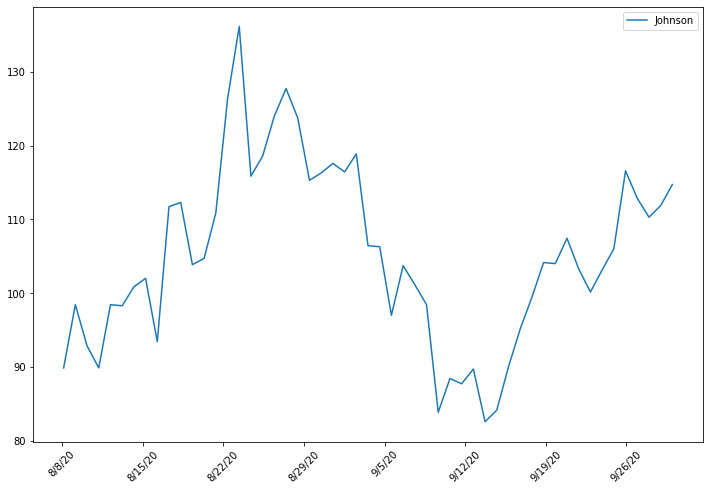

In [ ]:
# Graph top 30 counties
fig, ax = plt.subplots(1, 1, figsize = (12, 8))
dates = raw_kansas.columns[list(raw_kansas.columns).index('8/1/20'):]
t = np.linspace(0, len(dates), len(dates))

labels = [7 * i for i in range(len(dates) // 7 + 1)]
ax.set_xticks(labels)
ax.set_xticklabels([dates[i] for i in labels], rotation = 45)
ax.plot(t, kansas_diff.loc[969,'8/1/20':].diff().rolling(window = 7).sum() / 7, label = kansas_diff.loc[969, 'Admin2'])
counter += 10
ax.legend()



In [ ]:
raw_hospital_kansas = raw_state_hospital_data[raw_state_hospital_data['state'] == 'KS']
raw_hospital_kansas

,date,state,positive,negative,pending,totalTestResults,hospitalizedCurrently,hospitalizedCumulative,inIcuCurrently,inIcuCumulative,onVentilatorCurrently,onVentilatorCumulative,recovered,dataQualityGrade,lastUpdateEt,dateModified,checkTimeEt,death,hospitalized,dateChecked,totalTestsViral,positiveTestsViral,negativeTestsViral,positiveCasesViral,deathConfirmed,deathProbable,totalTestEncountersViral,totalTestsPeopleViral,totalTestsAntibody,positiveTestsAntibody,negativeTestsAntibody,totalTestsPeopleAntibody,positiveTestsPeopleAntibody,negativeTestsPeopleAntibody,totalTestsPeopleAntigen,positiveTestsPeopleAntigen,totalTestsAntigen,positiveTestsAntigen,fips,positiveIncrease,negativeIncrease,total,totalTestResultsSource,totalTestResultsIncrease,posNeg,deathIncrease,hospitalizedIncrease,hash,commercialScore,negativeRegularScore,negativeScore,positiveScore,score,grade
18,20200930,KS,59749.0,461701.0,NaN,521450.0,352.0,2917.0,103.0,801.0,33.0,255.0,2095.0,A+,9/30/2020 10:00,2020-09-30T10:00:00Z,09/30 06:00,678.0,2917.0,2020-09-30T10:00:00Z,NaN,NaN,NaN,NaN,NaN,NaN,NaN,521450.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,20,1120,6421,521450,posNeg,7541,521450,41,65,d5ca87f356444deefae761fabc701c2638bf4e3f,0,0,0,0,0,NaN
74,20200929,KS,58629.0,455280.0,NaN,513909.0,270.0,2852.0,88.0,785.0,29.0,251.0,2051.0,A+,9/28/2020 10:00,2020-09-28T10:00:00Z,09/28 06:00,637.0,2852.0,2020-09-28T10:00:00Z,NaN,NaN,NaN,NaN,NaN,NaN,NaN,513909.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,20,0,0,513909,posNeg,0,513909,0,0,731e8c531ba60a395116be4739463d6fe9e090cc,0,0,0,0,0,NaN
130,20200928,KS,58629.0,455280.0,NaN,513909.0,270.0,2852.0,88.0,785.0,29.0,251.0,2051.0,A+,9/28/2020 10:00,2020-09-28T10:00:00Z,09/28 06:00,637.0,2852.0,2020-09-28T10:00:00Z,NaN,NaN,NaN,NaN,NaN,NaN,NaN,513909.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,20,2037,9102,513909,posNeg,11139,513909,5,36,59e5ae7439200f608dd37b82896789c1688af1fd,0,0,0,0,0,NaN
186,20200927,KS,56592.0,446178.0,NaN,502770.0,343.0,2816.0,121.0,768.0,34.0,250.0,2039.0,A+,9/25/2020 10:00,2020-09-25T10:00:00Z,09/25 06:00,632.0,2816.0,2020-09-25T10:00:00Z,NaN,NaN,NaN,NaN,NaN,NaN,NaN,502770.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,20,0,0,502770,posNeg,0,502770,0,0,2c2ada7c9775cef610bd7c5f37095ea278fafcb3,0,0,0,0,0,NaN
242,20200926,KS,56592.0,446178.0,NaN,502770.0,343.0,2816.0,121.0,768.0,34.0,250.0,2039.0,A+,9/25/2020 10:00,2020-09-25T10:00:00Z,09/25 06:00,632.0,2816.0,2020-09-25T10:00:00Z,NaN,NaN,NaN,NaN,NaN,NaN,NaN,502770.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,20,0,0,502770,posNeg,0,502770,0,0,1468f023cf5cebe6e0d2f0752a5b054eecc06b87,0,0,0,0,0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11415,20200310,KS,1.0,17.0,21.0,18.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,20,0,6,39,posNeg,6,18,0,0,5f972b165e1b08fd38dd632823531fcfcb7da3c7,0,0,0,0,0,NaN
11466,20200309,KS,1.0,11.0,0.0,12.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,20,0,0,12,posNeg,0,12,0,0,3b07a260694a45339350ad295d3aadae35006680,0,0,0,0,0,NaN
11517,20200308,KS,1.0,11.0,0.0,12.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,20,1,0,12,posNeg,1,12,0,0,ab077c8d3b451599a6758b3239cc6bc6afd80293,0,0,0,0,0,NaN
11568,20200307,KS,0.0,11.0,2.0,11.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,20,0,7,13,posNeg,7,11,0,0,7b7870da1d7e3457f5a27237304f6b5f01012fbc,0,0,0,0,0,NaN
